# Anciallry services data analysis 

- Author: Yassin Alnuaimee
-  Date: 24/09/2024

---
# Table of Contents
- [1. Library imports](#-Library-imports)
- [2. Data 2015](#Data-2015)
    - [2.1. Primary control auction 2015](##Primary-control-auction-2015)
    - [2.2. Secondary control auction 2015](##Secondary-control-auction-2015)
    - [2.3. Tertiary control auction 2015](##Tertiary-control-auction-2015)
- [3. Data 2016](#Data-2016)
    - [3.1. Primary control auction 2016](##Primary-control-auction-2016)
    - [3.2. Secondary control auction 2016](##Secondary-control-auction-2016)
    - [3.3. Tertiary control auction 2016](##Tertiary-control-auction-2016)
- [4. Data 2017](#Data-2017)
    - [4.1. Primary control auction 2017](##Primary-control-auction-2017)
    - [4.2. Secondary control auction 2017](##Secondary-control-auction-2017)
    - [4.3. Tertiary control auction 2017](##Tertiary-control-auction-2017)
- [5. Data 2018](#Data-2018)
    - [5.1. Primary control auction 2018](##Primary-control-auction-2018)
    - [5.2. Secondary control auction 2018](##Secondary-control-auction-2018)
    - [5.3. Tertiary control auction  auction 2018](##Tertiary-control-auction-2018)
- [6. Data 2019](#Data-2019)
    - [6.1. Primary control auction 2019](##Primary-control-auction-2019)
    - [6.2. Secondary control auction 2019](##Secondary-control-auction-2019)
    - [6.3. Tertiary control auction 2019](##Tertiary-control-auction-2019)
- [7. Data 2020](#Data-2020)
    - [7.1. Primary control auction 2020](##Primary-control-auction-2020)
    - [7.2. Secondary control auction 2020](##Secondary-control-auction-2020)
    - [7.3. Tertiary control auction 2020](##Tertiary-control-auction-2020)
- [8. Data 2021](#Data-2021)
    - [8.1. Primary control auction 2021](##Primary-control-auction-2021)
    - [8.2. Secondary control auction 2021](##Secondary-control-auction-2021)
    - [8.3. Tertiary control auction 2021](##Tertiary-control-auction-2021)
- [9. Data 2022](#Data-2022)
    - [9.1. Primary control auction 2022](##Primary-control-auction-2022)
    - [9.2. Secondary control auction 2022](##Secondary-control-auction-2022)
    - [9.3. Tertiary control auction control auction 2022](##Tertiary-control-auction-2022)
- [10. Data 2023](#Data-2023)
    - [10.1. Primary control auction 2023](##Primary-control-auction-2023)
    - [10.2. Secondary control auction 2023](##Secondary-control-auction-2023)
    - [10.3. Tertiary control auction 2023](##Tertiary-control-auction-2023)
- [11. Data 2024](#Data-2024)
    - [11.1. Primary control auction 2024](##Primary-control-auction-2024)
    - [11.2. Secondary control auction 2024](##Secondary-control-auction-2024)
    - [11.3. Tertiary control auction 2024](##Tertiary-control-auction-2024)
- [12. Grouped analysis](#Grouped-analysis)
---

# Library imports


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#set data path
DATA='./data/'

---

# Data 2015

In [16]:
res15=pd.read_csv(DATA+'2015_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5'])

print(res15.Description.unique())
res15

['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5
0,PRL_15_KW01,Primary control Auction,20,MW,20,MW,6395.00,EUR/MW,127900.00,EUR,38.07,EUR/MWh*
1,PRL_15_KW01,Primary control Auction,20,MW,20,MW,4896.00,EUR/MW,97920.00,EUR,29.14,EUR/MWh*
2,PRL_15_KW01,Primary control Auction,6,MW,6,MW,7682.64,EUR/MW,46095.84,EUR,45.73,EUR/MWh*
3,PRL_15_KW02,Primary control Auction,24,MW,24,MW,3535.00,EUR/MW,84840.00,EUR,21.04,EUR/MWh*
4,PRL_15_KW02,Primary control Auction,23,MW,1,MW,4348.00,EUR/MW,4348.00,EUR,25.88,EUR/MWh*
...,...,...,...,...,...,...,...,...,...,...,...,...
26552,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,15,MW,15,MW,4.00,CHF/MW,60.00,CHF,1.00,CHF/MWh*
26553,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,5,MW,5,MW,3.00,CHF/MW,15.00,CHF,0.75,CHF/MWh*
26554,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,15,MW,15,MW,2.70,CHF/MW,40.50,CHF,0.68,CHF/MWh*
26555,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,5,MW,5,MW,3.10,CHF/MW,15.50,CHF,0.78,CHF/MWh*


## Primary control auction 2015

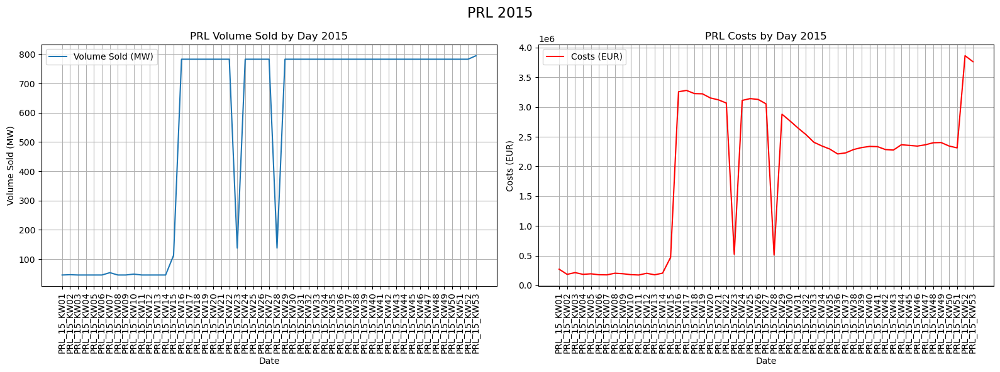

In [17]:
res15_p=res15[res15['Description'].str.contains('Primary control')].copy()

res15_p['Week'] = res15_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p15 = res15_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p15.index, grouped_p15['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2015')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p15.index, grouped_p15['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2015')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control  2015

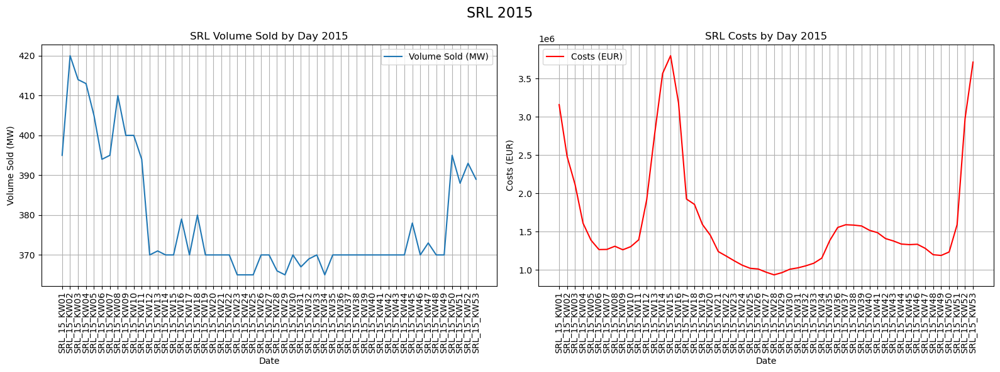

In [18]:
res15_s=res15[res15['Description'].str.contains('Secondary control')].copy()

res15_s['Week'] = res15_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_s15 = res15_s.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_s15.index, grouped_s15['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('SRL Volume Sold by Day 2015')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_s15.index, grouped_s15['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('SRL Costs by Day 2015')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('SRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction  2015

In [19]:
# Create DataFrame for Tertiary control
res15_CH_t = res15[res15['Description'].str.contains('Tertiary Power')].copy()

TPDW15=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW15=res15_CH_t[res15_CH_t.Description=='Tertiary Power UP'].copy()
TPD15_00_04=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD15_04_08=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD15_08_12=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD15_12_16=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD15_16_20=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD15_20_24=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPDW15['Week']=TPDW15['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW15['Week']=TPUW15['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW15=TPDW15.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW15=TPUW15.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD15_00_04['date'] = pd.to_datetime(TPD15_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_04_08['date'] = pd.to_datetime(TPD15_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_08_12['date'] = pd.to_datetime(TPD15_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_12_16['date'] = pd.to_datetime(TPD15_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_16_20['date'] = pd.to_datetime(TPD15_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_20_24['date'] = pd.to_datetime(TPD15_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')


grouped_TPD15_00_04=TPD15_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_04_08=TPD15_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_08_12=TPD15_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_12_16=TPD15_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_16_20=TPD15_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_20_24=TPD15_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD15 = [grouped_TPD15_00_04, grouped_TPD15_04_08, grouped_TPD15_08_12, grouped_TPD15_12_16, grouped_TPD15_16_20, grouped_TPD15_20_24]

grouped_TPW15=[grouped_TPDW15, grouped_TPUW15]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

min_volume=0, max_volume=308
min_cost=0.0, max_cost=27699.0


KeyboardInterrupt: 

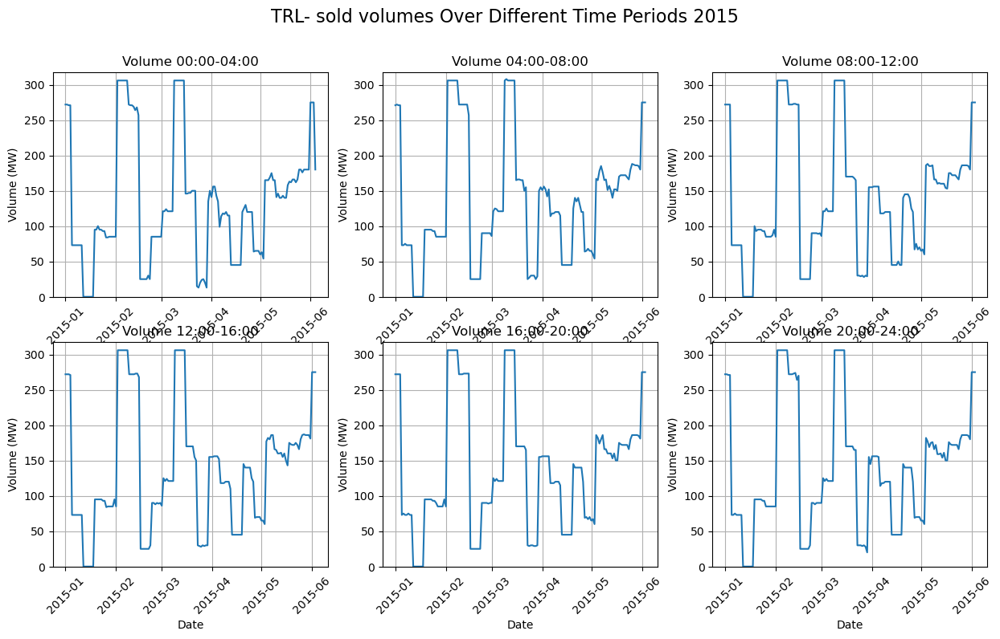

In [20]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD15])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD15])  # Get the maximum cost across all time periods
min_cost=min([data['Coûts'].min() for data in grouped_TPD15])
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD15])

print(f'min_volume={min_volume}, max_volume={max_volume}')
print(f'min_cost={min_cost}, max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD15):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2015', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD15):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2015', fontsize=16)
plt.tight_layout()
plt.show()


min volume: 0, max volume: 401
min cost: 0.0, max cost: 544562.0


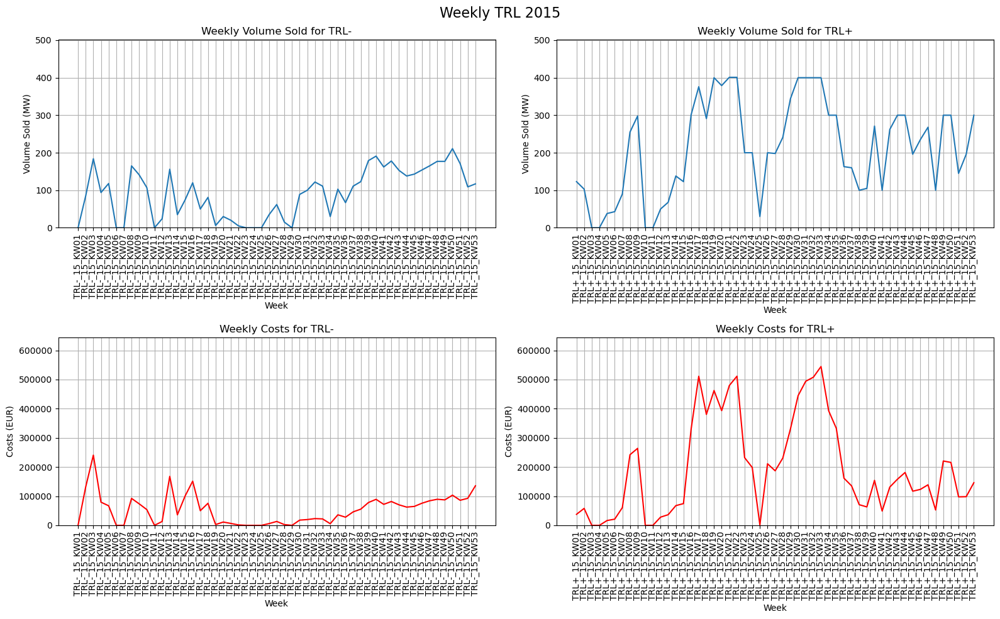

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW15])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW15])  # Get the maximum cost across all time periods
min_cost=min([data['Coûts'].min() for data in grouped_TPW15])
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW15])

print(f'min volume: {min_volume}, max volume: {max_volume}')
print(f'min cost: {min_cost}, max cost: {max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW15.index, grouped_TPDW15['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW15.index, grouped_TPUW15['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW15.index, grouped_TPDW15['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW15.index, grouped_TPUW15['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2016

In [ ]:
res16=pd.read_csv(DATA+'2016_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5', ])

print(res16.Description.unique())
res16


['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5
0,PRL_15_KW53,Primary control Auction,1,MW,1,MW,5001.0,EUR/MW,5001.0,EUR,29.77,EUR/MWh*
1,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4280.0,EUR/MW,21400.0,EUR,25.48,EUR/MWh*
2,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4305.0,EUR/MW,21525.0,EUR,25.62,EUR/MWh*
3,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4330.0,EUR/MW,21650.0,EUR,25.77,EUR/MWh*
4,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4355.0,EUR/MW,21775.0,EUR,25.92,EUR/MWh*
...,...,...,...,...,...,...,...,...,...,...,...,...
106236,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,15,MW,0,MW,1.8,CHF/MW,0.0,CHF,0.45,CHF/MWh*
106237,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,2.3,CHF/MW,0.0,CHF,0.58,CHF/MWh*
106238,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,2.7,CHF/MW,0.0,CHF,0.68,CHF/MWh*
106239,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,9.0,CHF/MW,0.0,CHF,2.25,CHF/MWh*


## Primary control auction 2016

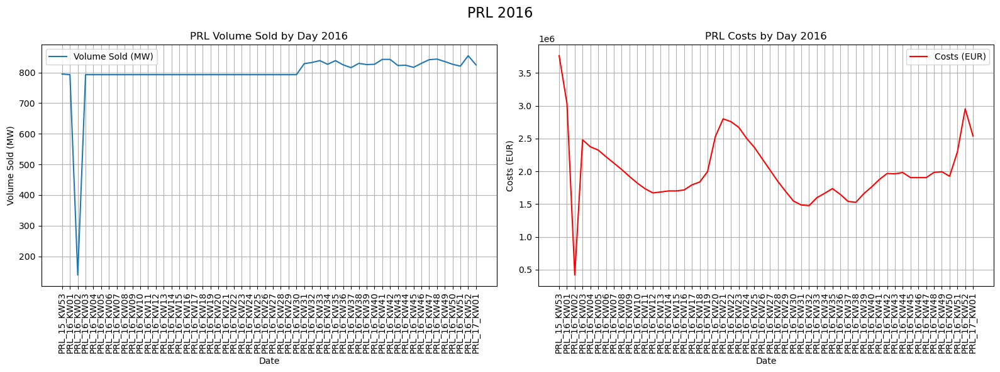

In [ ]:
res16_p=res16[res16['Description'].str.contains('Primary control')].copy()

res16_p['Week'] = res16_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p16 = res16_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p16.index, grouped_p16['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2016')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p16.index, grouped_p16['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2016')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2016

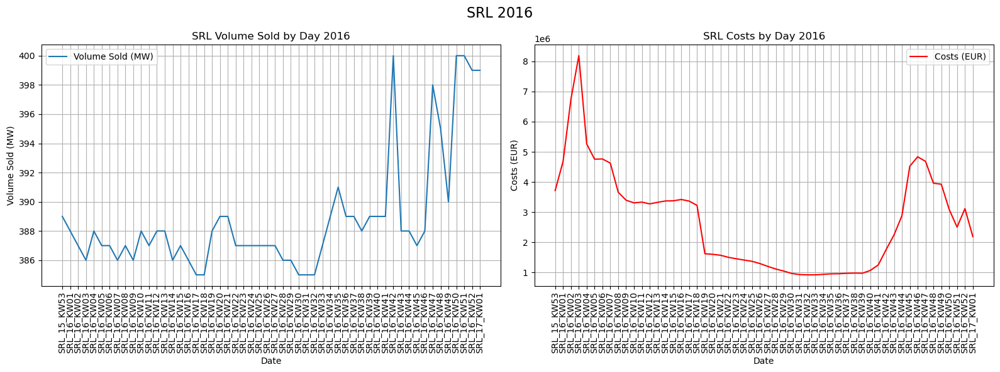

In [ ]:
res16_s=res16[res16['Description'].str.contains('Secondary control')].copy()

res16_s['Week'] = res16_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_s16 = res16_s.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_s16.index, grouped_s16['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('SRL Volume Sold by Day 2016')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_s16.index, grouped_s16['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('SRL Costs by Day 2016')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('SRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2016

In [ ]:
# Create DataFrame for Tertiary control
res16_CH_t = res16[res16['Description'].str.contains('Tertiary Power')].copy()

TPDW16=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW16=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP'].copy()
TPD16_00_04=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD16_04_08=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD16_08_12=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD16_12_16=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD16_16_20=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD16_20_24=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU16_00_04=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU16_04_08=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU16_08_12=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU16_12_16=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU16_16_20=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU16_20_24=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW16['Week']=TPDW16['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW16['Week']=TPUW16['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW16=TPDW16.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW16=TPUW16.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD16_00_04['date'] = pd.to_datetime(TPD16_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_04_08['date'] = pd.to_datetime(TPD16_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_08_12['date'] = pd.to_datetime(TPD16_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_12_16['date'] = pd.to_datetime(TPD16_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_16_20['date'] = pd.to_datetime(TPD16_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_20_24['date'] = pd.to_datetime(TPD16_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU16_00_04['date'] = pd.to_datetime(TPU16_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_04_08['date'] = pd.to_datetime(TPU16_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_08_12['date'] = pd.to_datetime(TPU16_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_12_16['date'] = pd.to_datetime(TPU16_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_16_20['date'] = pd.to_datetime(TPU16_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_20_24['date'] = pd.to_datetime(TPU16_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD16_00_04=TPD16_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_04_08=TPD16_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_08_12=TPD16_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_12_16=TPD16_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_16_20=TPD16_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_20_24=TPD16_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU16_00_04=TPU16_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_04_08=TPU16_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_08_12=TPU16_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_12_16=TPU16_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_16_20=TPU16_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_20_24=TPU16_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD16 = [grouped_TPD16_00_04, grouped_TPD16_04_08, grouped_TPD16_08_12, grouped_TPD16_12_16, grouped_TPD16_16_20, grouped_TPD16_20_24]

grouped_TPU16 = [grouped_TPU16_00_04, grouped_TPU16_04_08, grouped_TPU16_08_12, grouped_TPU16_12_16, grouped_TPU16_16_20, grouped_TPU16_20_24]

grouped_TPW16=[grouped_TPDW16, grouped_TPUW16]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=280
max_cost=28930.0


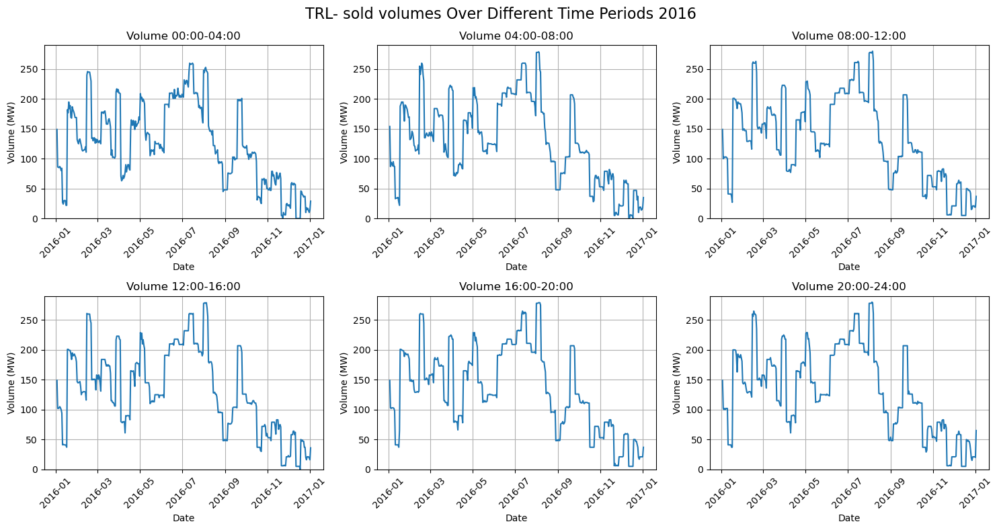

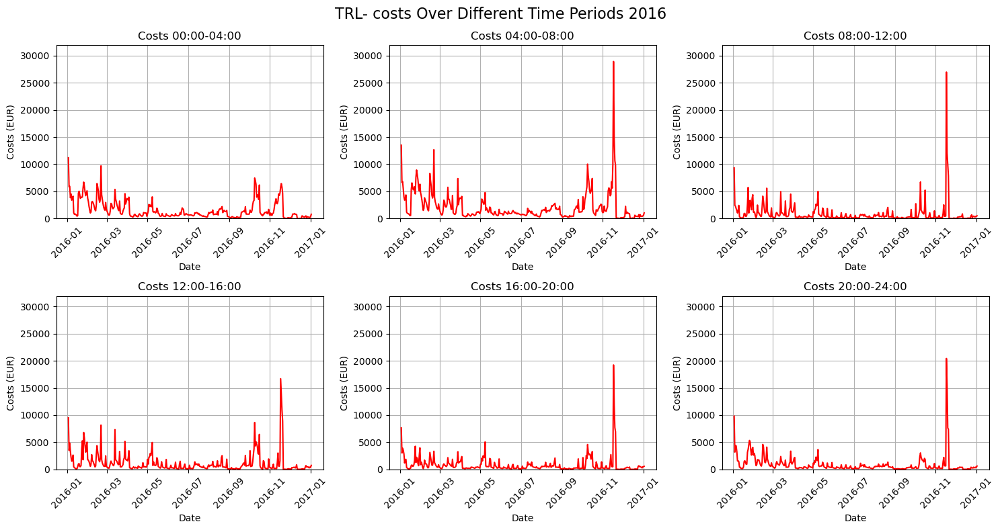

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD16):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD16):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=720
max_cost=53753.0


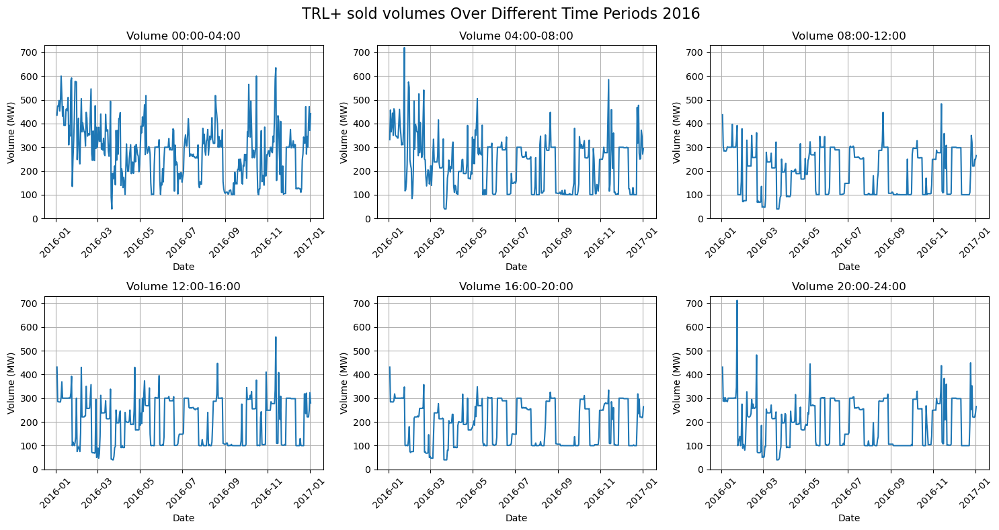

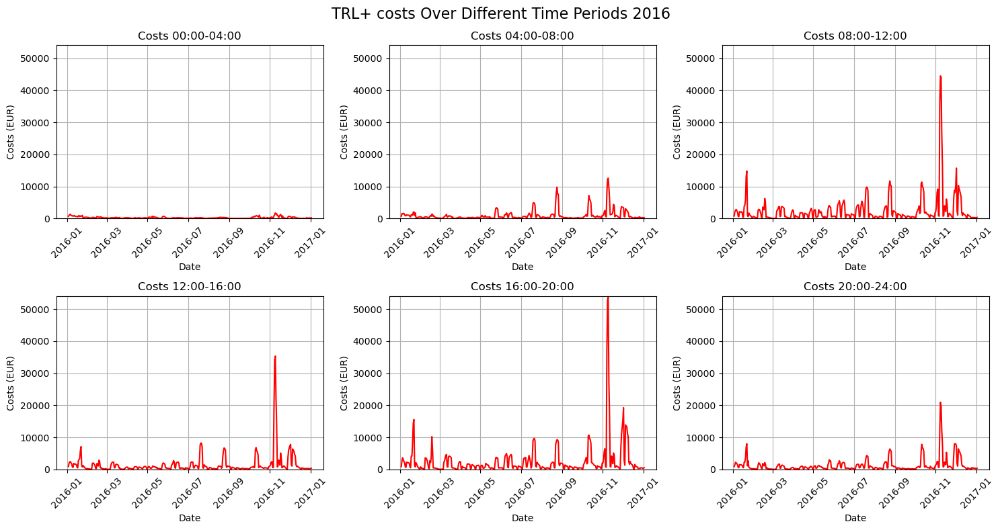

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU16):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU16):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=360
max_cost=370192.0


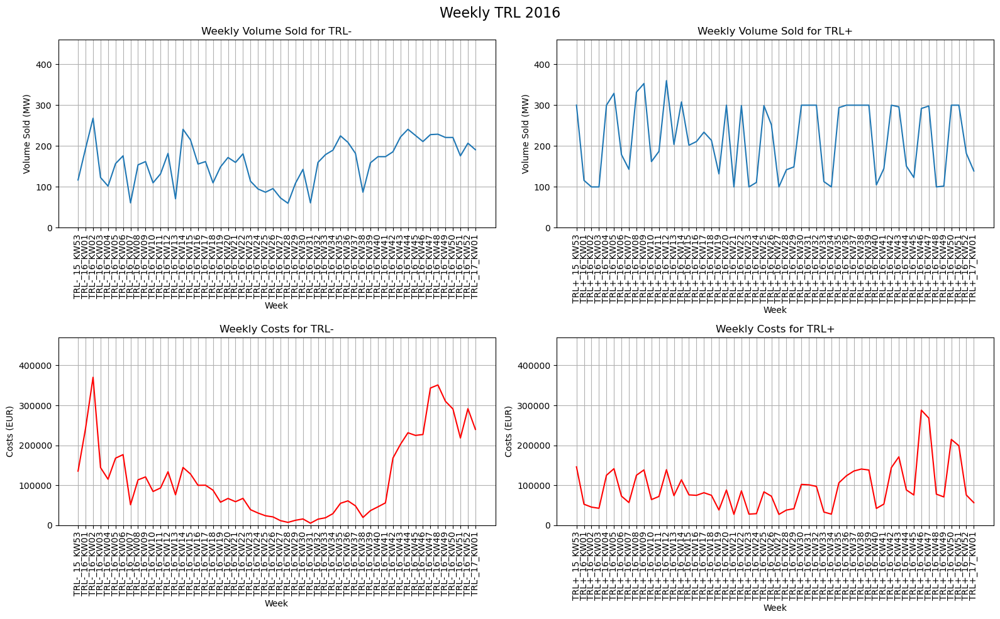

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW16.index, grouped_TPDW16['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW16.index, grouped_TPUW16['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW16.index, grouped_TPDW16['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW16.index, grouped_TPUW16['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2017

In [ ]:
res17=pd.read_csv(DATA+'2017_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])

res17_CH=res17[res17.Pays=='CH']
print(res17_CH.Description.unique())
res17_CH

['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
0,PRL_16_KW52,Primary control Auction,1,MW,1,MW,2750.0,EUR/MW,2750.0,EUR,16.37,EUR/MWh*,CH
1,PRL_16_KW52,Primary control Auction,1,MW,1,MW,3250.0,EUR/MW,3250.0,EUR,19.35,EUR/MWh*,CH
2,PRL_16_KW52,Primary control Auction,6,MW,6,MW,3199.0,EUR/MW,19194.0,EUR,19.04,EUR/MWh*,CH
3,PRL_16_KW52,Primary control Auction,6,MW,6,MW,2999.0,EUR/MW,17994.0,EUR,17.85,EUR/MWh*,CH
4,PRL_16_KW52,Primary control Auction,3,MW,3,MW,3828.0,EUR/MW,11484.0,EUR,22.79,EUR/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
127530,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,175.0,CHF/MW,0.0,CHF,43.75,CHF/MWh*,CH
127531,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,20,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH
127532,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH
127533,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH


## Primary control auction 2017

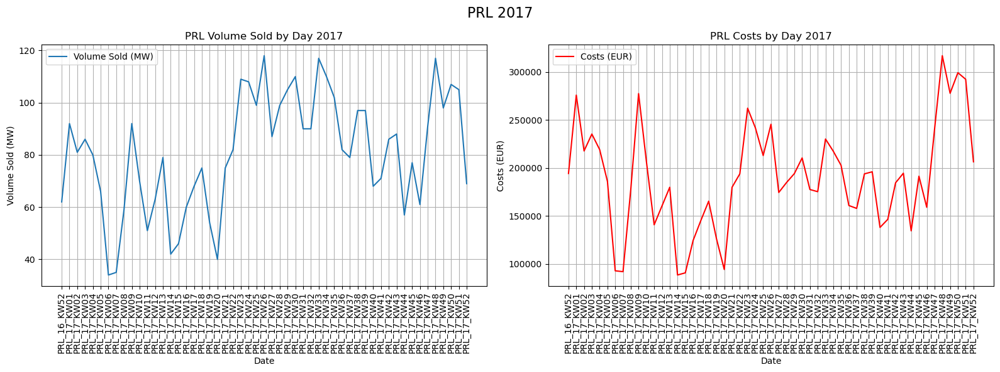

In [ ]:
res17_CH_p=res17_CH[res17_CH['Description'].str.contains('Primary control')].copy()

res17_CH_p['Week'] = res17_CH_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p17 = res17_CH_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p17.index, grouped_p17['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2017')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p17.index, grouped_p17['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2017')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2017

In [ ]:
# Create DataFrame for Secondary control
res17_CH_s = res17_CH[res17_CH['Description'].str.contains('Secondary control')].copy()
res17_CH_s

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
38263,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,7499.00,CHF/MW,224970.00,CHF,44.64,CHF/MWh*,CH
38264,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,8099.00,CHF/MW,242970.00,CHF,48.21,CHF/MWh*,CH
38265,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,8499.00,CHF/MW,84990.00,CHF,50.59,CHF/MWh*,CH
38266,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,9422.00,CHF/MW,94220.00,CHF,56.08,CHF/MWh*,CH
38267,SRL_16_KW52,Secondary control Auction,5,MW,5,MW,9240.00,CHF/MW,46200.00,CHF,55.00,CHF/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39210,SRL_17_KW52,Secondary control Auction,10,MW,10,MW,6830.00,CHF/MW,68300.00,CHF,40.65,CHF/MWh*,CH
39211,SRL_17_KW52,Secondary control Auction,30,MW,30,MW,4827.00,CHF/MW,144810.00,CHF,28.73,CHF/MWh*,CH
39212,SRL_17_KW52,Secondary control Auction,22,MW,22,MW,4347.84,CHF/MW,95652.48,CHF,25.88,CHF/MWh*,CH
39213,SRL_17_KW52,Secondary control Auction,5,MW,5,MW,5439.84,CHF/MW,27199.20,CHF,32.38,CHF/MWh*,CH


In [ ]:
SRL17=res17_CH_s[res17_CH_s.Description=='Secondary control Auction'].copy()
SRL17['Week'] = SRL17['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

grouped_SRL17=SRL17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

In [ ]:
SRL17

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Week
38263,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,7499.00,CHF/MW,224970.00,CHF,44.64,CHF/MWh*,CH,SRL_16_KW52
38264,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,8099.00,CHF/MW,242970.00,CHF,48.21,CHF/MWh*,CH,SRL_16_KW52
38265,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,8499.00,CHF/MW,84990.00,CHF,50.59,CHF/MWh*,CH,SRL_16_KW52
38266,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,9422.00,CHF/MW,94220.00,CHF,56.08,CHF/MWh*,CH,SRL_16_KW52
38267,SRL_16_KW52,Secondary control Auction,5,MW,5,MW,9240.00,CHF/MW,46200.00,CHF,55.00,CHF/MWh*,CH,SRL_16_KW52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39210,SRL_17_KW52,Secondary control Auction,10,MW,10,MW,6830.00,CHF/MW,68300.00,CHF,40.65,CHF/MWh*,CH,SRL_17_KW52
39211,SRL_17_KW52,Secondary control Auction,30,MW,30,MW,4827.00,CHF/MW,144810.00,CHF,28.73,CHF/MWh*,CH,SRL_17_KW52
39212,SRL_17_KW52,Secondary control Auction,22,MW,22,MW,4347.84,CHF/MW,95652.48,CHF,25.88,CHF/MWh*,CH,SRL_17_KW52
39213,SRL_17_KW52,Secondary control Auction,5,MW,5,MW,5439.84,CHF/MW,27199.20,CHF,32.38,CHF/MWh*,CH,SRL_17_KW52


In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = grouped_SRL17['Volume_attribué'].max() 
max_cost = grouped_SRL17['Coûts'].max() 
min_volume=grouped_SRL17['Volume_attribué'].min() 
min_cost = grouped_SRL17['Coûts'].min() 

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

max_volume=400, min volume= 383
max_cost=6007845.48, min cost= 795742.72


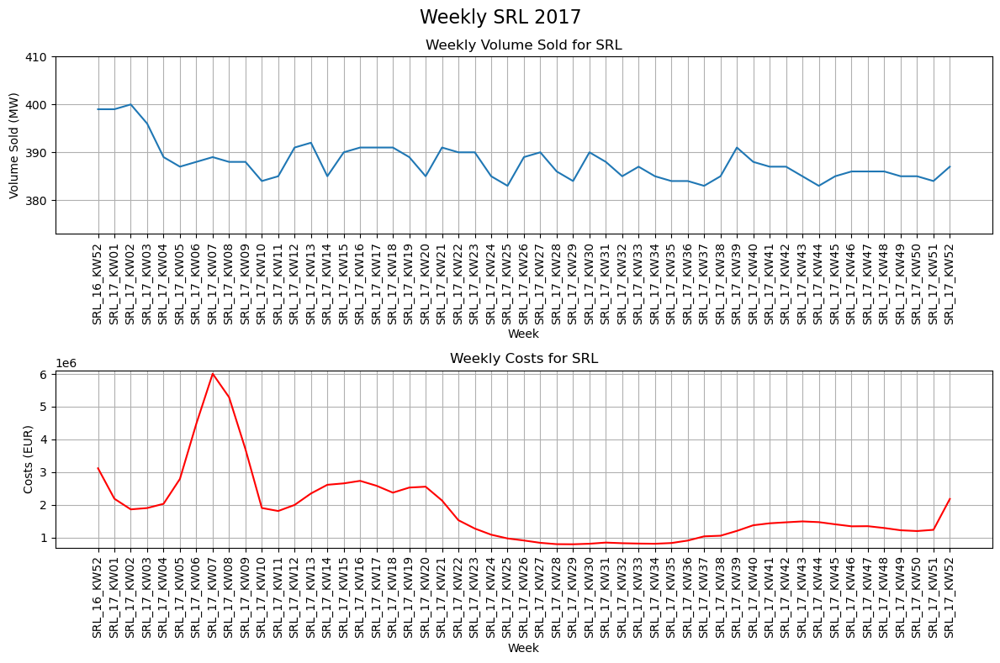

In [ ]:
# Define dynamic y-limits
volume_ylim = (min_volume-10, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost-100000, max_cost + 100000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 1, figsize=(12, 8))  # Adjust figure size as needed

axes[0].plot(grouped_SRL17.index, grouped_SRL17['Volume_attribué'], label='SRL Volume Sold')
axes[0].set_title(f'Weekly Volume Sold for SRL')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Volume Sold (MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)
axes[0].set_ylim(volume_ylim)

axes[1].plot(grouped_SRL17.index, grouped_SRL17['Coûts'], label='SRL Costs', color='red')
axes[1].set_title(f'Weekly Costs for SRL')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Costs (EUR)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)
axes[1].set_ylim(cost_ylim)

plt.suptitle('Weekly SRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2017

In [ ]:
# Create DataFrame for Tertiary control
res17_CH_t = res17_CH[res17_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW17=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW17=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP'].copy()
TPD17_00_04=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD17_04_08=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD17_08_12=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD17_12_16=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD17_16_20=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD17_20_24=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU17_00_04=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU17_04_08=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU17_08_12=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU17_12_16=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU17_16_20=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU17_20_24=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW17['Week']=TPDW17['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW17['Week']=TPUW17['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW17=TPDW17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW17=TPUW17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD17_00_04['date'] = pd.to_datetime(TPD17_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_04_08['date'] = pd.to_datetime(TPD17_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_08_12['date'] = pd.to_datetime(TPD17_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_12_16['date'] = pd.to_datetime(TPD17_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_16_20['date'] = pd.to_datetime(TPD17_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_20_24['date'] = pd.to_datetime(TPD17_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU17_00_04['date'] = pd.to_datetime(TPU17_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_04_08['date'] = pd.to_datetime(TPU17_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_08_12['date'] = pd.to_datetime(TPU17_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_12_16['date'] = pd.to_datetime(TPU17_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_16_20['date'] = pd.to_datetime(TPU17_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_20_24['date'] = pd.to_datetime(TPU17_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD17_00_04=TPD17_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_04_08=TPD17_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_08_12=TPD17_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_12_16=TPD17_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_16_20=TPD17_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_20_24=TPD17_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU17_00_04=TPU17_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_04_08=TPU17_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_08_12=TPU17_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_12_16=TPU17_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_16_20=TPU17_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_20_24=TPU17_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD17 = [grouped_TPD17_00_04, grouped_TPD17_04_08, grouped_TPD17_08_12, grouped_TPD17_12_16, grouped_TPD17_16_20, grouped_TPD17_20_24]

grouped_TPU17 = [grouped_TPU17_00_04, grouped_TPU17_04_08, grouped_TPU17_08_12, grouped_TPU17_12_16, grouped_TPU17_16_20, grouped_TPU17_20_24]

grouped_TPW17=[grouped_TPDW17, grouped_TPUW17]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=243
max_cost=9235.0


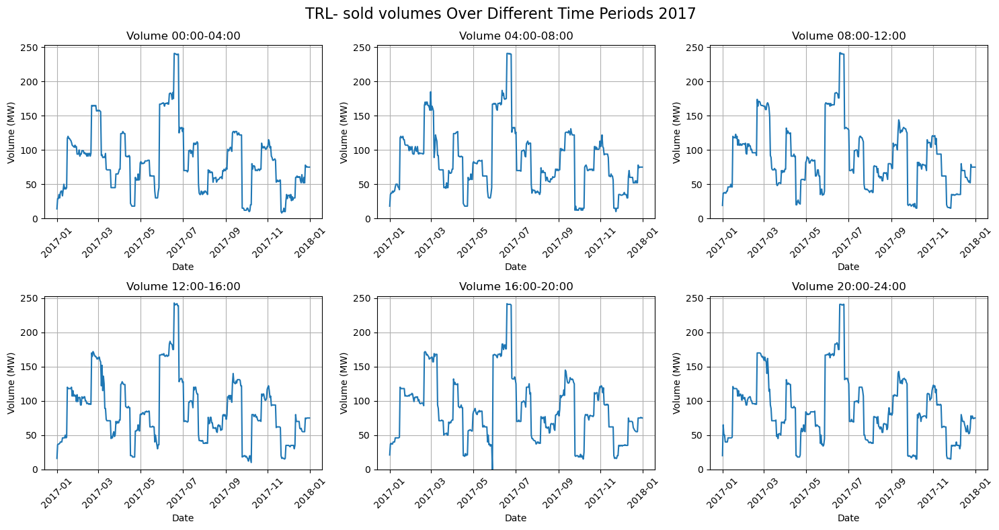

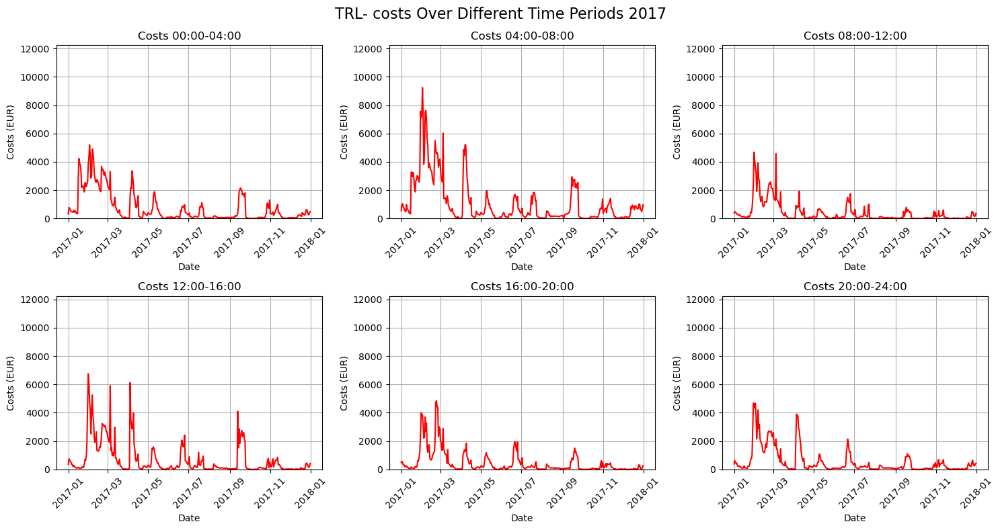

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD17):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD17):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=462
max_cost=22541.699999999997


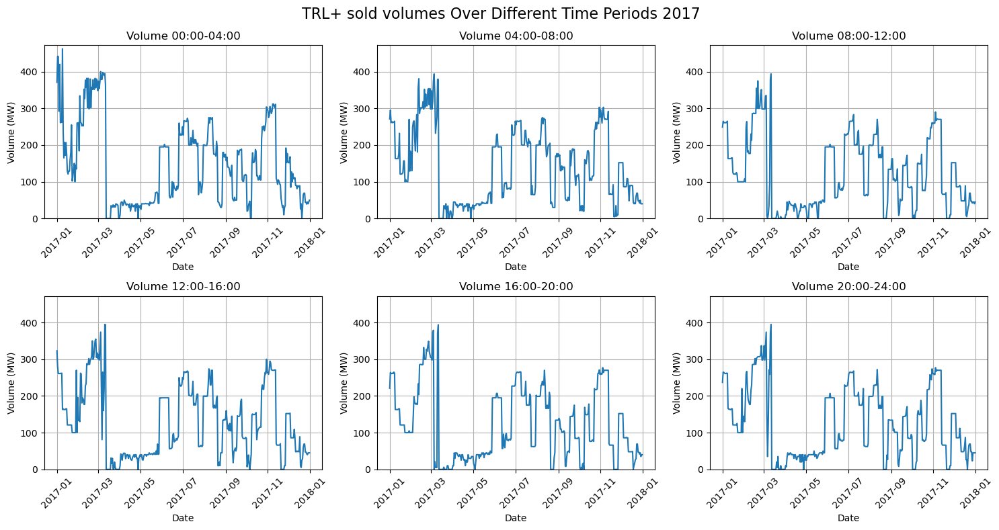

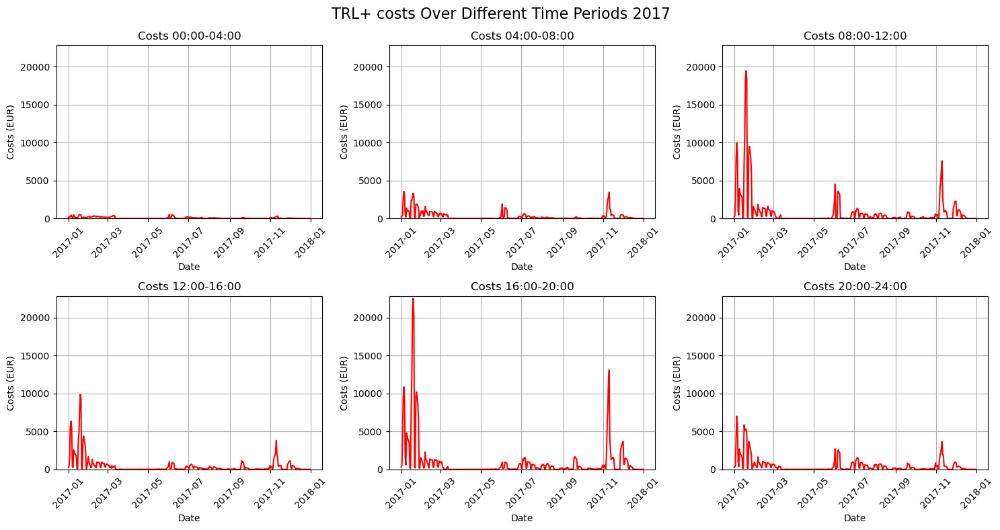

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU17):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU17):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=499
max_cost=398394.6


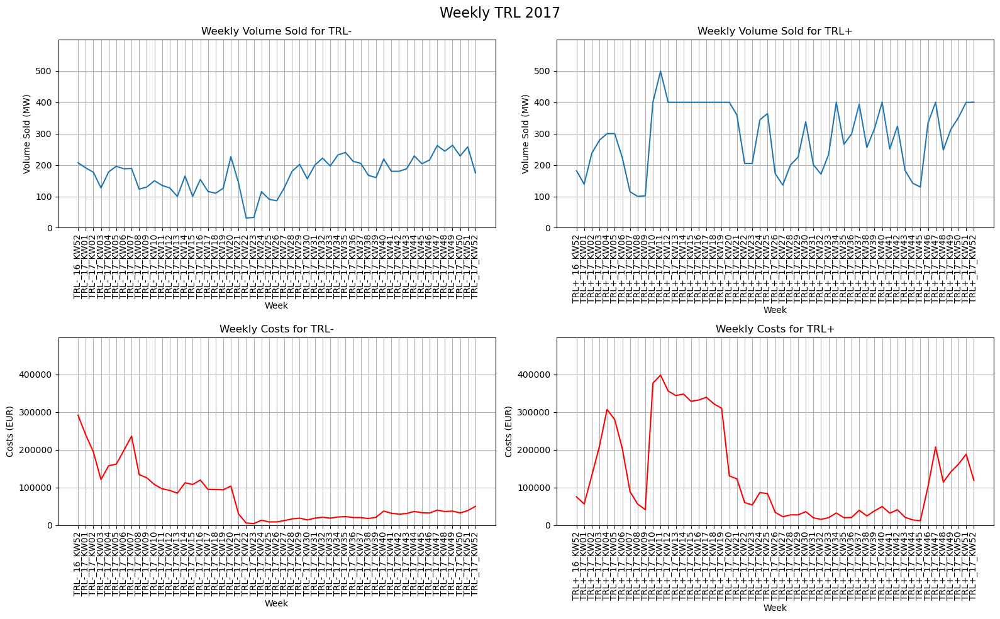

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW17.index, grouped_TPDW17['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW17.index, grouped_TPUW17['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW17.index, grouped_TPDW17['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW17.index, grouped_TPUW17['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2018

In [ ]:
res18 = pd.read_csv(DATA+'2018-PRL-SRL-TRL-Ergebnis.csv', encoding='ISO-8859-1', sep=';',header=None, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])

columns_to_convert = ['Volume_offert', 'Volume_attribué', 'Prix_prestation', 'Coûts', 'Prix']

for col in columns_to_convert:
    res18[col] = pd.to_numeric(res18[col], errors='coerce')

res18.dtypes

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\1506348686.py:1: DtypeWarning: Columns (2,4,6,8,10) have mixed types. Specify dtype option on import or set low_memory=False.
  res18 = pd.read_csv(DATA+'2018-PRL-SRL-TRL-Ergebnis.csv', encoding='ISO-8859-1', sep=';',header=None, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])


Appel_offres        object
Description         object
Volume_offert      float64
Unité1              object
Volume_attribué    float64
Unité2              object
Prix_prestation    float64
Unité3              object
Coûts              float64
Unité4              object
Prix               float64
Unité5              object
Pays                object
dtype: object

## Primary control auction 2018

In [ ]:
res18_CH=res18[res18.Pays=='CH']
print(res18_CH.Description.unique())
res18_CH

res18_CH_p=res18_CH[res18_CH['Description'].str.contains('Primary control')].copy()
res18_CH_p.dtypes

['Primary control Auction' 'Secondary control Auction'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


Appel_offres        object
Description         object
Volume_offert      float64
Unité1              object
Volume_attribué    float64
Unité2              object
Prix_prestation    float64
Unité3              object
Coûts              float64
Unité4              object
Prix               float64
Unité5              object
Pays                object
dtype: object

In [ ]:
res18_CH_p['Week'] = res18_CH_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
res18_CH_p

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Week
1,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3587.0,EUR/MW,3587.0,EUR,21.35,EUR/MWh*,CH,18_KW01
2,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,18_KW01
3,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,18_KW01
4,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3142.0,EUR/MW,3142.0,EUR,18.70,EUR/MWh*,CH,18_KW01
5,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3175.0,EUR/MW,3175.0,EUR,18.90,EUR/MWh*,CH,18_KW01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37876,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,2974.0,EUR/MW,2974.0,EUR,17.70,EUR/MWh*,CH,19_KW01
37877,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,2999.0,EUR/MW,2999.0,EUR,17.85,EUR/MWh*,CH,19_KW01
37878,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,3049.0,EUR/MW,3049.0,EUR,18.15,EUR/MWh*,CH,19_KW01
37879,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,19_KW01


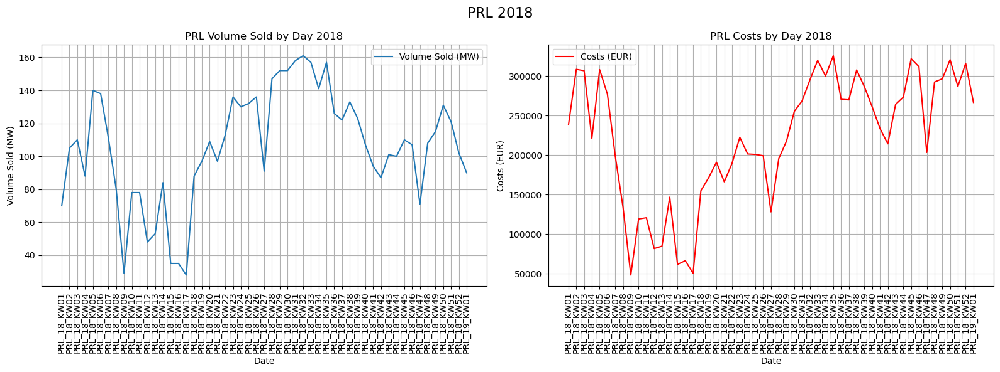

In [ ]:
# Grouping by 'date' and summing the volume sold and costs
grouped_p18 = res18_CH_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p18.index, grouped_p18['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2018')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p18.index, grouped_p18['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2018')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2018

In [ ]:
# Create DataFrame for Secondary control
res18_CH_s = res18_CH[res18_CH['Description'].str.contains('Secondary control')].copy()
res18_CH_s

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
38551,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5030.0,CHF/MW,150900.0,CHF,29.94,CHF/MWh*,CH
38552,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5231.0,CHF/MW,156930.0,CHF,31.14,CHF/MWh*,CH
38553,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5318.0,CHF/MW,159540.0,CHF,31.65,CHF/MWh*,CH
38554,SRL_18_KW01,Secondary control Auction,10.0,MW,10.0,MW,4935.0,CHF/MW,49350.0,CHF,29.38,CHF/MWh*,CH
38555,SRL_18_KW01,Secondary control Auction,10.0,MW,10.0,MW,5034.0,CHF/MW,50340.0,CHF,29.96,CHF/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39660,SRL_19_KW01,Secondary control Auction SRL-,20.0,MW,20.0,MW,3968.0,CHF/MW,79360.0,CHF,23.62,CHF/MWh*,CH
39661,SRL_19_KW01,Secondary control Auction SRL-,20.0,MW,20.0,MW,4291.0,CHF/MW,85820.0,CHF,25.54,CHF/MWh*,CH
39662,SRL_19_KW01,Secondary control Auction SRL-,100.0,MW,100.0,MW,4490.0,CHF/MW,449000.0,CHF,26.73,CHF/MWh*,CH
39663,SRL_19_KW01,Secondary control Auction SRL-,50.0,MW,50.0,MW,3834.0,CHF/MW,191700.0,CHF,22.82,CHF/MWh*,CH


In [ ]:
tmp=res18_CH_s.groupby('Description').agg({'Volume_attribué': 'count'})
tmp

,Volume_attribué
Description,
Secondary control Auction,361
Secondary control Auction SRL+,373
Secondary control Auction SRL-,380


In [ ]:

res18_CH_s['Week'] = res18_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL18=res18_CH_s[res18_CH_s.Description=='Secondary control Auction'].copy()
SRL18m=res18_CH_s[res18_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL18p=res18_CH_s[res18_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL18=SRL18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_SRL18m=SRL18m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_SRL18p=SRL18p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_SRL18=[grouped_SRL18m, grouped_SRL18p, grouped_SRL18]
SRL_labels=['SRL-','SRL+','SRL']

max_volume=425.0, min volume= 366.0
max_cost=2391539.4, min cost= 235038.0


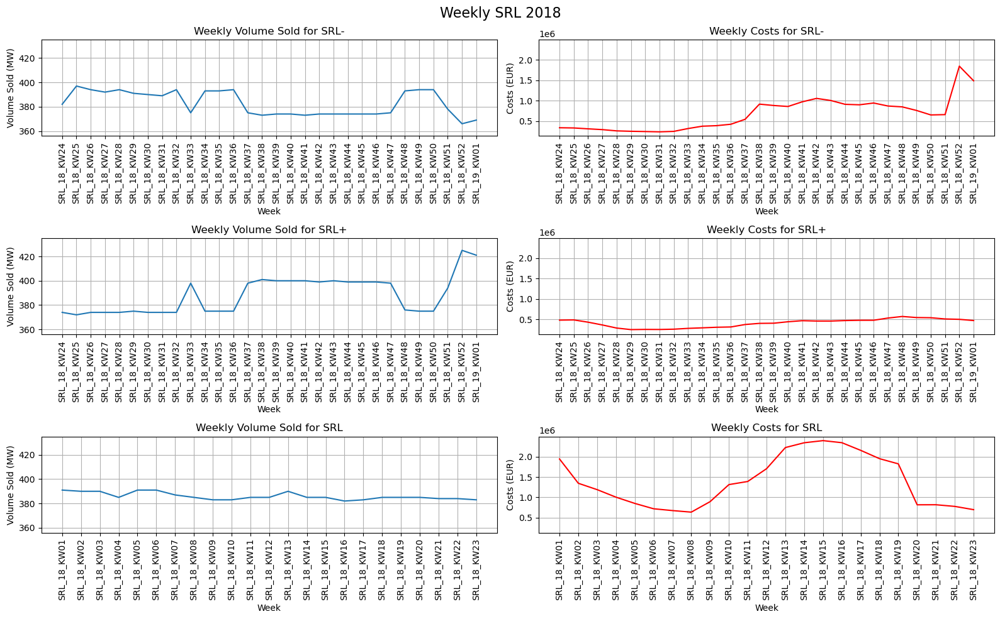

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL18])
min_cost = min([data['Coûts'].min() for data in grouped_SRL18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (min_volume-10, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost-100000, max_cost + 100000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(3, 2, figsize=(16, 10))  # Adjust figure size as needed

for i, data in enumerate(grouped_SRL18):
    
    axes[i, 0].plot(data.index, data['Volume_attribué'], label=f'{SRL_labels[i]} Volume Sold')
    axes[i, 0].set_title(f'Weekly Volume Sold for {SRL_labels[i]}')
    axes[i, 0].set_xlabel('Week')
    axes[i, 0].set_ylabel('Volume Sold (MW)')
    axes[i, 0].grid(True)
    axes[i, 0].tick_params(axis='x', rotation=90)
    axes[i, 0].set_ylim(volume_ylim)
    
    axes[i, 1].plot(data.index, data['Coûts'], label=f'{SRL_labels[i]} Costs', color='red')
    axes[i, 1].set_title(f'Weekly Costs for {SRL_labels[i]}')
    axes[i, 1].set_xlabel('Week')
    axes[i, 1].set_ylabel('Costs (EUR)')
    axes[i, 1].grid(True)
    axes[i, 1].tick_params(axis='x', rotation=90)
    axes[i, 1].set_ylim(cost_ylim)
    
plt.suptitle('Weekly SRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2018

In [ ]:
# Create DataFrame for Tertiary control
res18_CH_t = res18_CH[res18_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW18=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW18=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP'].copy()
TPD18_00_04=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD18_04_08=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD18_08_12=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD18_12_16=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD18_16_20=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD18_20_24=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU18_00_04=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU18_04_08=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU18_08_12=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU18_12_16=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU18_16_20=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU18_20_24=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW18['Week']=TPDW18['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW18['Week']=TPUW18['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW18=TPDW18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW18=TPUW18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD18_00_04['date'] = pd.to_datetime(TPD18_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_04_08['date'] = pd.to_datetime(TPD18_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_08_12['date'] = pd.to_datetime(TPD18_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_12_16['date'] = pd.to_datetime(TPD18_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_16_20['date'] = pd.to_datetime(TPD18_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_20_24['date'] = pd.to_datetime(TPD18_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU18_00_04['date'] = pd.to_datetime(TPU18_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_04_08['date'] = pd.to_datetime(TPU18_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_08_12['date'] = pd.to_datetime(TPU18_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_12_16['date'] = pd.to_datetime(TPU18_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_16_20['date'] = pd.to_datetime(TPU18_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_20_24['date'] = pd.to_datetime(TPU18_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD18_00_04=TPD18_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_04_08=TPD18_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_08_12=TPD18_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_12_16=TPD18_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_16_20=TPD18_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_20_24=TPD18_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU18_00_04=TPU18_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_04_08=TPU18_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_08_12=TPU18_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_12_16=TPU18_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_16_20=TPU18_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_20_24=TPU18_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD18 = [grouped_TPD18_00_04, grouped_TPD18_04_08, grouped_TPD18_08_12, grouped_TPD18_12_16, grouped_TPD18_16_20, grouped_TPD18_20_24]

grouped_TPU18 = [grouped_TPU18_00_04, grouped_TPU18_04_08, grouped_TPU18_08_12, grouped_TPU18_12_16, grouped_TPU18_16_20, grouped_TPU18_20_24]

grouped_TPW18=[grouped_TPDW18, grouped_TPUW18]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=222.0, min volume= 0.0
max_cost=8294.19, min cost= 0.0


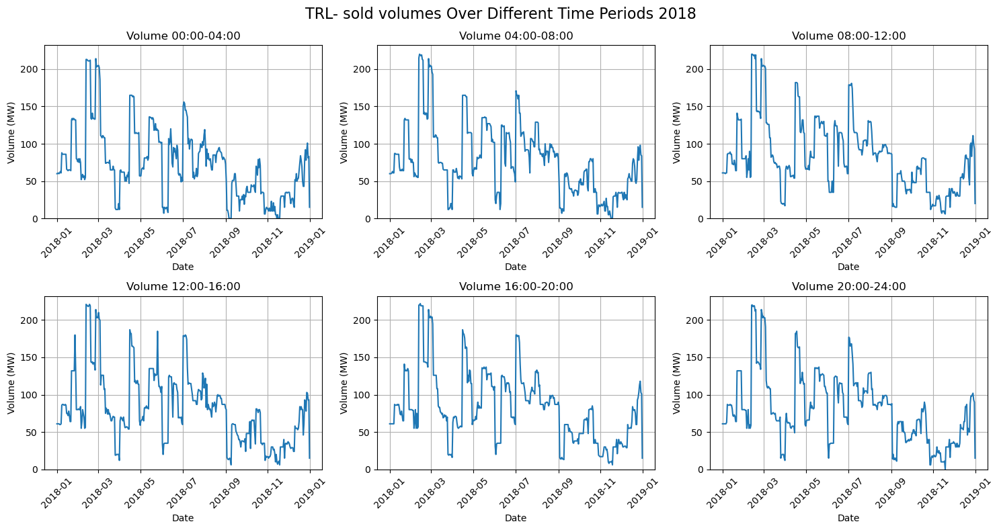

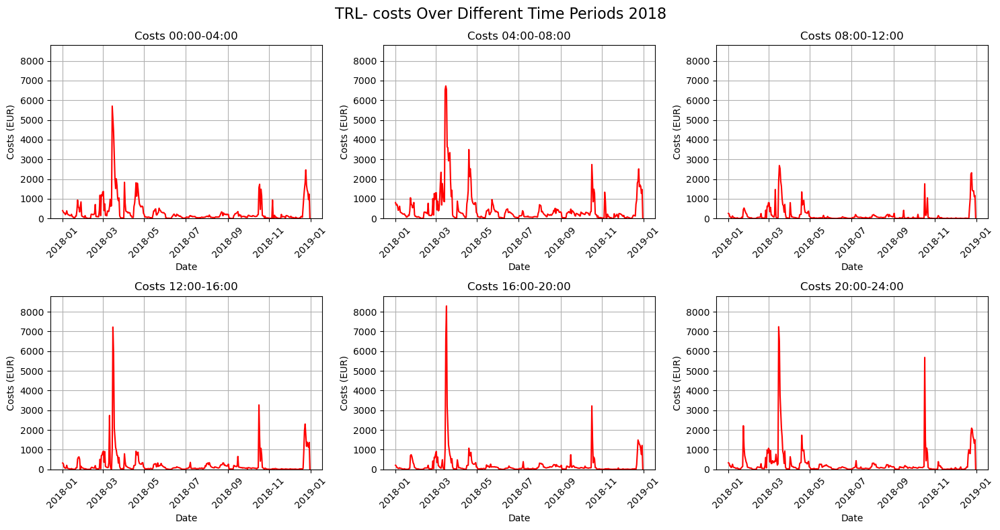

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD18])
min_cost = min([data['Coûts'].min() for data in grouped_TPD18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 500)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD18):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD18):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=397.0, min volume= 0.0
max_cost=33059.88, min cost= 0.0


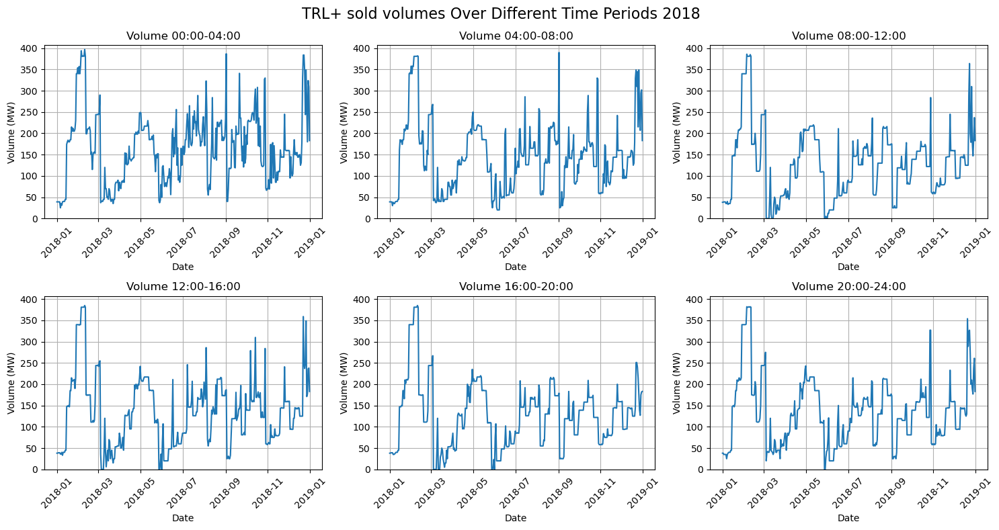

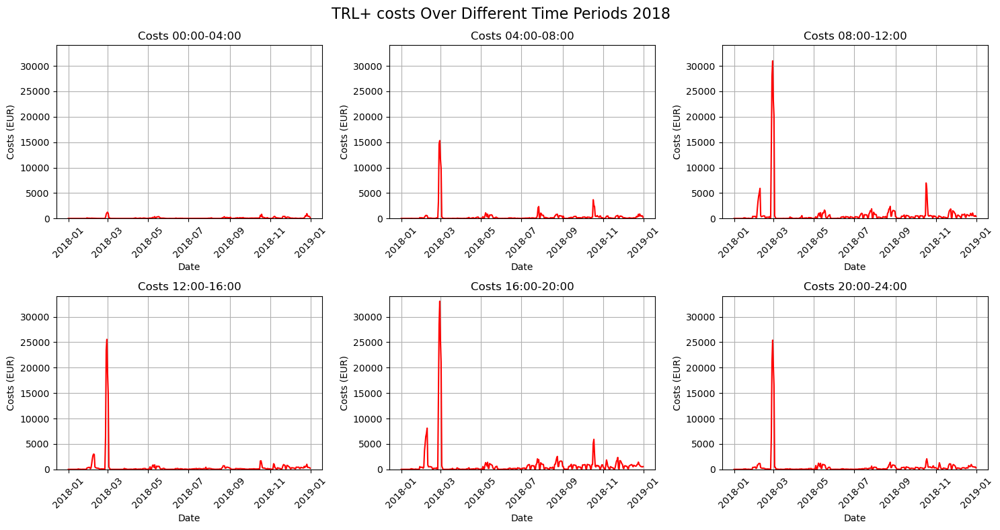

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPU18])
min_cost = min([data['Coûts'].min() for data in grouped_TPU18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 1000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU18):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU18):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=400.0, min volume= 19.0
max_cost=143120.36, min cost= 1825.0


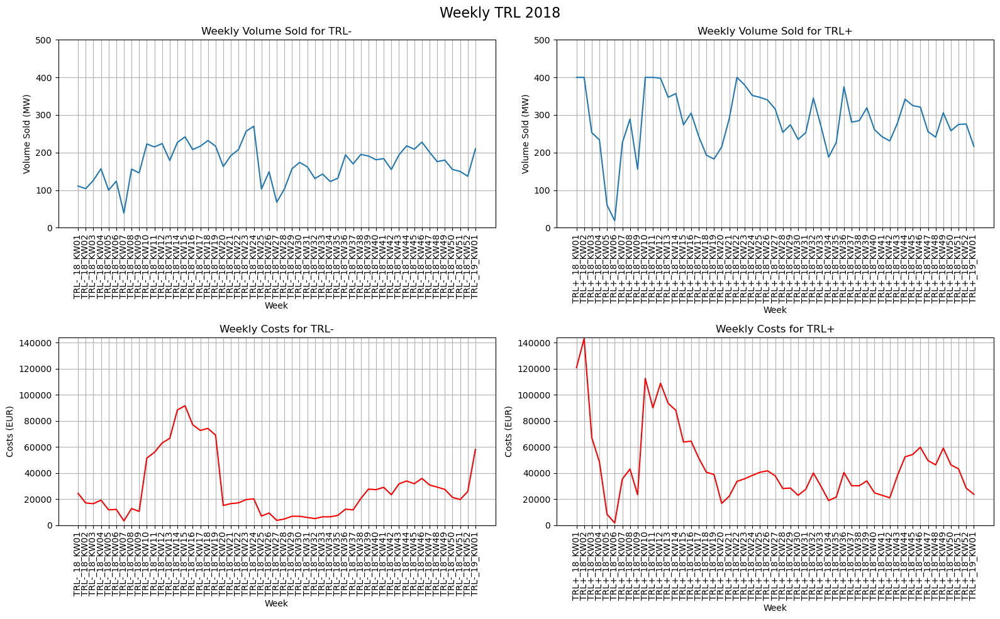

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW18])
min_cost = min([data['Coûts'].min() for data in grouped_TPW18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 1000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW18.index, grouped_TPDW18['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW18.index, grouped_TPUW18['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW18.index, grouped_TPDW18['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW18.index, grouped_TPUW18['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2019

In [ ]:
res19=pd.read_csv(DATA+'2019_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res19_CH=res19[res19.Pays=='CH']
print(res19_CH.Description.unique())
res19_CH

['Primary control Auction' 'Secondary control Auction SRL+'
 'Secondary control Auction SRL-' 'Tertiary Power DOWN'
 'Tertiary Power UP' 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\1514265379.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res19=pd.read_csv(DATA+'2019_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_19_07_01,Primary control Auction,17,MW,17,MW,50.00,EUR/MW,850.00,EUR,7.50,EUR/MWh*,CH,2.08,EUR/MWh*,Ja
1,PRL_19_07_01,Primary control Auction,3,MW,3,MW,84.00,EUR/MW,252.00,EUR,7.50,EUR/MWh*,CH,3.50,EUR/MWh*,Nein
2,PRL_19_07_01,Primary control Auction,25,MW,25,MW,123.95,EUR/MW,3098.75,EUR,7.50,EUR/MWh*,CH,5.16,EUR/MWh*,Nein
3,PRL_19_07_01,Primary control Auction,9,MW,9,MW,49.00,EUR/MW,441.00,EUR,7.50,EUR/MWh*,CH,2.04,EUR/MWh*,Nein
4,PRL_19_07_01,Primary control Auction,2,MW,2,MW,51.75,EUR/MW,103.50,EUR,7.50,EUR/MWh*,CH,2.16,EUR/MWh*,Nein
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219392,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,0.80,CHF/MW,8.00,CHF,0.20,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
219393,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,20,MW,0.90,CHF/MW,18.00,CHF,0.22,CHF/MWh*,CH,0.22,CHF/MWh*,NaN
219394,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,8,MW,8,MW,1.20,CHF/MW,9.60,CHF,0.30,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
219395,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,2.20,CHF/MW,0.00,CHF,0.55,CHF/MWh*,CH,0.55,CHF/MWh*,NaN


## Primary control auction 2019

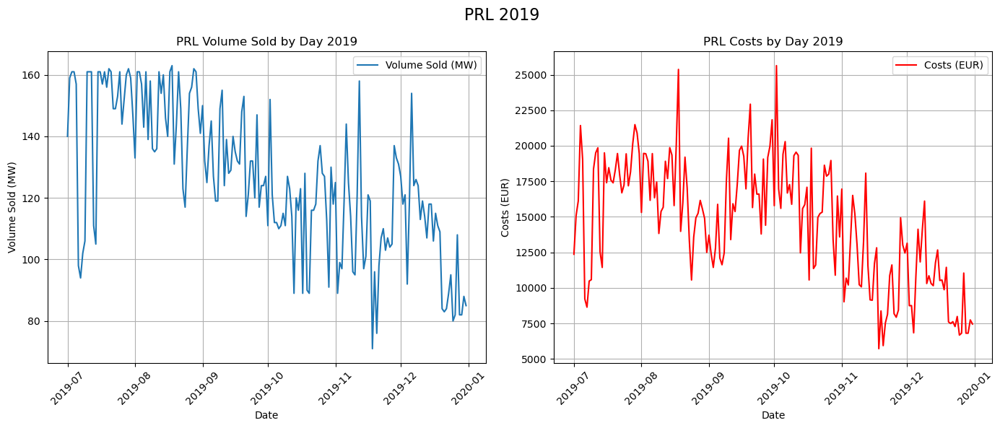

In [ ]:
res19_CH_p=res19_CH[res19_CH['Description'].str.contains('Primary control')].copy()

res19_CH_p['date'] = pd.to_datetime(res19_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p19 = res19_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p19.index, grouped_p19['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2019')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p19.index, grouped_p19['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2019')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2019', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2019

In [ ]:
# Create DataFrame for Secondary control
res19_CH_s = res19_CH[res19_CH['Description'].str.contains('Secondary control')].copy()

res19_CH_s['Week'] = res19_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL19m=res19_CH_s[res19_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL19p=res19_CH_s[res19_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL19m=SRL19m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_SRL19p=SRL19p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_SRL19=[grouped_SRL19m, grouped_SRL19p]

max_volume=449, min volume= 363
max_cost=1587900.6, min cost= 165303.52


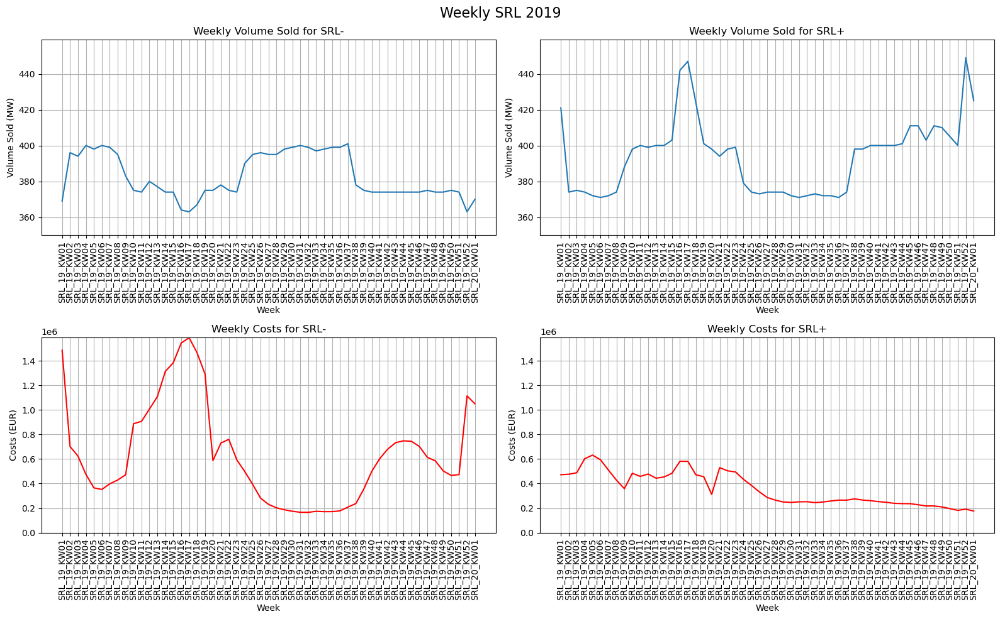

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL19])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL19])
min_cost = min([data['Coûts'].min() for data in grouped_SRL19])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL19m.index, grouped_SRL19m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL19p.index, grouped_SRL19p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL19m.index, grouped_SRL19m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL19p.index, grouped_SRL19p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2019', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2019

In [ ]:
# Create DataFrame for Tertiary control
res19_CH_t = res19_CH[res19_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW19=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW19=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP'].copy()
TPD19_00_04=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD19_04_08=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD19_08_12=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD19_12_16=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD19_16_20=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD19_20_24=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU19_00_04=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU19_04_08=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU19_08_12=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU19_12_16=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU19_16_20=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU19_20_24=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW19['Week']=TPDW19['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW19['Week']=TPUW19['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW19=TPDW19.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW19=TPUW19.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD19_00_04['date'] = pd.to_datetime(TPD19_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_04_08['date'] = pd.to_datetime(TPD19_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_08_12['date'] = pd.to_datetime(TPD19_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_12_16['date'] = pd.to_datetime(TPD19_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_16_20['date'] = pd.to_datetime(TPD19_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_20_24['date'] = pd.to_datetime(TPD19_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU19_00_04['date'] = pd.to_datetime(TPU19_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_04_08['date'] = pd.to_datetime(TPU19_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_08_12['date'] = pd.to_datetime(TPU19_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_12_16['date'] = pd.to_datetime(TPU19_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_16_20['date'] = pd.to_datetime(TPU19_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_20_24['date'] = pd.to_datetime(TPU19_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD19_00_04=TPD19_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD19_04_08=TPD19_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD19_08_12=TPD19_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD19_12_16=TPD19_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD19_16_20=TPD19_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD19_20_24=TPD19_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU19_00_04=TPU19_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU19_04_08=TPU19_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU19_08_12=TPU19_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU19_12_16=TPU19_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU19_16_20=TPU19_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU19_20_24=TPU19_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD19 = [grouped_TPD19_00_04, grouped_TPD19_04_08, grouped_TPD19_08_12, grouped_TPD19_12_16, grouped_TPD19_16_20, grouped_TPD19_20_24]

grouped_TPU19 = [grouped_TPU19_00_04, grouped_TPU19_04_08, grouped_TPU19_08_12, grouped_TPU19_12_16, grouped_TPU19_16_20, grouped_TPU19_20_24]

grouped_TPW19=[grouped_TPDW19, grouped_TPUW19]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=145
max_cost=6238.6


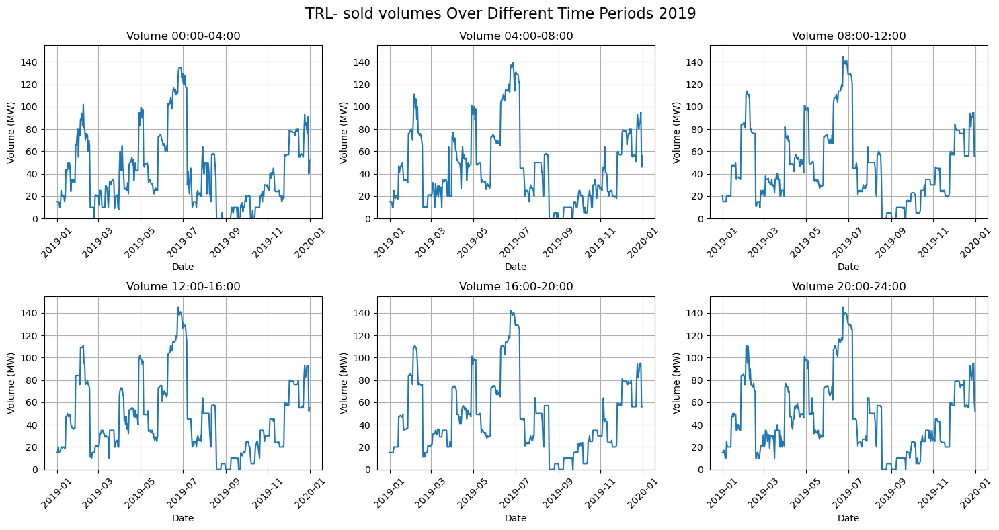

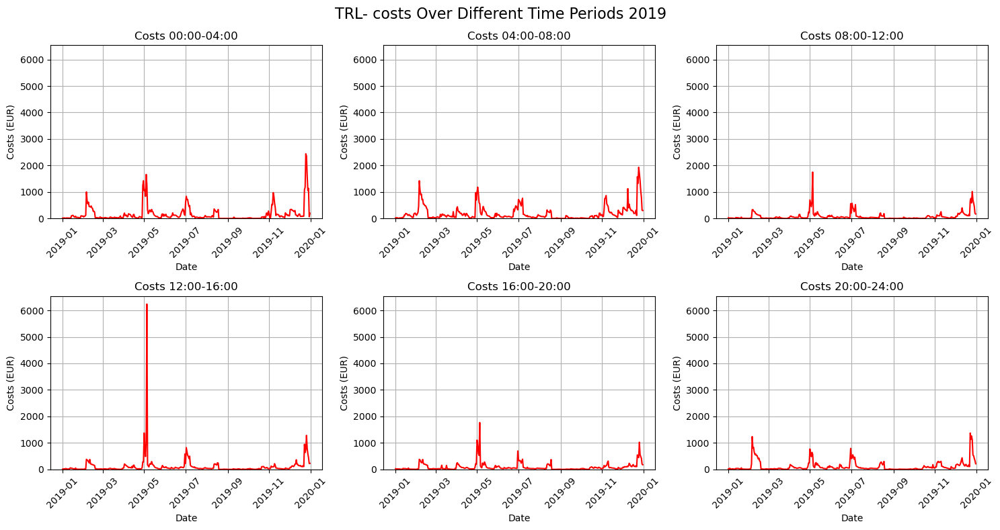

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=331
max_cost=11074.1


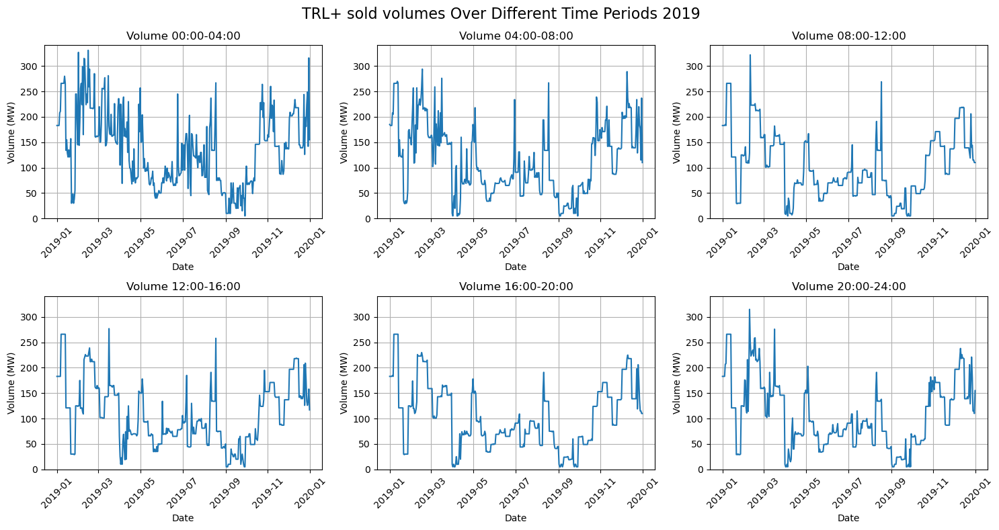

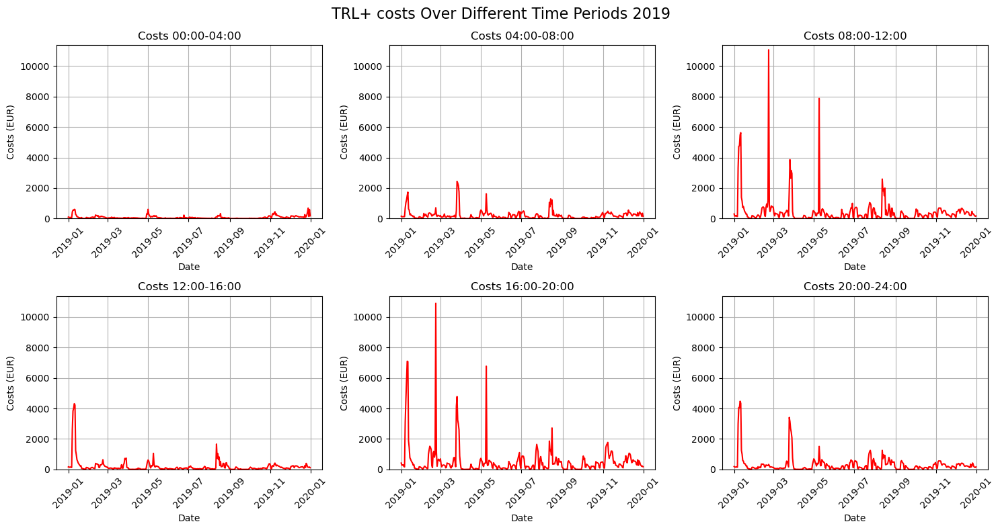

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=399
max_cost=69196.20999999999


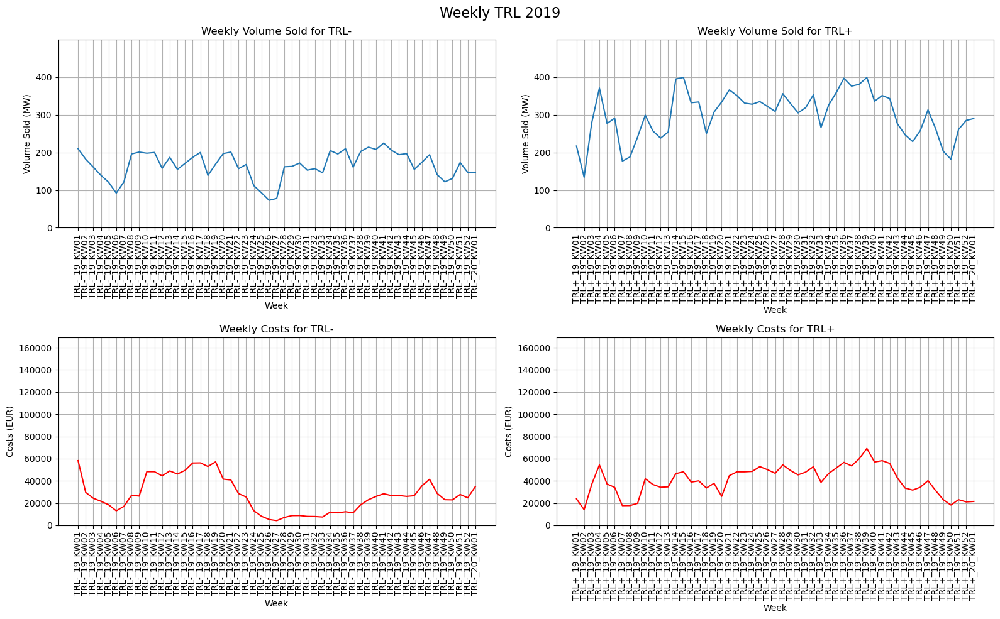

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW19.index, grouped_TPDW19['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW19.index, grouped_TPUW19['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW19.index, grouped_TPDW19['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW19.index, grouped_TPUW19['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2019', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2020

In [4]:
res20=pd.read_csv(DATA+'2020_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res20_CH=res20[res20.Pays=='CH']
print(res20_CH.Description.unique())
res20_CH

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_34624\40055532.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res20=pd.read_csv(DATA+'2020_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


['Primary control Auction' 'Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_20_01_01,Primary control Auction,16,MW,16,MW,50.00,EUR/MW,800.0,EUR,6.21,EUR/MWh*,CH,2.08,EUR/MWh*,Ja
1,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
2,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
3,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
4,PRL_20_01_01,Primary control Auction,1,MW,1,MW,120.00,EUR/MW,120.0,EUR,6.21,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
882783,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,14.00,CHF/MW,0.0,CHF,3.50,CHF/MWh*,CH,3.50,CHF/MWh*,NaN
882784,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,20.00,CHF/MW,0.0,CHF,5.00,CHF/MWh*,CH,5.00,CHF/MWh*,NaN
882785,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,2.16,CHF/MW,21.6,CHF,0.54,CHF/MWh*,CH,0.54,CHF/MWh*,NaN
882786,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,50,MW,0,MW,25.00,CHF/MW,0.0,CHF,6.25,CHF/MWh*,CH,6.25,CHF/MWh*,NaN


## Primary control Auction 2020

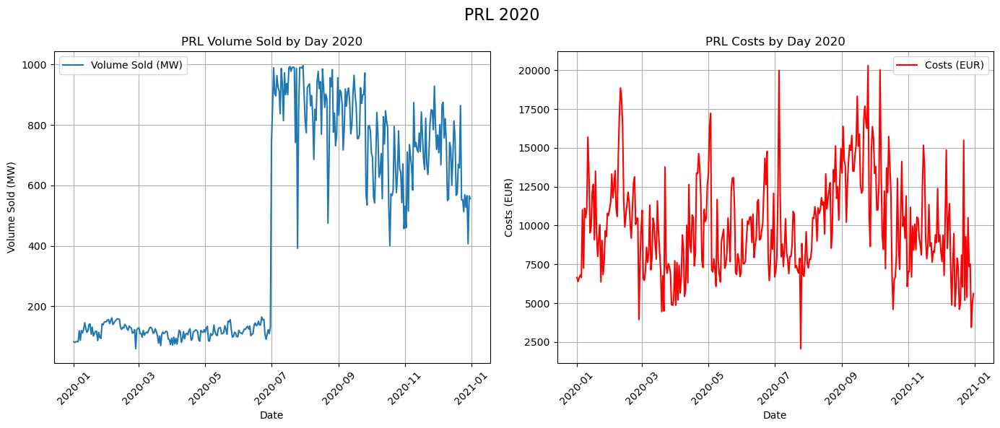

In [5]:
res20_CH_p=res20_CH[res20_CH['Description'].str.contains('Primary control')].copy()

res20_CH_p['date'] = pd.to_datetime(res20_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p20 = res20_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p20.index, grouped_p20['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2020')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p20.index, grouped_p20['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2020')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2020', fontsize=16)
plt.tight_layout()
plt.show()

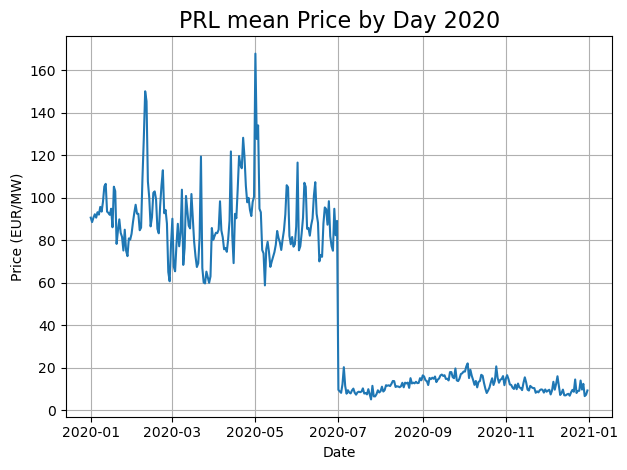

In [6]:
plt.plot(grouped_p20.index, grouped_p20['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2020', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/PRL_mean_price_2020.pdf', format='pdf')

plt.show()



In [7]:
grouped_p20['Prix_prestation'].describe()

count    366.000000
mean      50.321159
std       40.486072
min        5.087919
25%       11.741109
50%       21.351217
75%       86.756365
max      167.831373
Name: Prix_prestation, dtype: float64

In [8]:
PRL20_0_4=res20_CH_p[res20_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL20_4_8=res20_CH_p[res20_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL20_8_12=res20_CH_p[res20_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL20_12_16=res20_CH_p[res20_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL20_16_20=res20_CH_p[res20_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL20_20_24=res20_CH_p[res20_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL20_0_4=PRL20_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_4_8=PRL20_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_8_12=PRL20_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_12_16=PRL20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_16_20=PRL20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_20_24=PRL20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

max_volume=180, min volume= 47
max_cost=6525.5, min cost= 203.8


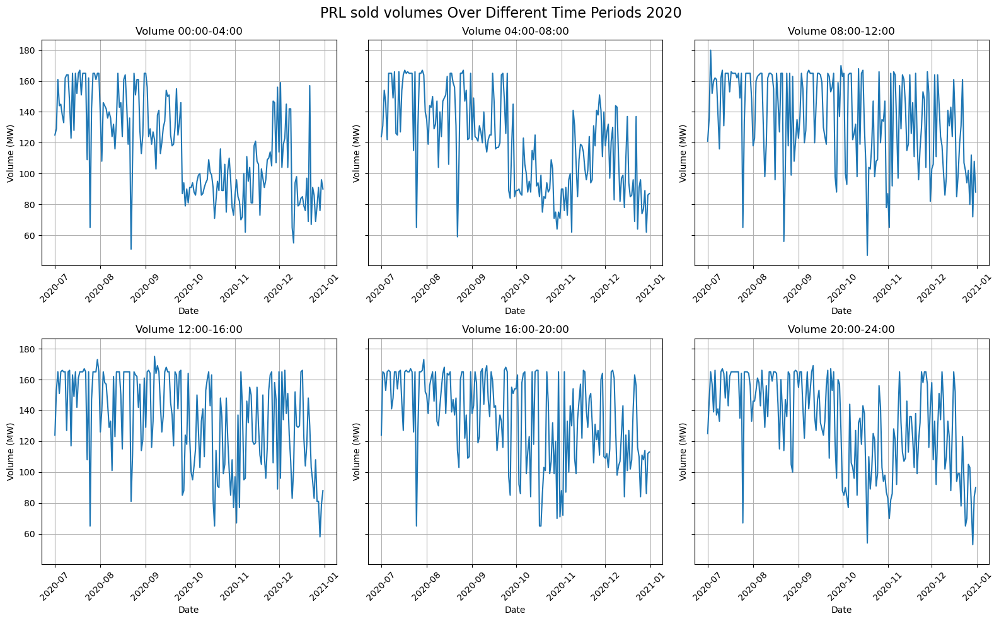

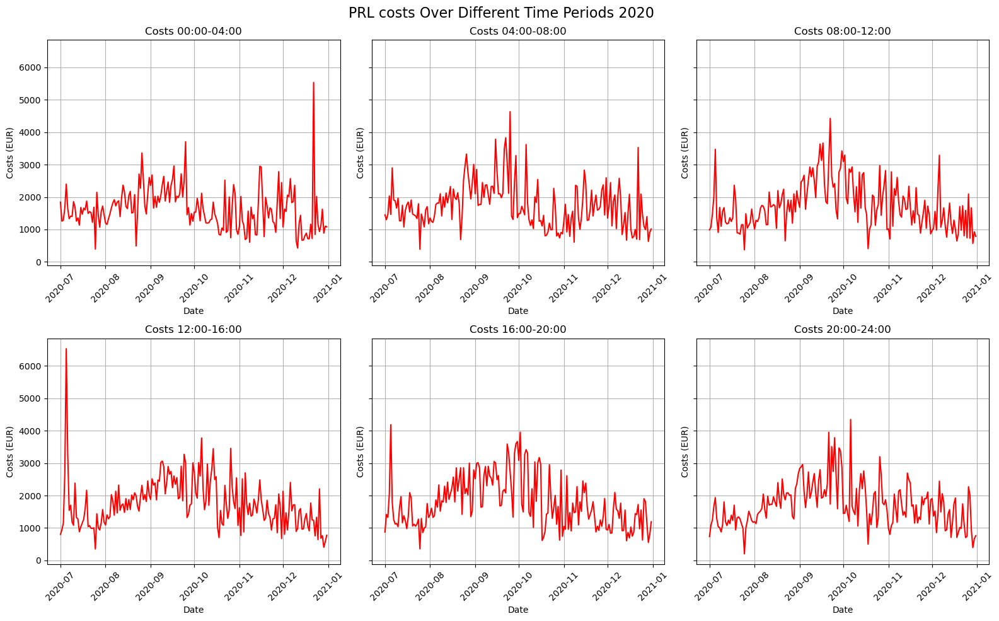

In [9]:
# Grouped data list and labels
grouped_p20 = [grouped_PRL20_0_4, grouped_PRL20_4_8, grouped_PRL20_8_12, grouped_PRL20_12_16, grouped_PRL20_16_20, grouped_PRL20_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p20])
min_cost = min([data['Coûts'].min() for data in grouped_p20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

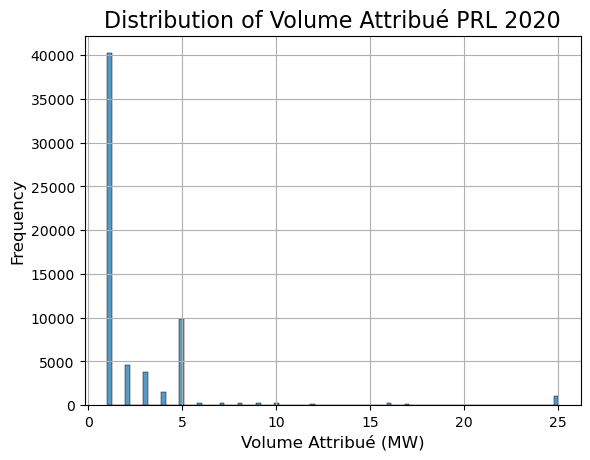

In [10]:
#plt.figure(figsize=(10, 6))
sns.histplot(res20_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2020', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/PRL_volume_2020.pdf', format='pdf')
plt.show()

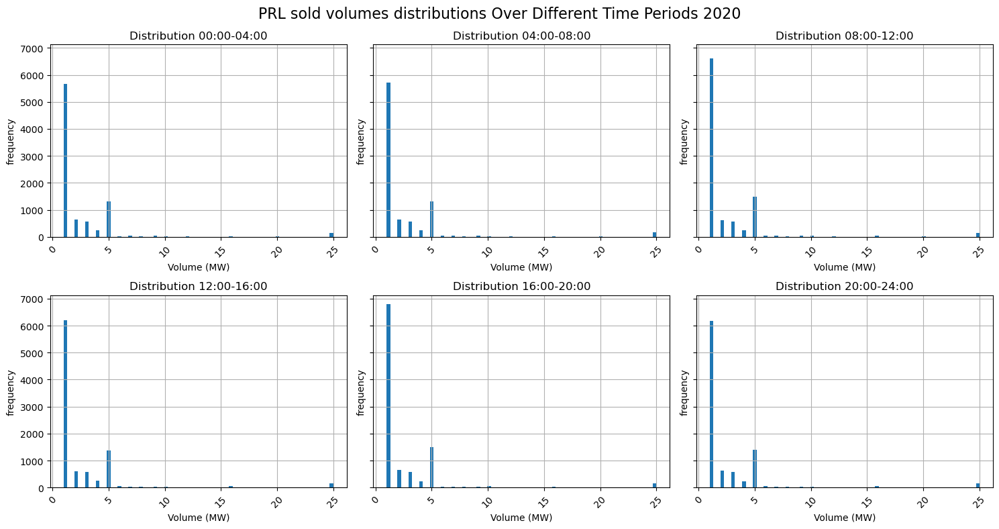

In [11]:

list_PRL20 = [PRL20_0_4, PRL20_4_8, PRL20_8_12, PRL20_12_16, PRL20_16_20, PRL20_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/PRL_volume_distributions_2020.pdf', format='pdf')
plt.show()

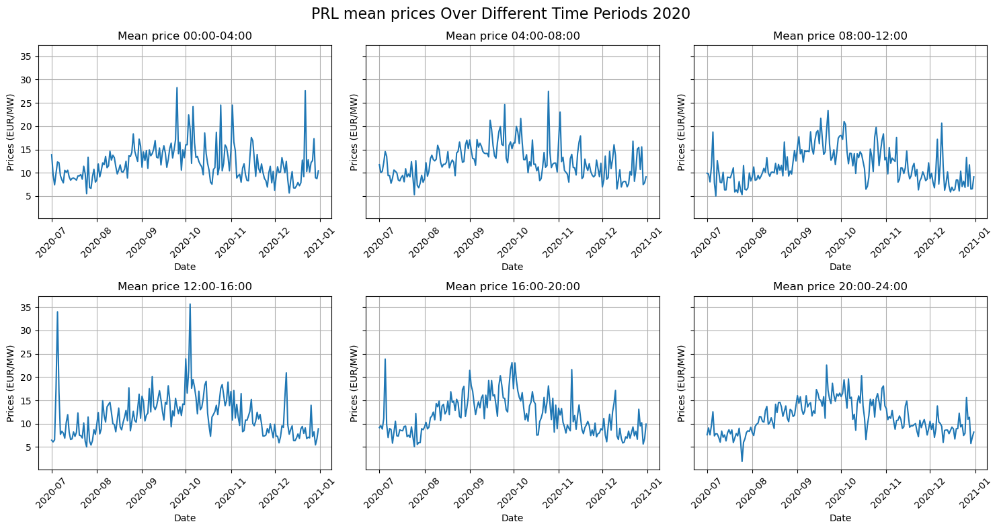

count    184.000000
mean      12.039250
std        3.794585
min        5.510345
25%        9.392648
50%       11.366174
75%       13.800259
max       28.263731
Name: Prix_prestation, dtype: float64
count    184.000000
mean      12.400135
std        3.585600
min        5.296429
25%        9.520629
50%       12.098718
75%       14.552670
max       27.484848
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.531120
std        3.865965
min        5.032222
25%        8.675246
50%       10.815997
75%       14.111130
max       23.340806
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.707434
std        4.508391
min        5.021429
25%        8.270978
50%       10.954441
75%       14.112469
max       35.670769
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.771464
std        4.028880
min        5.064286
25%        8.687725
50%       11.165206
75%       14.519839
max       23.869481
Name: Prix_prestation, dtype: float64
count    1

In [12]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/PRL_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_p20:
    print(group['Prix_prestation'].describe())

## Secondary control auction 2020

In [13]:
# Create DataFrame for Secondary control
res20_CH_s = res20_CH[res20_CH['Description'].str.contains('Secondary control')].copy()

res20_CH_s['Week'] = res20_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL20m=res20_CH_s[res20_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL20p=res20_CH_s[res20_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL20m=SRL20m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation': 'mean'})
grouped_SRL20p=SRL20p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation': 'mean'})

grouped_SRL20=[grouped_SRL20m, grouped_SRL20p]

In [14]:
SRL20m

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,Week
817545,SRL_20_KW01,Secondary control Auction SRL-,20,MW,20,MW,3025.0,CHF/MW,60500.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817546,SRL_20_KW01,Secondary control Auction SRL-,10,MW,10,MW,3025.0,CHF/MW,30250.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817547,SRL_20_KW01,Secondary control Auction SRL-,6,MW,6,MW,3025.0,CHF/MW,18150.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817548,SRL_20_KW01,Secondary control Auction SRL-,5,MW,5,MW,3192.0,CHF/MW,15960.0,CHF,19.00,CHF/MWh*,CH,19.00,CHF/MWh*,NaN,SRL_20_KW01
817549,SRL_20_KW01,Secondary control Auction SRL-,5,MW,5,MW,2688.0,CHF/MW,13440.0,CHF,16.00,CHF/MWh*,CH,16.00,CHF/MWh*,NaN,SRL_20_KW01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
819111,SRL_20_KW53,Secondary control Auction SRL-,10,MW,10,MW,2455.0,CHF/MW,24550.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819112,SRL_20_KW53,Secondary control Auction SRL-,10,MW,10,MW,2455.0,CHF/MW,24550.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819113,SRL_20_KW53,Secondary control Auction SRL-,6,MW,6,MW,2455.0,CHF/MW,14730.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819114,SRL_20_KW53,Secondary control Auction SRL-,5,MW,5,MW,2455.0,CHF/MW,12275.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53


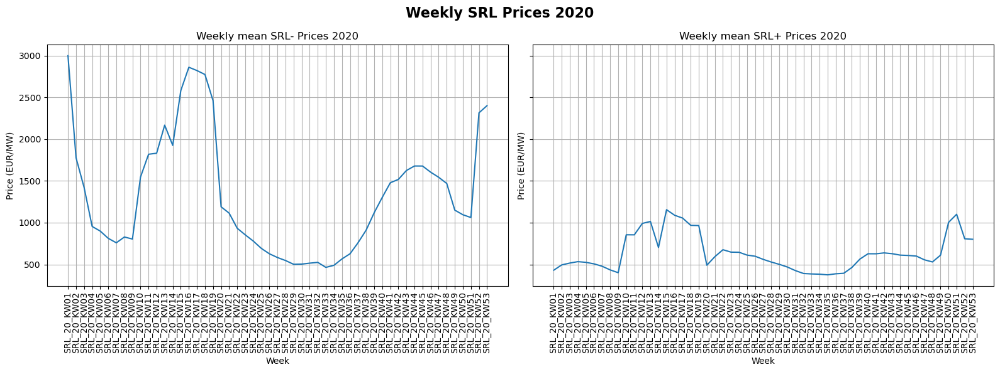

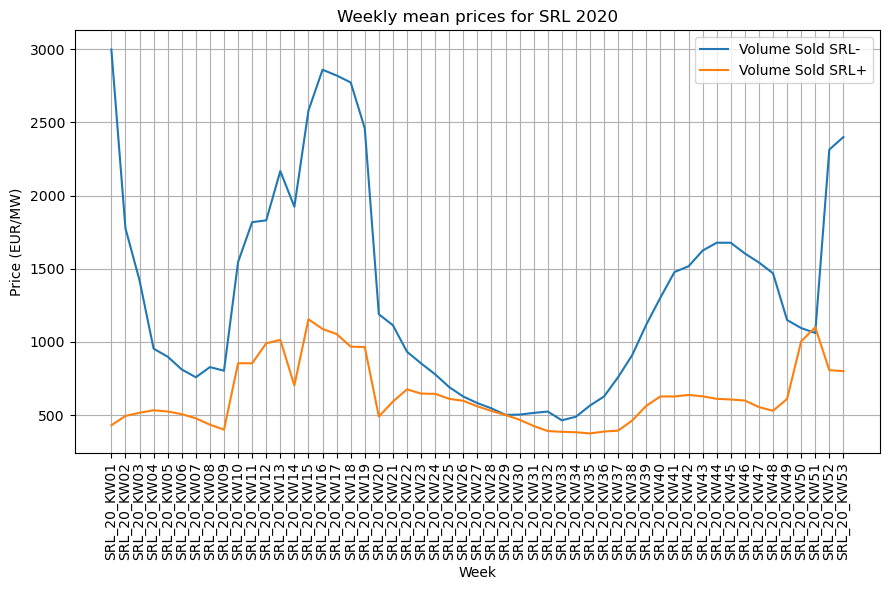

desription of SRL- prices:
 count      53.000000
mean     1325.482764
std       719.201391
min       464.923077
25%       760.218182
50%      1119.095238
75%      1678.178000
max      2997.866667
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean      638.068242
std       216.870369
min       375.480000
25%       490.438571
50%       598.120000
75%       703.363636
max      1155.240000
Name: Prix_prestation, dtype: float64


In [15]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL20m.index, grouped_SRL20m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2020')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL20p.index, grouped_SRL20p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2020')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2020', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig('./gfx/Weekly_SRL_Prices_2020.pdf', format='pdf')
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL20m.index, grouped_SRL20m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL20p.index, grouped_SRL20p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2020')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/Weekly_SRL_Prices_combined_2020.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL20m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL20p["Prix_prestation"].describe()}')


max_volume=446, min volume= 361
max_cost=1234101.5, min cost= 139319.72


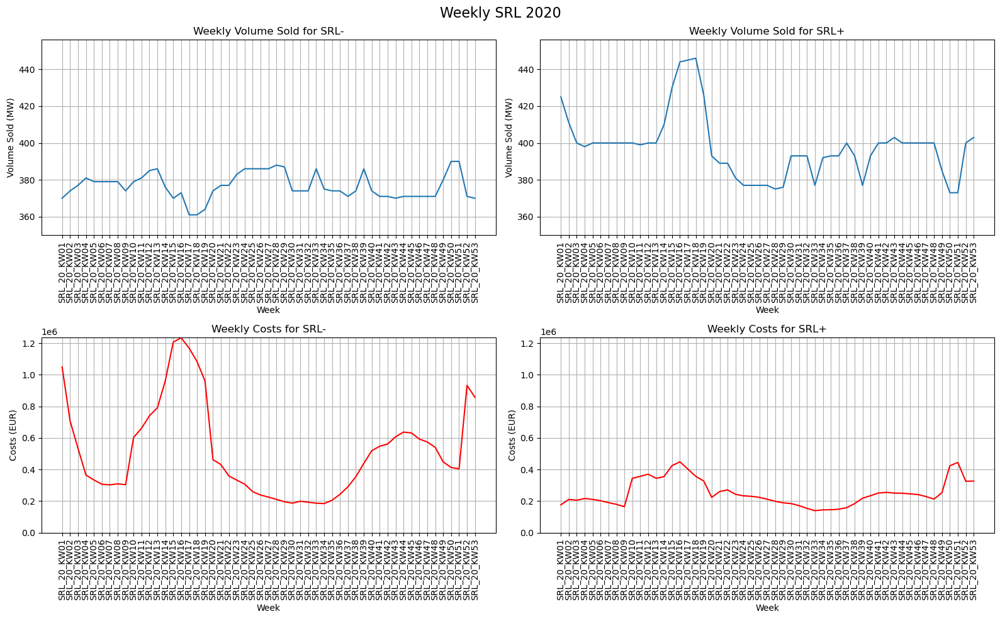

In [16]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL20])
min_cost = min([data['Coûts'].min() for data in grouped_SRL20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL20m.index, grouped_SRL20m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL20p.index, grouped_SRL20p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL20m.index, grouped_SRL20m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL20p.index, grouped_SRL20p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2020', fontsize=16)
plt.tight_layout()
plt.show()


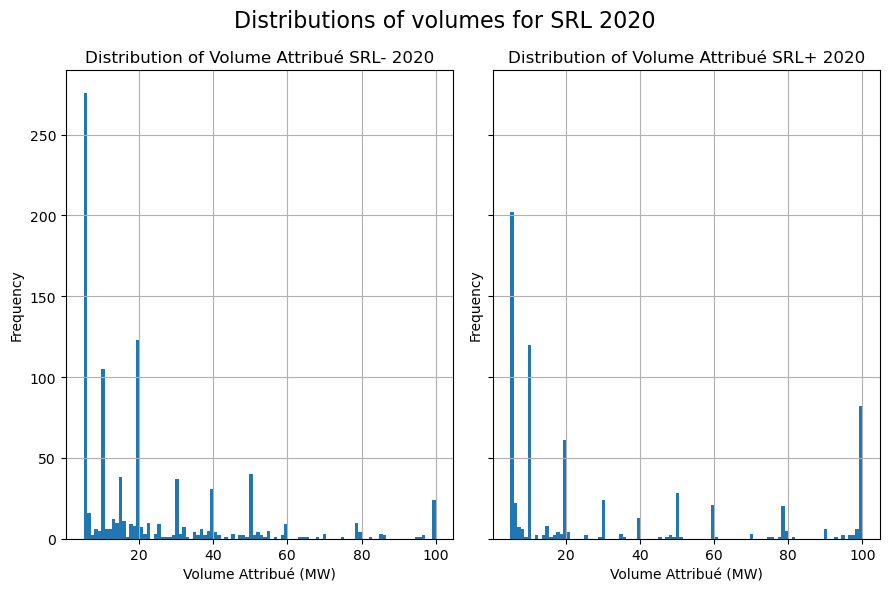

In [17]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True) #
axes[0].hist(SRL20m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2020')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL20p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2020')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/SRL_dist_2020.pdf', format='pdf')
plt.show()

## Tertiary control auction 2020

In [18]:
# Create DataFrame for Tertiary control
res20_CH_t = res20_CH[res20_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW20=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW20=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP'].copy()
TPD20_00_04=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD20_04_08=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD20_08_12=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD20_12_16=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD20_16_20=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD20_20_24=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU20_00_04=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU20_04_08=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU20_08_12=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU20_12_16=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU20_16_20=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU20_20_24=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW20['Week']=TPDW20['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW20['Week']=TPUW20['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW20=TPDW20.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPUW20=TPUW20.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

TPD20_00_04['date'] = pd.to_datetime(TPD20_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_04_08['date'] = pd.to_datetime(TPD20_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_08_12['date'] = pd.to_datetime(TPD20_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_12_16['date'] = pd.to_datetime(TPD20_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_16_20['date'] = pd.to_datetime(TPD20_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_20_24['date'] = pd.to_datetime(TPD20_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU20_00_04['date'] = pd.to_datetime(TPU20_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_04_08['date'] = pd.to_datetime(TPU20_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_08_12['date'] = pd.to_datetime(TPU20_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_12_16['date'] = pd.to_datetime(TPU20_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_16_20['date'] = pd.to_datetime(TPU20_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_20_24['date'] = pd.to_datetime(TPU20_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD20_00_04=TPD20_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_04_08=TPD20_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_08_12=TPD20_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_12_16=TPD20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_16_20=TPD20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_20_24=TPD20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_TPU20_00_04=TPU20_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_04_08=TPU20_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_08_12=TPU20_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_12_16=TPU20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_16_20=TPU20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_20_24=TPU20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD20 = [grouped_TPD20_00_04, grouped_TPD20_04_08, grouped_TPD20_08_12, grouped_TPD20_12_16, grouped_TPD20_16_20, grouped_TPD20_20_24]

grouped_TPU20 = [grouped_TPU20_00_04, grouped_TPU20_04_08, grouped_TPU20_08_12, grouped_TPU20_12_16, grouped_TPU20_16_20, grouped_TPU20_20_24]

grouped_TPW20=[grouped_TPDW20, grouped_TPUW20]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

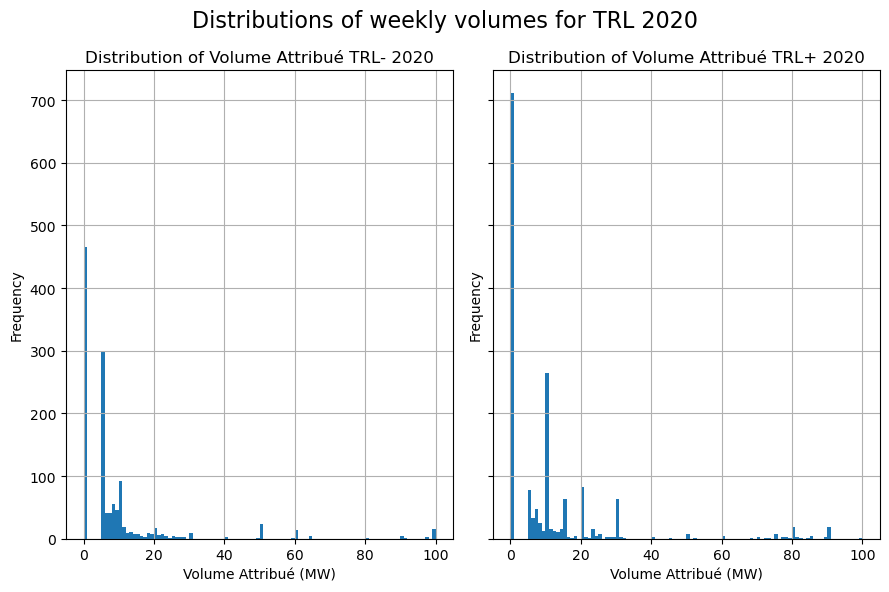

In [19]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)  

axes[0].hist(TPDW20['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2020')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW20['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2020')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/TRL_dist_2020.pdf', format='pdf')
plt.show()


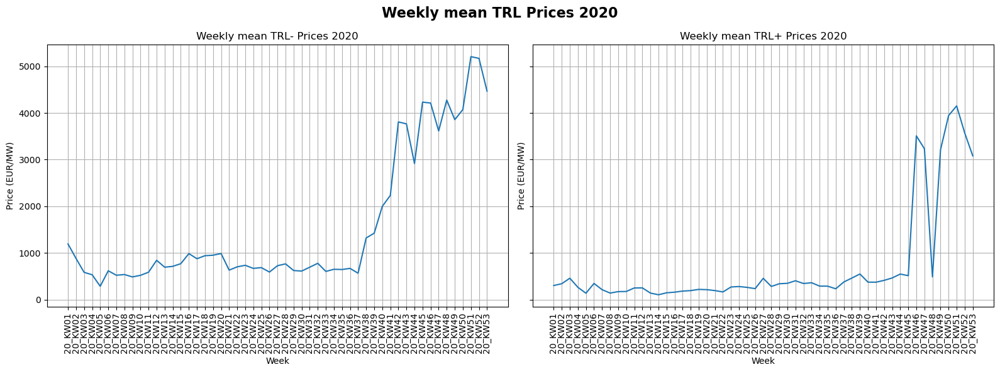

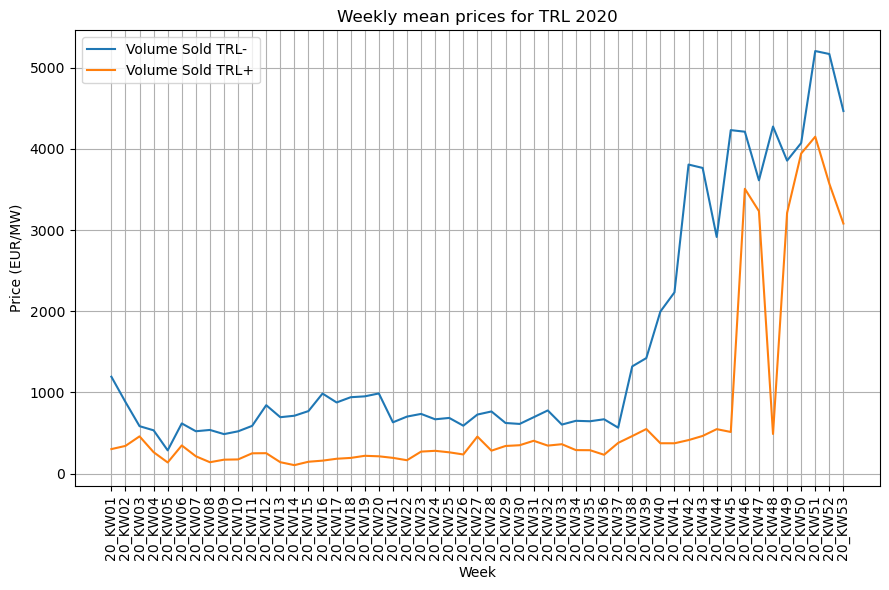

desription of TRL- prices:
 count      53.000000
mean     1555.983235
std      1474.828555
min       286.696667
25%       624.024138
50%       766.125806
75%      1997.439091
max      5207.009524
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean      725.666143
std      1118.106309
min       104.677857
25%       213.967333
50%       302.462500
75%       459.262857
max      4151.574643
Name: Prix_prestation, dtype: float64


In [20]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW20.index, grouped_TPDW20['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2020')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW20.index, grouped_TPUW20['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2020')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2020', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW20.index, grouped_TPDW20['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW20.index, grouped_TPUW20['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2020')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/Weekly_TRL_Prices_combined_2020.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW20["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW20["Prix_prestation"].describe()}')

In [ ]:
list_TPD20 = [TPD20_00_04, TPD20_04_08, TPD20_08_12, TPD20_12_16, TPD20_16_20, TPD20_20_24]

list_TPU20 = [TPU20_00_04, TPU20_04_08, TPU20_08_12, TPU20_12_16, TPU20_16_20, TPU20_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/TRL-_dist_daily_2020.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/TRL+_dist_daily_2020.pdf', format='pdf')
plt.show()

max_volume=214, min volume= 0
max_cost=20027.7, min cost= 0.0


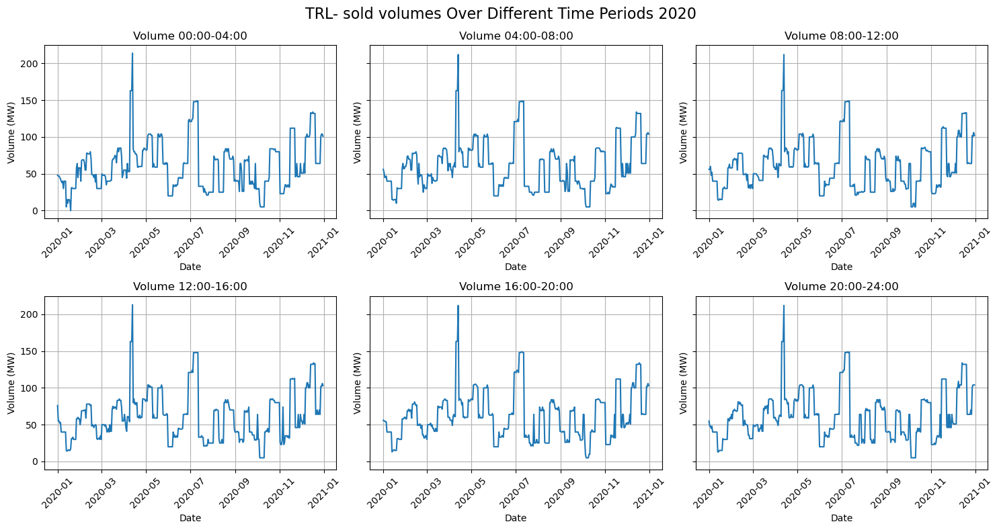

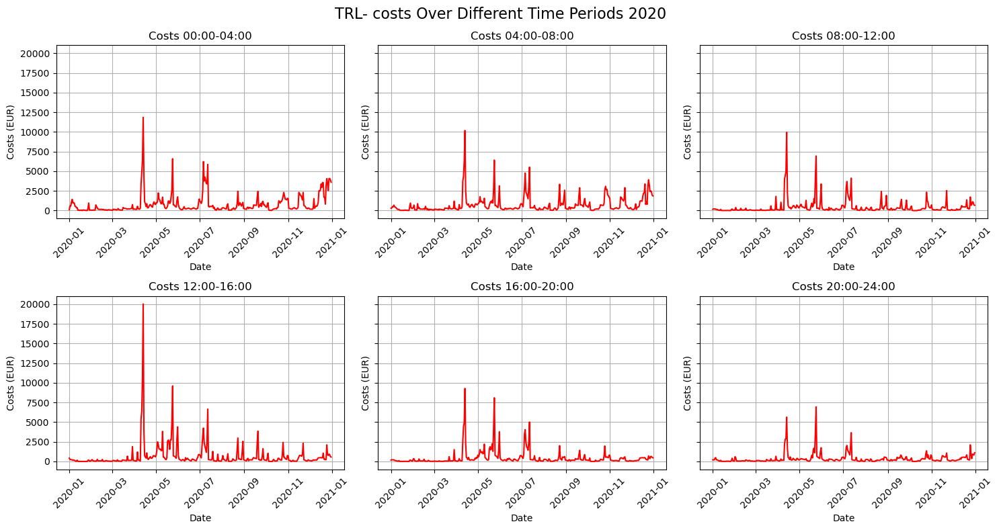

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD20])
min_cost = min([data['Coûts'].min() for data in grouped_TPD20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()


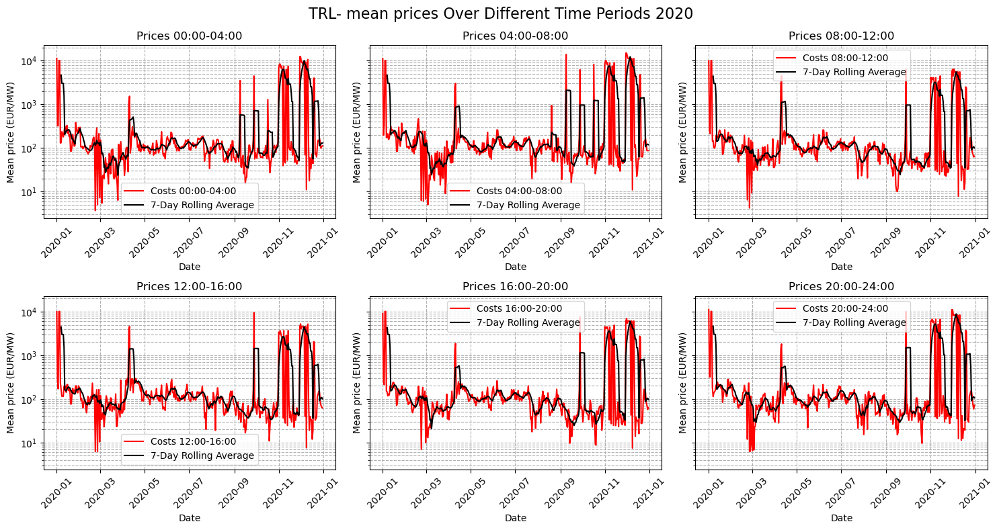

count      366.000000
mean       699.988282
std       2173.973956
min          3.680000
25%         68.905641
50%        101.285667
75%        151.377292
max      12483.318333
Name: Prix_prestation, dtype: float64

count      366.000000
mean       860.789443
std       2660.287008
min          5.015714
25%         66.805000
50%        103.179167
75%        157.009265
max      14988.103333
Name: Prix_prestation, dtype: float64

count      366.000000
mean       468.929987
std       1432.528115
min          4.220000
25%         52.576250
50%         91.243750
75%        134.796676
max      10141.365556
Name: Prix_prestation, dtype: float64

count      366.000000
mean       444.823505
std       1362.764180
min          6.214444
25%         55.594000
50%         96.523375
75%        146.457458
max      10133.848889
Name: Prix_prestation, dtype: float64

count      366.000000
mean       480.813453
std       1487.729468
min          6.994000
25%         49.359231
50%         88.371250
75%     

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPD20):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/TRL-_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_TPD20:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=390, min volume= 5
max_cost=17154.13, min cost= 0.0


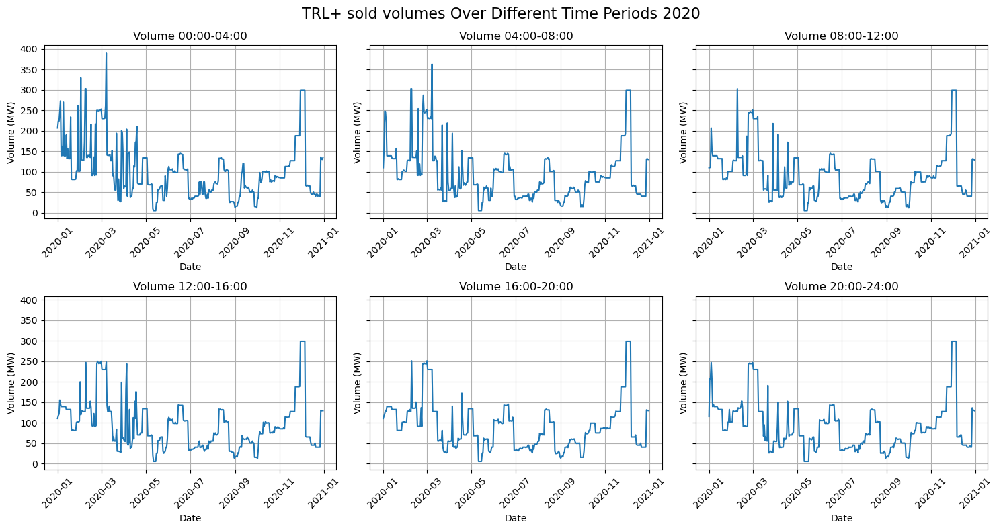

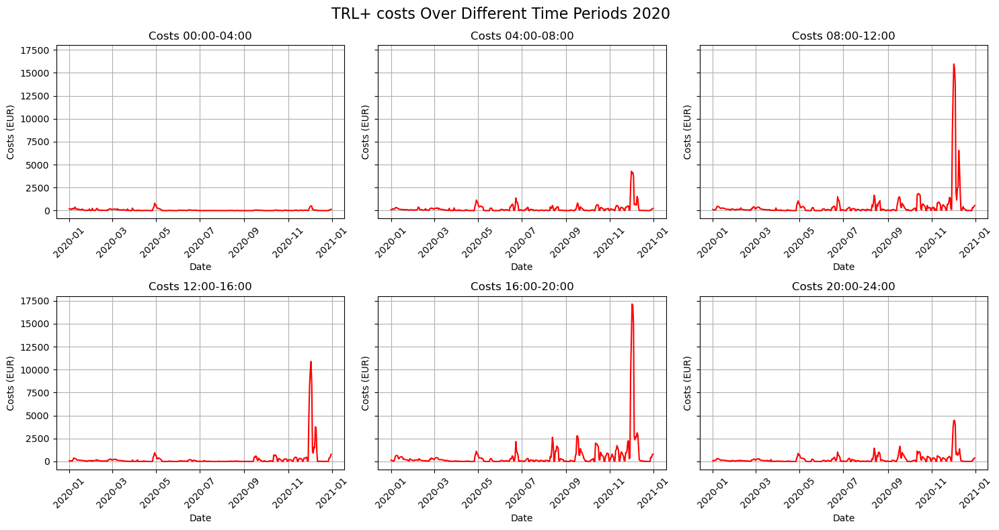

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPU20])
min_cost = min([data['Coûts'].min() for data in grouped_TPU20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()


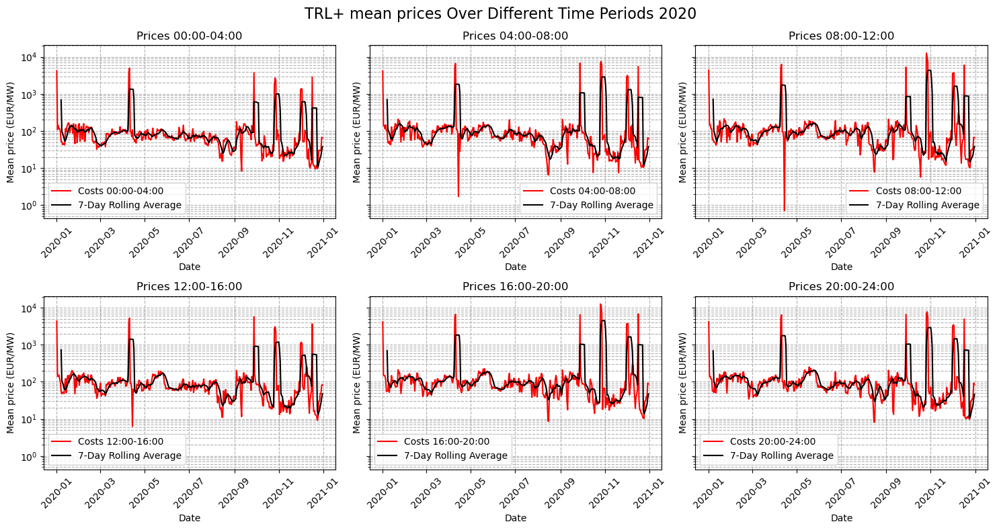

count     366.000000
mean      150.258828
std       508.522506
min         8.328333
25%        43.476562
50%        65.239167
75%        94.958039
max      4975.478095
Name: Prix_prestation, dtype: float64

count     366.000000
mean      232.765211
std       925.766324
min         1.703750
25%        43.876024
50%        73.774345
75%       113.437619
max      7475.582222
Name: Prix_prestation, dtype: float64

count      366.000000
mean       269.691774
std       1153.797138
min          0.710000
25%         46.581584
50%         82.838292
75%        120.805952
max      12644.134286
Name: Prix_prestation, dtype: float64

count     366.000000
mean      172.172571
std       592.462818
min         6.310000
25%        48.511132
50%        78.323462
75%       109.214430
max      5704.338462
Name: Prix_prestation, dtype: float64

count      366.000000
mean       284.800349
std       1220.693022
min          8.604091
25%         55.101912
50%         87.627864
75%        121.566667
max      1

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPU20):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/TRL+_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_TPU20:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=396, min volume= 81
max_cost=144086.3, min cost= 6233.66


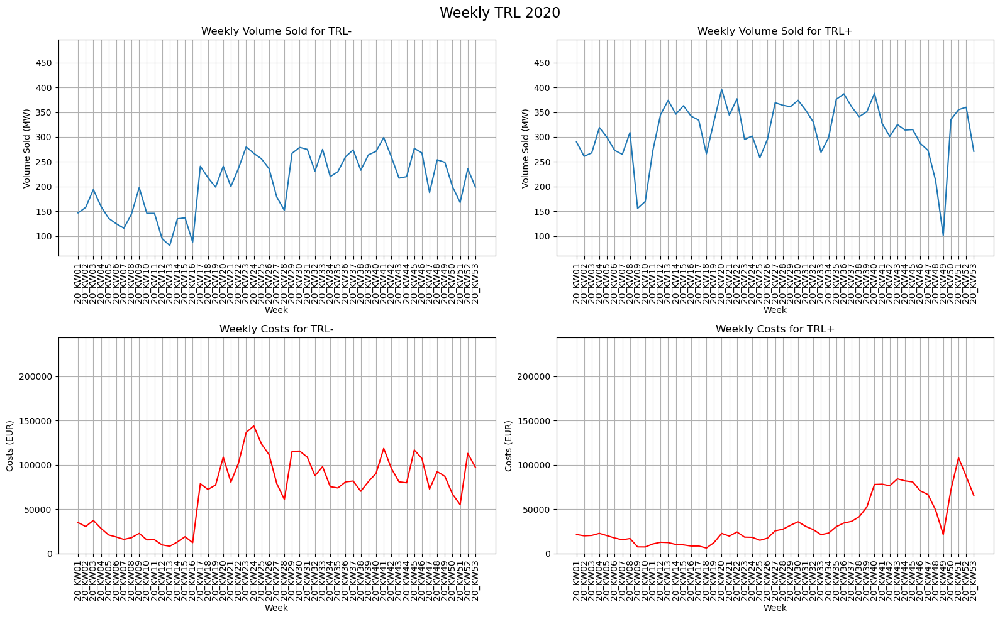

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW20])
min_cost = min([data['Coûts'].min() for data in grouped_TPW20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (60, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW20.index, grouped_TPDW20['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW20.index, grouped_TPUW20['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW20.index, grouped_TPDW20['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW20.index, grouped_TPUW20['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2020', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2021

In [ ]:
res21=pd.read_csv(DATA+'2021_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
print(res21.Description.unique())   
res21

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\1096773413.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res21=pd.read_csv(DATA+'2021_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
1,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
2,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
3,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
4,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
827223,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.68,CHF/MW,0.0,CHF,1.42,CHF/MWh*,CH,1.42,CHF/MWh*,NaN
827224,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN
827225,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,6.88,CHF/MW,0.0,CHF,1.72,CHF/MWh*,CH,1.72,CHF/MWh*,NaN
827226,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN


In [ ]:
res21_CH=res21[res21.Pays=='CH']
res21_CH

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
1,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
2,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
3,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
4,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
827223,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.68,CHF/MW,0.0,CHF,1.42,CHF/MWh*,CH,1.42,CHF/MWh*,NaN
827224,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN
827225,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,6.88,CHF/MW,0.0,CHF,1.72,CHF/MWh*,CH,1.72,CHF/MWh*,NaN
827226,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN


## primary control auction 2021

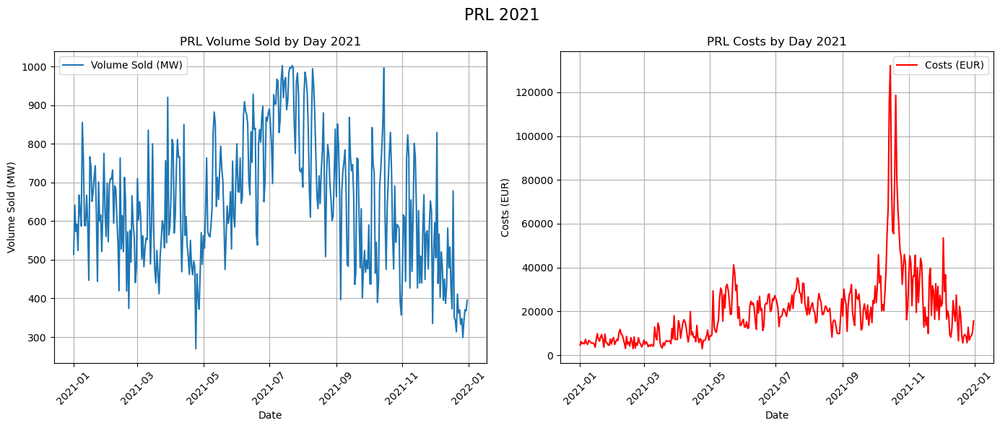

In [ ]:
res21_CH_p=res21_CH[res21_CH['Description'].str.contains('Primary control')].copy()

res21_CH_p['date'] = pd.to_datetime(res21_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p21 = res21_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p21.index, grouped_p21['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2021')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p21.index, grouped_p21['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2021')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2021', fontsize=16)
plt.tight_layout()
plt.show()

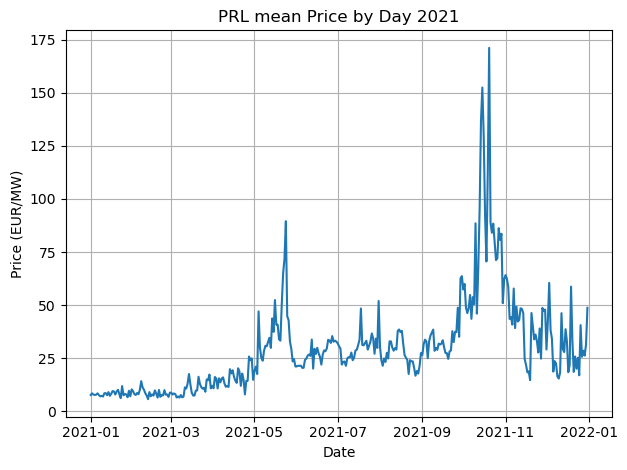

desription of PRL prices:
 count    365.000000
mean      29.311067
std       22.394273
min        5.786590
25%       13.208427
50%       25.712125
75%       34.352359
max      171.095449
Name: Prix_prestation, dtype: float64



In [ ]:
plt.plot(grouped_p21.index, grouped_p21['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2021')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print(f'desription of PRL prices:\n {grouped_p21["Prix_prestation"].describe()}\n')

In [ ]:
PRL21_0_4=res21_CH_p[res21_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL21_4_8=res21_CH_p[res21_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL21_8_12=res21_CH_p[res21_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL21_12_16=res21_CH_p[res21_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL21_16_20=res21_CH_p[res21_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL21_20_24=res21_CH_p[res21_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL21_0_4=PRL21_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_4_8=PRL21_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_8_12=PRL21_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_12_16=PRL21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_16_20=PRL21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_20_24=PRL21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

max_volume=176, min volume= 23
max_cost=43154.8, min cost= 167.5


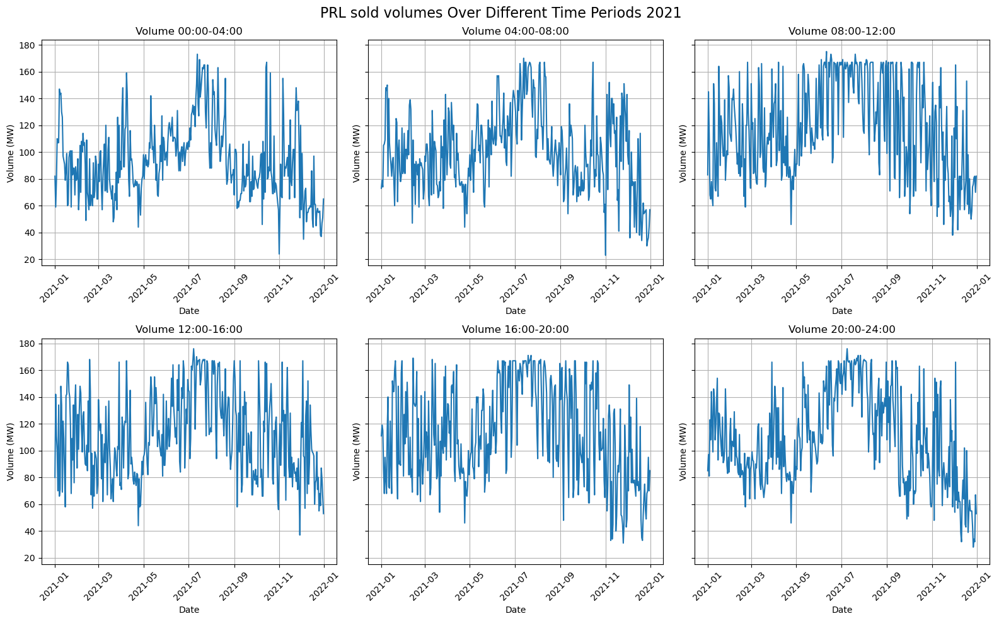

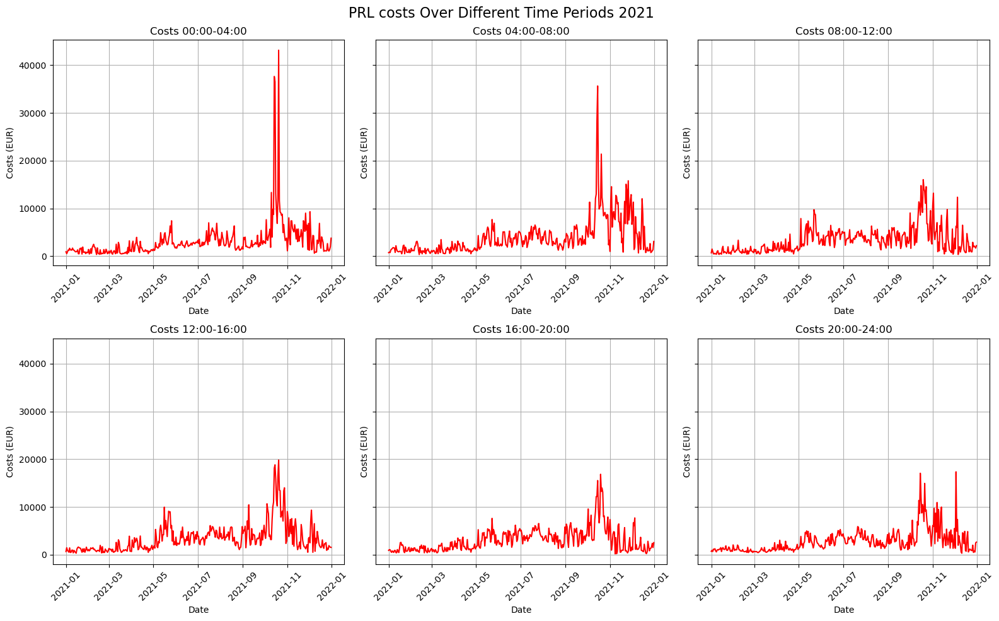

In [ ]:
# Grouped data list and labels
grouped_p21 = [grouped_PRL21_0_4, grouped_PRL21_4_8, grouped_PRL21_8_12, grouped_PRL21_12_16, grouped_PRL21_16_20, grouped_PRL21_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p21])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p21])
min_cost = min([data['Coûts'].min() for data in grouped_p21])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

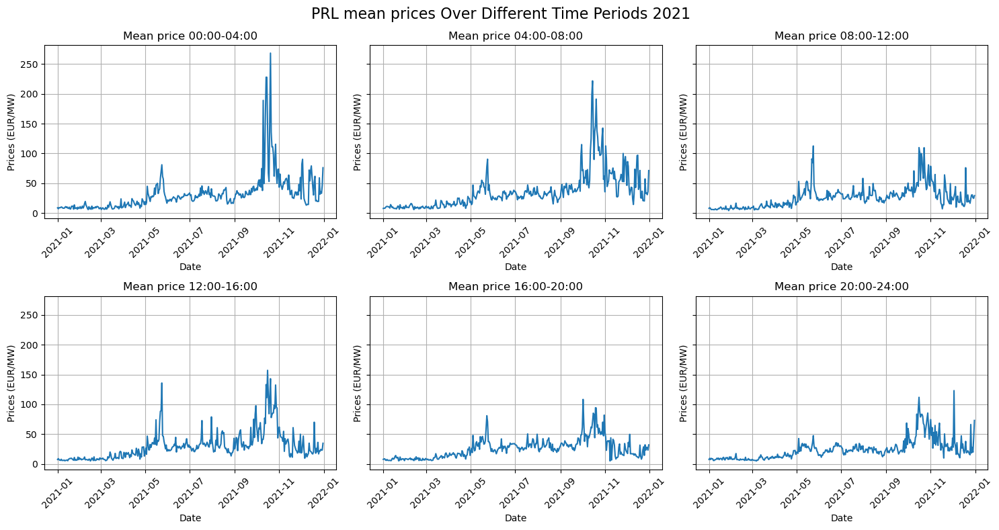

count    365.000000
mean      31.690213
std       31.110518
min        5.676923
25%       13.037778
50%       25.867188
75%       37.420000
max      268.394565
Name: Prix_prestation, dtype: float64
count    365.000000
mean      36.196112
std       31.172015
min        5.633333
25%       14.193750
50%       28.539394
75%       43.350000
max      221.756481
Name: Prix_prestation, dtype: float64
count    365.000000
mean      26.066145
std       18.351732
min        4.011522
25%       11.735091
50%       23.814615
75%       33.243478
max      112.491071
Name: Prix_prestation, dtype: float64
count    365.000000
mean      29.884737
std       24.557017
min        4.848846
25%       11.801316
50%       24.933333
75%       35.610000
max      157.093793
Name: Prix_prestation, dtype: float64
count    365.000000
mean      25.574314
std       16.846257
min        4.911111
25%       12.041584
50%       24.420615
75%       33.433704
max      108.240571
Name: Prix_prestation, dtype: float64
count    3

In [ ]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

for group in grouped_p21:
    print(group['Prix_prestation'].describe())

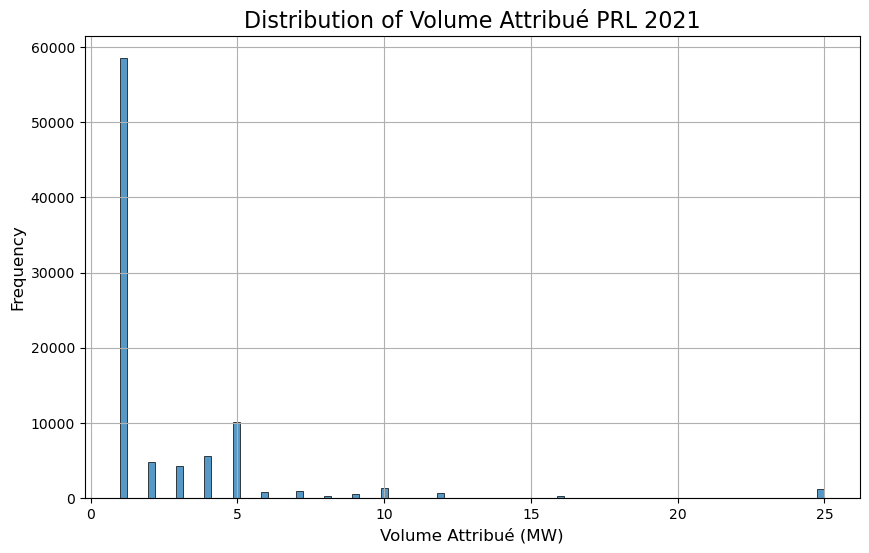

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(res21_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2021', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.show()

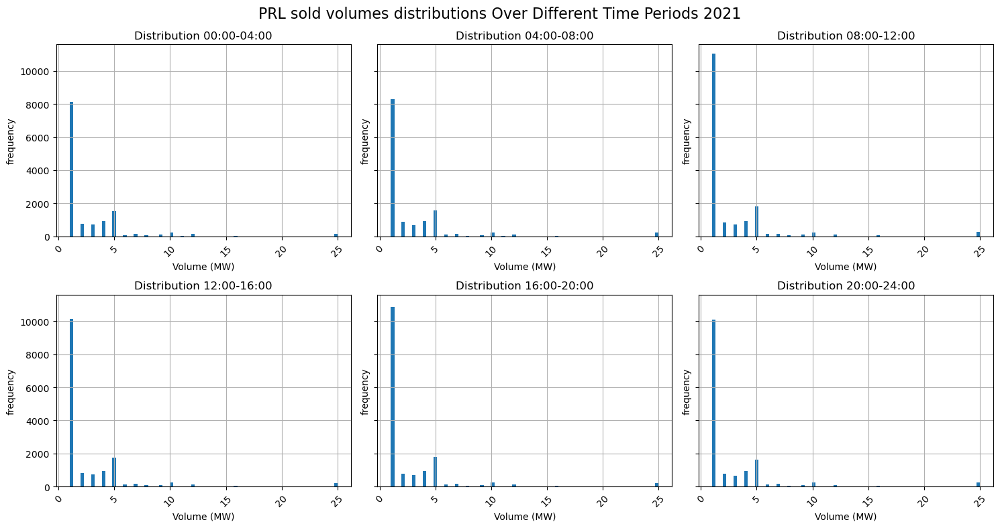

In [ ]:

list_PRL21 = [PRL21_0_4, PRL21_4_8, PRL21_8_12, PRL21_12_16, PRL21_16_20, PRL21_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
# plot(res21_CH_p, 'PRL', '2021', 'PRL 2021', 'daily', figure_size=(14,6))

## Secondary control Auction 2021

In [ ]:
# Create DataFrame for Secondary control
res21_CH_s = res21_CH[res21_CH['Description'].str.contains('Secondary control')].copy()

res21_CH_s['Week'] = res21_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL21m=res21_CH_s[res21_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL21p=res21_CH_s[res21_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL21m=SRL21m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL21p=SRL21p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL21=[grouped_SRL21m, grouped_SRL21p]

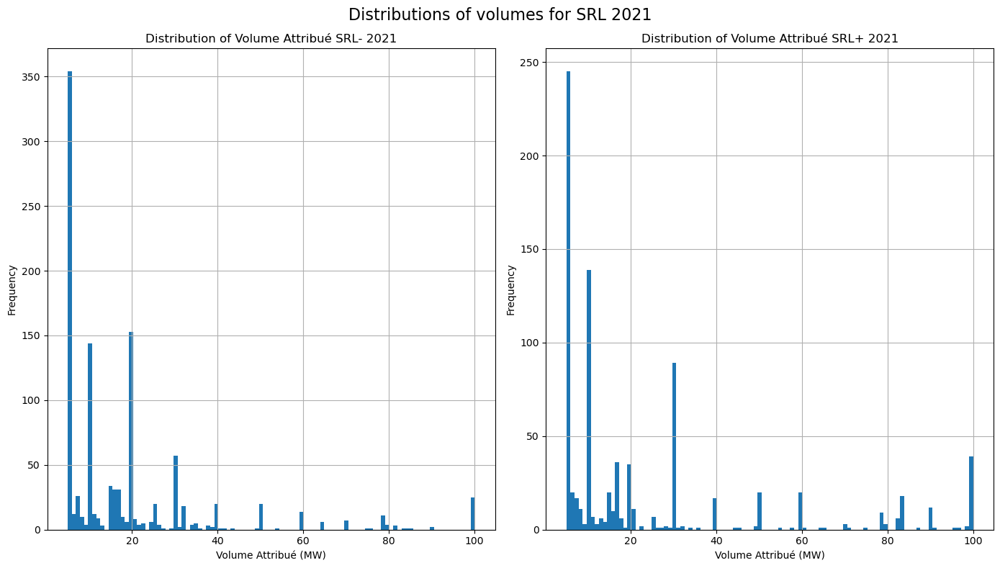

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8))
axes[0].hist(SRL21m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2021')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL21p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2021')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2021', fontsize=16)
plt.tight_layout()
plt.show()

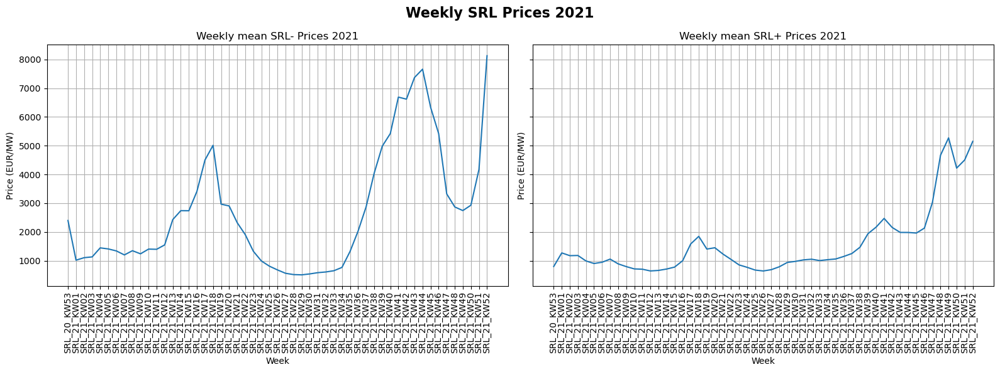

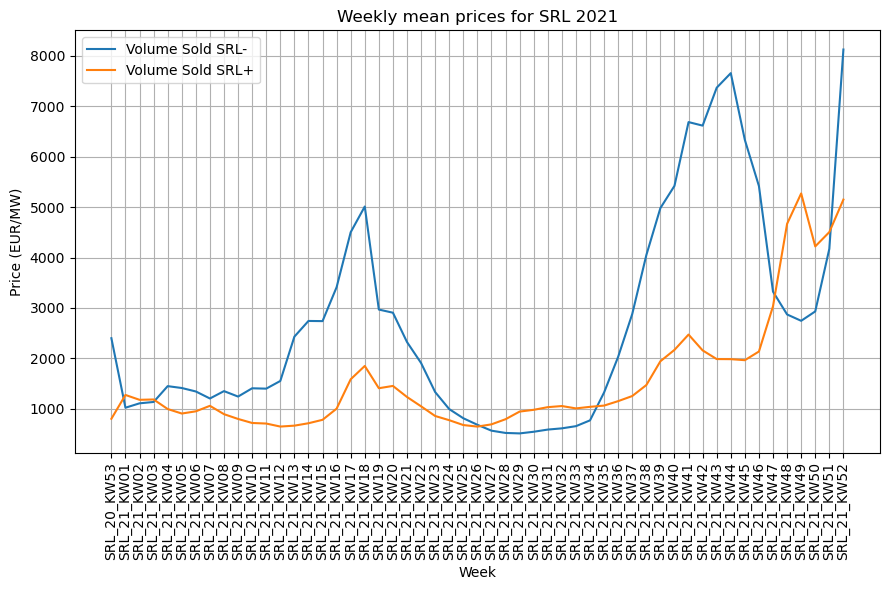

desription of SRL- prices:
 count      53.000000
mean     2688.627712
std      2098.616876
min       510.942667
25%      1134.841818
50%      2031.316923
75%      3412.619231
max      8128.352941
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean     1564.760997
std      1175.103388
min       645.875556
25%       856.290909
50%      1058.147368
75%      1942.523810
max      5272.637500
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL21m.index, grouped_SRL21m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2021')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL21p.index, grouped_SRL21p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2021')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2021', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL21m.index, grouped_SRL21m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL21p.index, grouped_SRL21p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2021')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL21m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL21p["Prix_prestation"].describe()}')


max_volume=500, min volume= 367
max_cost=3562446.2, min cost= 223684.4


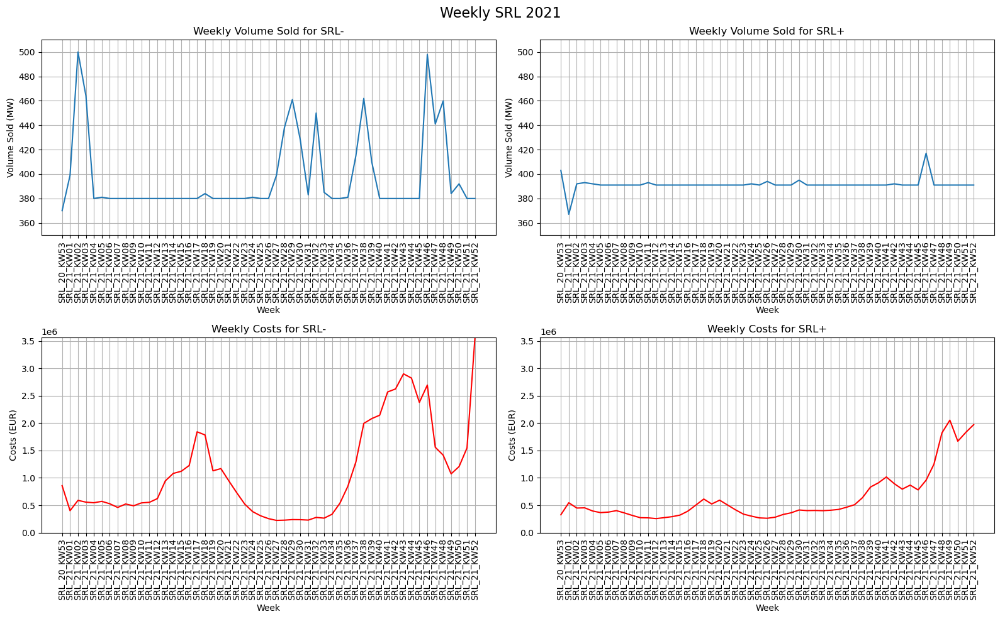

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL21])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL21])
min_cost = min([data['Coûts'].min() for data in grouped_SRL21])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL21m.index, grouped_SRL21m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL21p.index, grouped_SRL21p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL21m.index, grouped_SRL21m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL21p.index, grouped_SRL21p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2021', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2021

In [ ]:
# Create DataFrame for Tertiary control
res21_CH_t = res21_CH[res21_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW21=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW21=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP'].copy()
TPD21_00_04=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD21_04_08=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD21_08_12=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD21_12_16=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD21_16_20=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD21_20_24=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU21_00_04=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU21_04_08=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU21_08_12=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU21_12_16=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU21_16_20=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU21_20_24=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW21['Week']=TPDW21['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW21['Week']=TPUW21['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW21=TPDW21.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW21=TPUW21.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD21_00_04['date'] = pd.to_datetime(TPD21_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_04_08['date'] = pd.to_datetime(TPD21_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_08_12['date'] = pd.to_datetime(TPD21_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_12_16['date'] = pd.to_datetime(TPD21_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_16_20['date'] = pd.to_datetime(TPD21_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_20_24['date'] = pd.to_datetime(TPD21_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU21_00_04['date'] = pd.to_datetime(TPU21_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_04_08['date'] = pd.to_datetime(TPU21_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_08_12['date'] = pd.to_datetime(TPU21_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_12_16['date'] = pd.to_datetime(TPU21_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_16_20['date'] = pd.to_datetime(TPU21_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_20_24['date'] = pd.to_datetime(TPU21_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD21_00_04=TPD21_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_04_08=TPD21_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_08_12=TPD21_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_12_16=TPD21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_16_20=TPD21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_20_24=TPD21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU21_00_04=TPU21_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_04_08=TPU21_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_08_12=TPU21_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_12_16=TPU21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_16_20=TPU21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_20_24=TPU21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD21 = [grouped_TPD21_00_04, grouped_TPD21_04_08, grouped_TPD21_08_12, grouped_TPD21_12_16, grouped_TPD21_16_20, grouped_TPD21_20_24]

grouped_TPU21 = [grouped_TPU21_00_04, grouped_TPU21_04_08, grouped_TPU21_08_12, grouped_TPU21_12_16, grouped_TPU21_16_20, grouped_TPU21_20_24]

grouped_TPW21=[grouped_TPDW21, grouped_TPUW21]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

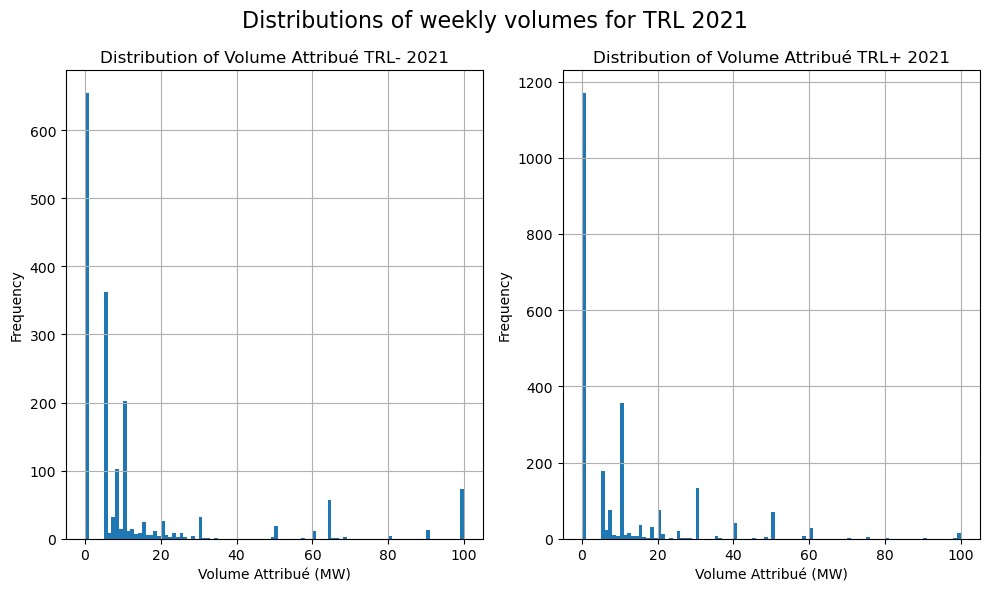

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6))  

axes[0].hist(TPDW21['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2021')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW21['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2021')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2021', fontsize=16)
plt.tight_layout()
plt.show()


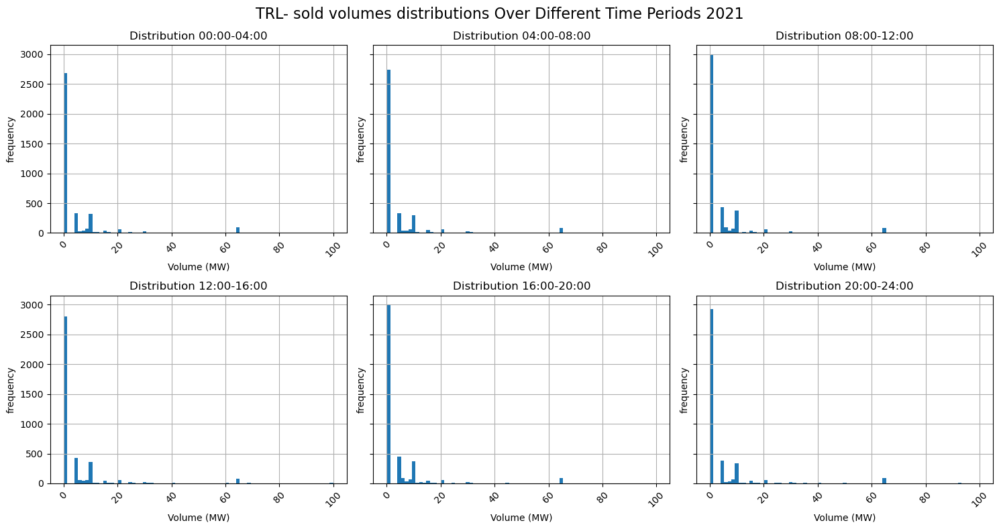

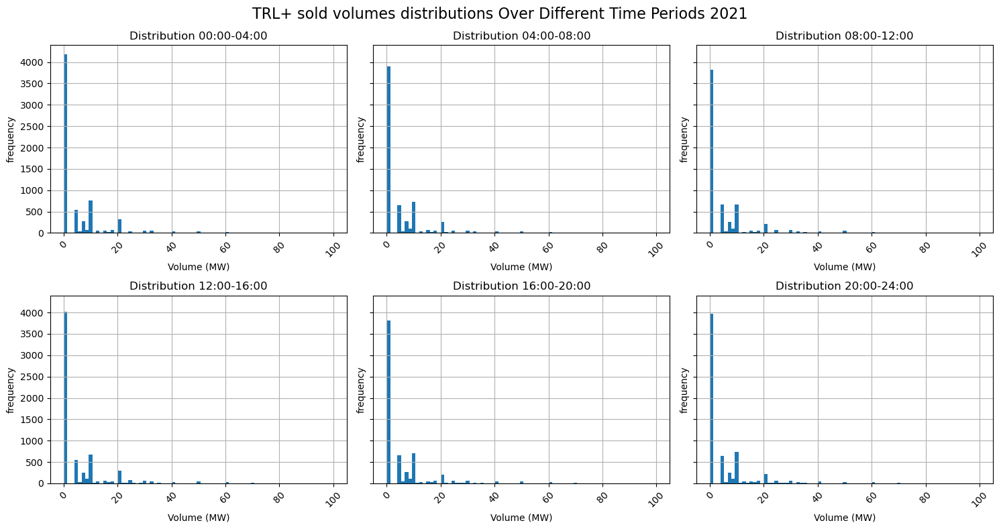

In [ ]:
list_TPD21 = [TPD21_00_04, TPD21_04_08, TPD21_08_12, TPD21_12_16, TPD21_16_20, TPD21_20_24]

list_TPU21 = [TPU21_00_04, TPU21_04_08, TPU21_08_12, TPU21_12_16, TPU21_16_20, TPU21_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=144
max_cost=71236.0


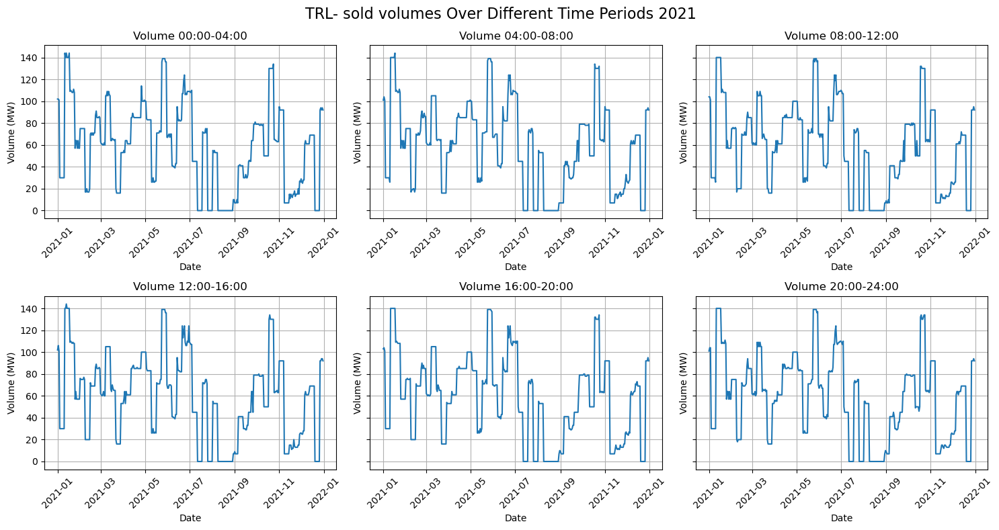

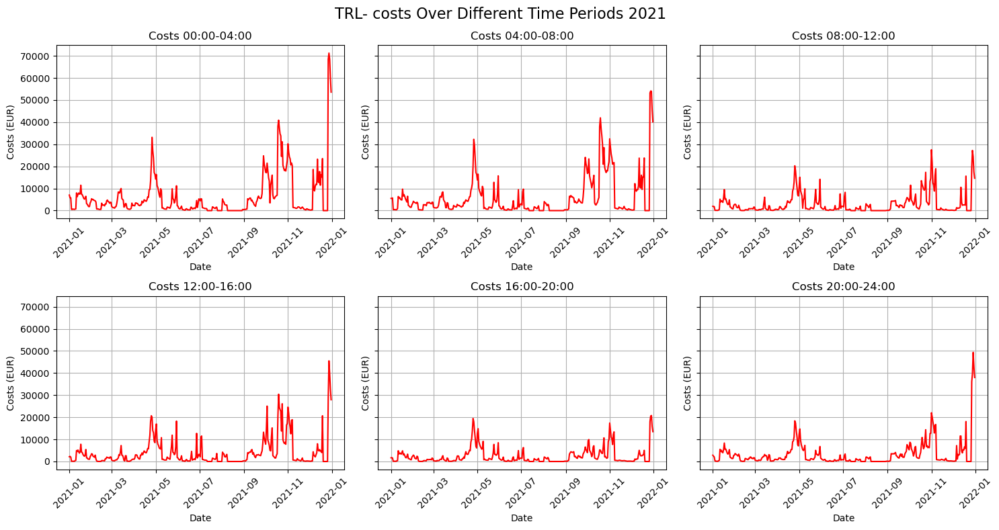

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()


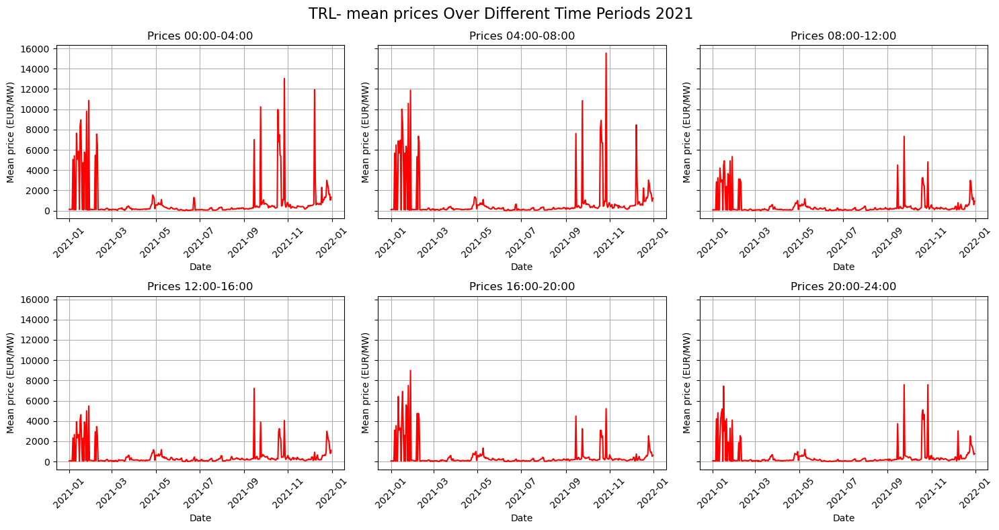

count      365.000000
mean       836.190055
std       1943.132706
min         12.199000
25%        119.054167
50%        217.070000
75%        496.307500
max      13042.675000
Name: Prix_prestation, dtype: float64

count      365.000000
mean       842.891708
std       2022.224224
min         15.120000
25%        113.912000
50%        234.066667
75%        493.106667
max      15535.706667
Name: Prix_prestation, dtype: float64

count     365.000000
mean      454.978068
std       944.925371
min         9.219130
25%        85.419286
50%       158.365000
75%       328.127273
max      7325.150000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      479.171104
std       898.730305
min        12.276842
25%       103.252308
50%       193.400000
75%       387.670000
max      7223.428571
Name: Prix_prestation, dtype: float64

count     365.000000
mean      487.157302
std      1146.038805
min         7.971304
25%        78.240000
50%       157.888889
75%       297.750000
max      

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPD21:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=263
max_cost=91375.4


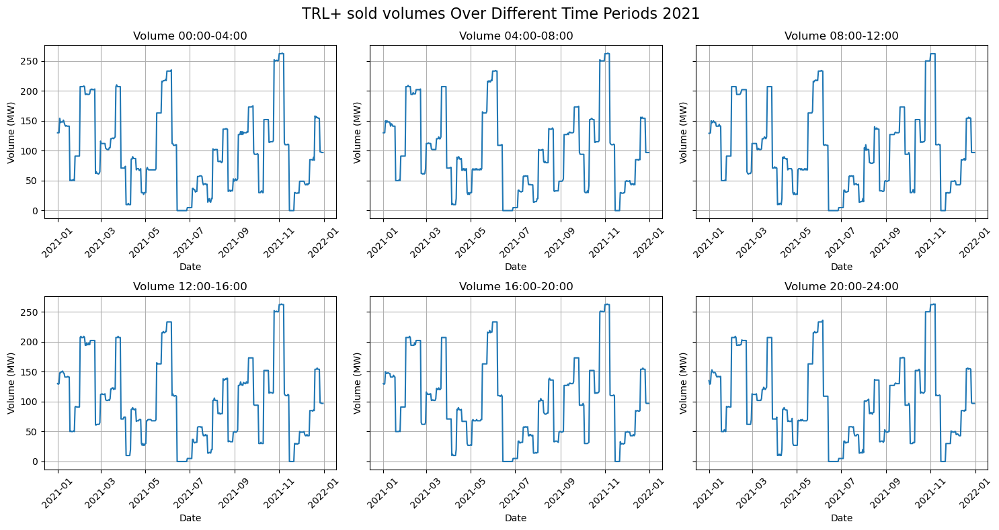

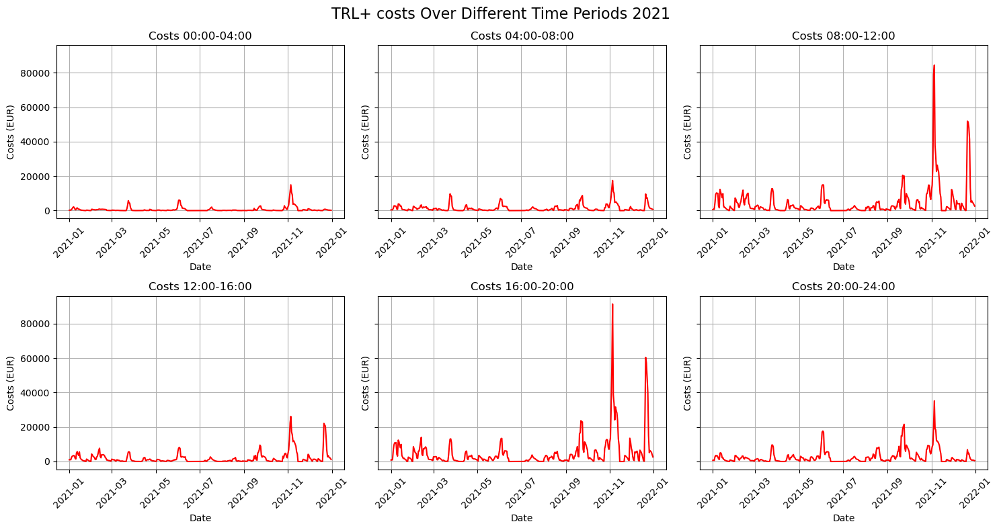

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()


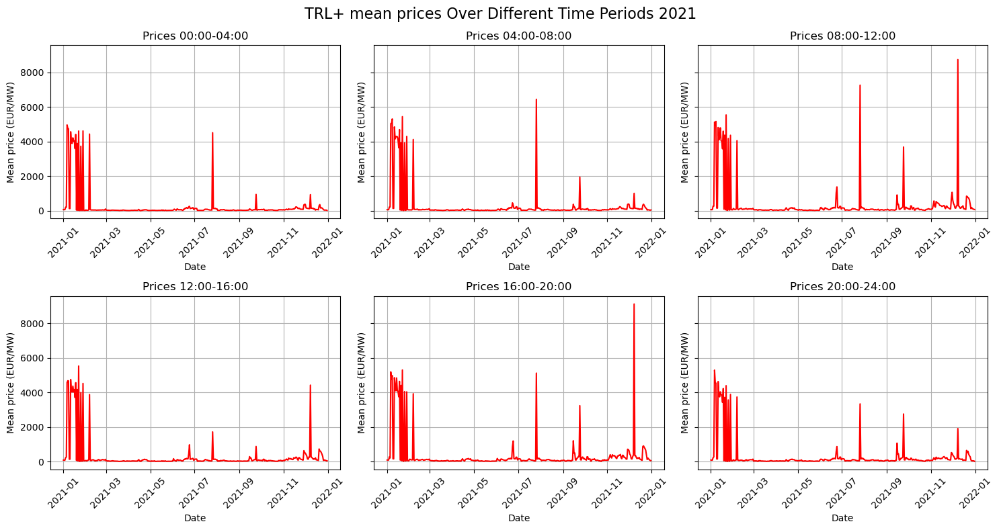

count     365.000000
mean      256.282425
std       899.542451
min         3.077000
25%        19.350000
50%        36.390000
75%        78.947059
max      4954.841111
Name: Prix_prestation, dtype: float64

count     365.000000
mean      286.625004
std       968.639465
min         5.745714
25%        27.412000
50%        50.724762
75%        94.612174
max      6437.921429
Name: Prix_prestation, dtype: float64

count     365.000000
mean      369.653302
std      1091.355246
min         7.983529
25%        42.539091
50%        80.299286
75%       155.788889
max      8732.378235
Name: Prix_prestation, dtype: float64

count     365.000000
mean      292.035746
std       914.412662
min         3.726087
25%        27.773333
50%        53.841667
75%       119.480000
max      5520.981111
Name: Prix_prestation, dtype: float64

count     365.000000
mean      368.377876
std      1054.928602
min        11.646000
25%        47.386818
50%        87.490909
75%       161.722353
max      9106.613529
Name

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPU21:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=545
max_cost=2844930.12


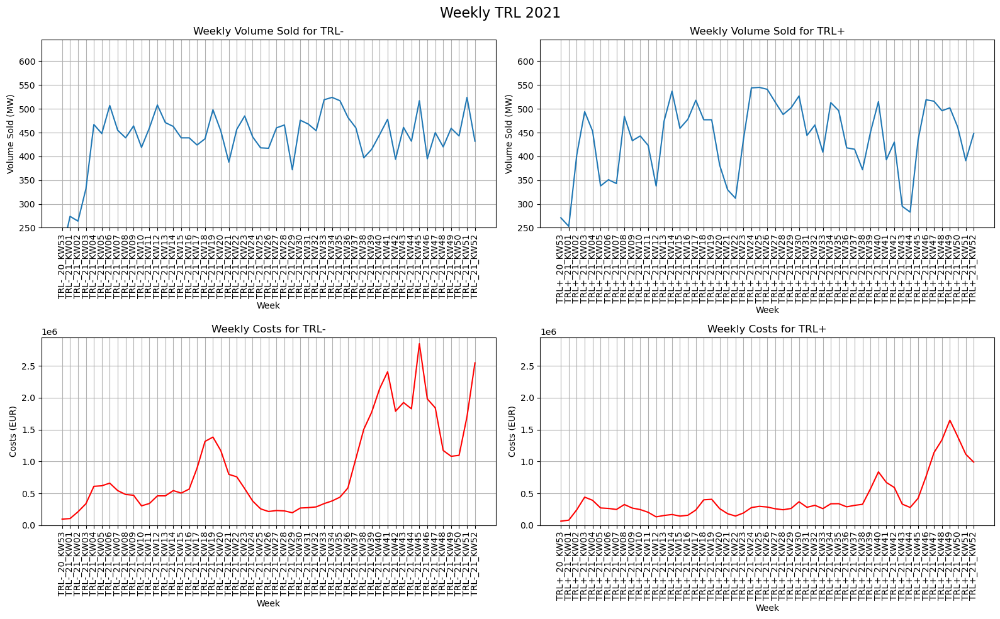

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW21.index, grouped_TPDW21['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW21.index, grouped_TPUW21['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW21.index, grouped_TPDW21['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW21.index, grouped_TPUW21['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2021', fontsize=16)
plt.tight_layout()
plt.show()


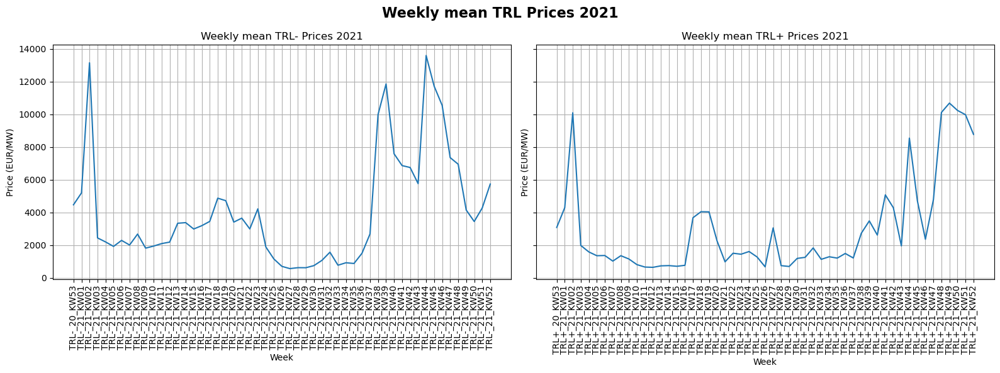

desription of TRL- prices:
 count       53.000000
mean      4091.729221
std       3379.319669
min        562.312727
25%       1888.243478
50%       3187.292558
75%       5195.064444
max      13602.066667
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count       53.000000
mean      3004.863665
std       2947.222968
min        640.261860
25%       1151.478750
50%       1584.708293
75%       4035.505714
max      10691.086349
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW21.index, grouped_TPDW21['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2021')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW21.index, grouped_TPUW21['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2021')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2021', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW21["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW21["Prix_prestation"].describe()}')

---
# Data 2022

In [ ]:
res22=pd.read_csv(DATA + '2022-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
print(res22.Description.unique())
res22

['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\713130675.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res22=pd.read_csv(DATA + '2022-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,0.9,EUR/MW,2.7,EUR,47.0,EUR/MWh*,CH,0.22,EUR/MWh*,Ja
1,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,0.5,EUR/MW,1.0,EUR,47.0,EUR/MWh*,CH,0.12,EUR/MWh*,Ja
2,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,4,MW,4,MW,20.0,EUR/MW,80.0,EUR,47.0,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
3,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,12.0,EUR/MW,60.0,EUR,47.0,EUR/MWh*,CH,3.00,EUR/MWh*,Ja
4,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,22.3,EUR/MW,22.3,EUR,47.0,EUR/MWh*,CH,5.58,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586606,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,0.8,CHF/MW,0.0,CHF,0.2,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
586607,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,9,MW,0,MW,18.0,CHF/MW,0.0,CHF,4.5,CHF/MWh*,CH,4.50,CHF/MWh*,NaN
586608,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,1.2,CHF/MW,6.0,CHF,0.3,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
586609,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,40,MW,0,MW,100.0,CHF/MW,0.0,CHF,25.0,CHF/MWh*,CH,25.00,CHF/MWh*,NaN


In [ ]:
res22_CH=res22[res22.Pays=='CH']
res22_CH

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,0.9,EUR/MW,2.7,EUR,47.0,EUR/MWh*,CH,0.22,EUR/MWh*,Ja
1,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,0.5,EUR/MW,1.0,EUR,47.0,EUR/MWh*,CH,0.12,EUR/MWh*,Ja
2,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,4,MW,4,MW,20.0,EUR/MW,80.0,EUR,47.0,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
3,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,12.0,EUR/MW,60.0,EUR,47.0,EUR/MWh*,CH,3.00,EUR/MWh*,Ja
4,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,22.3,EUR/MW,22.3,EUR,47.0,EUR/MWh*,CH,5.58,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586606,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,0.8,CHF/MW,0.0,CHF,0.2,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
586607,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,9,MW,0,MW,18.0,CHF/MW,0.0,CHF,4.5,CHF/MWh*,CH,4.50,CHF/MWh*,NaN
586608,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,1.2,CHF/MW,6.0,CHF,0.3,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
586609,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,40,MW,0,MW,100.0,CHF/MW,0.0,CHF,25.0,CHF/MWh*,CH,25.00,CHF/MWh*,NaN


## Primary control auction 2022

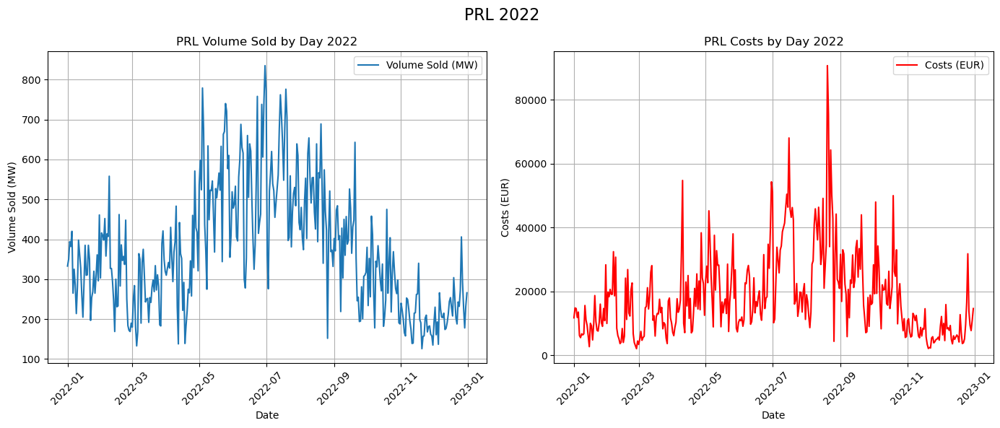

In [ ]:
res22_CH_p=res22_CH[res22_CH['Description'].str.contains('Primary control')].copy()

res22_CH_p['date'] = pd.to_datetime(res22_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p22 = res22_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p22.index, grouped_p22['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2022')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p22.index, grouped_p22['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2022')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2022', fontsize=16)
plt.tight_layout()
plt.show()

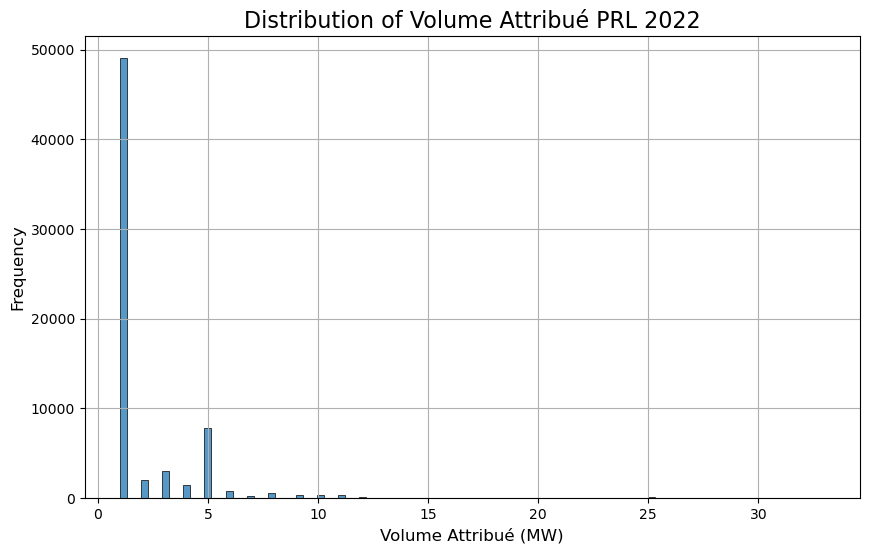

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(res22_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2022', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.show()

In [ ]:
PRL22_0_4=res22_CH_p[res22_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL22_4_8=res22_CH_p[res22_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL22_8_12=res22_CH_p[res22_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL22_12_16=res22_CH_p[res22_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL22_16_20=res22_CH_p[res22_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL22_20_24=res22_CH_p[res22_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL22_0_4=PRL22_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_4_8=PRL22_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_8_12=PRL22_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_12_16=PRL22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_16_20=PRL22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_20_24=PRL22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

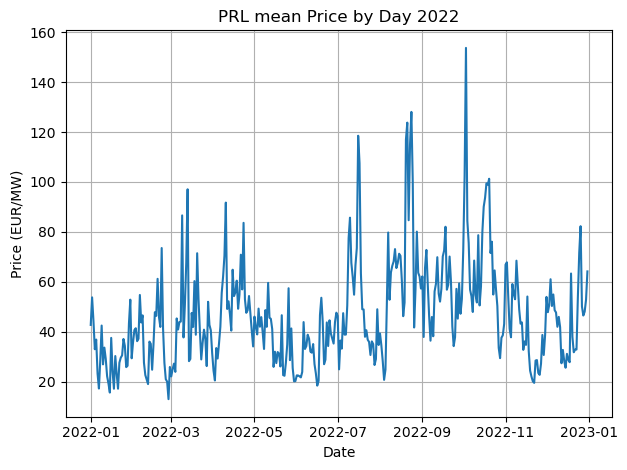

desription of PRL 2022 prices:
 count    365.000000
mean      46.771372
std       20.825134
min       12.925773
25%       31.977686
50%       43.179630
75%       56.705354
max      153.709405
Name: Prix_prestation, dtype: float64



In [ ]:
plt.plot(grouped_p22.index, grouped_p22['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2022')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print(f'desription of PRL 2022 prices:\n {grouped_p22["Prix_prestation"].describe()}\n')

max_volume=164, min volume= 20
max_cost=26060.01, min cost= 134.7


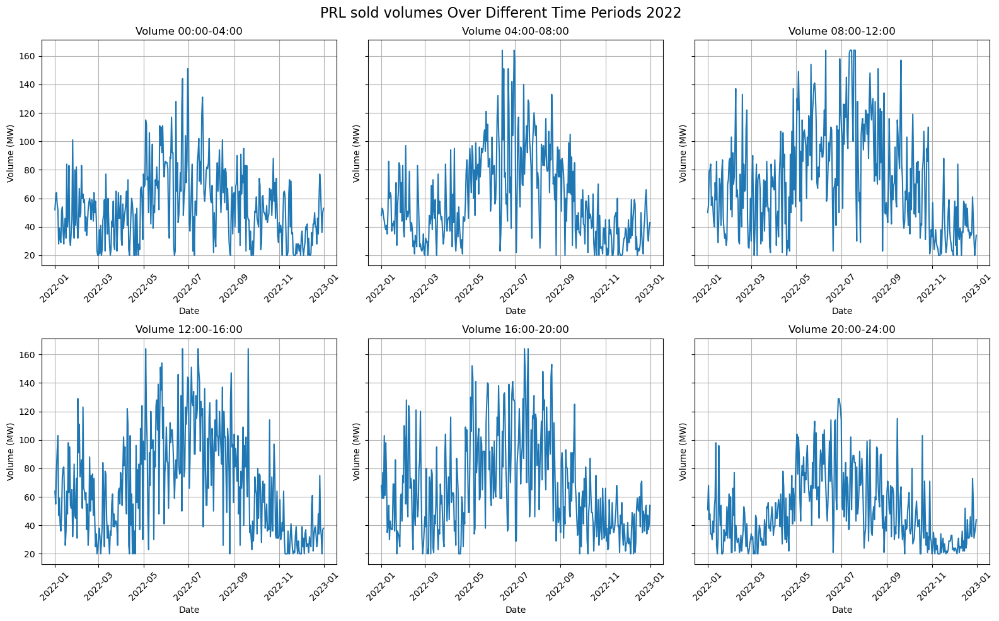

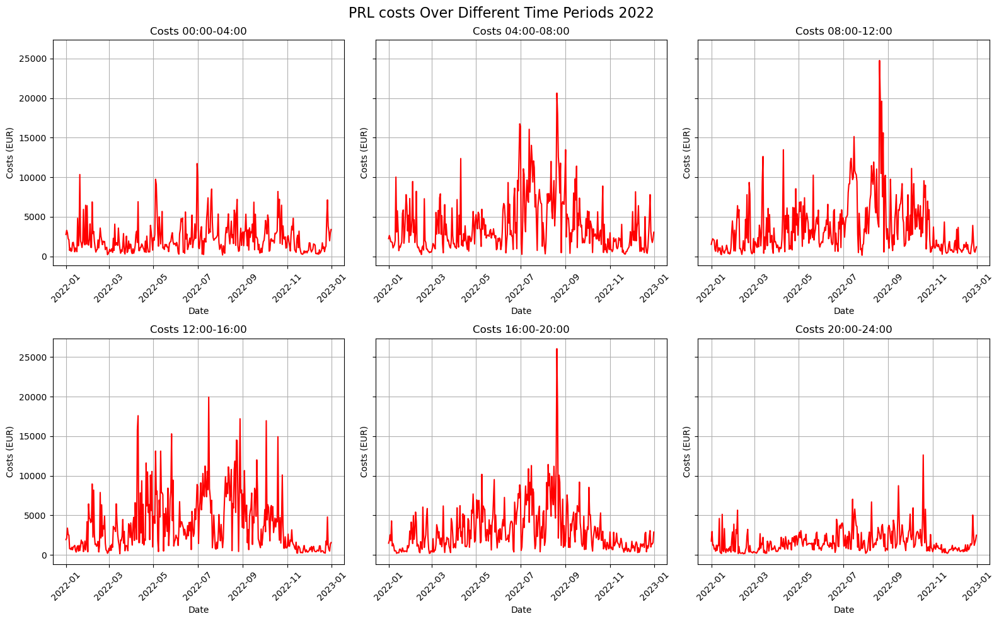

In [ ]:
# Grouped data list and labels
grouped_p22 = [grouped_PRL22_0_4, grouped_PRL22_4_8, grouped_PRL22_8_12, grouped_PRL22_12_16, grouped_PRL22_16_20, grouped_PRL22_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p22])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p22])
min_cost = min([data['Coûts'].min() for data in grouped_p22])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


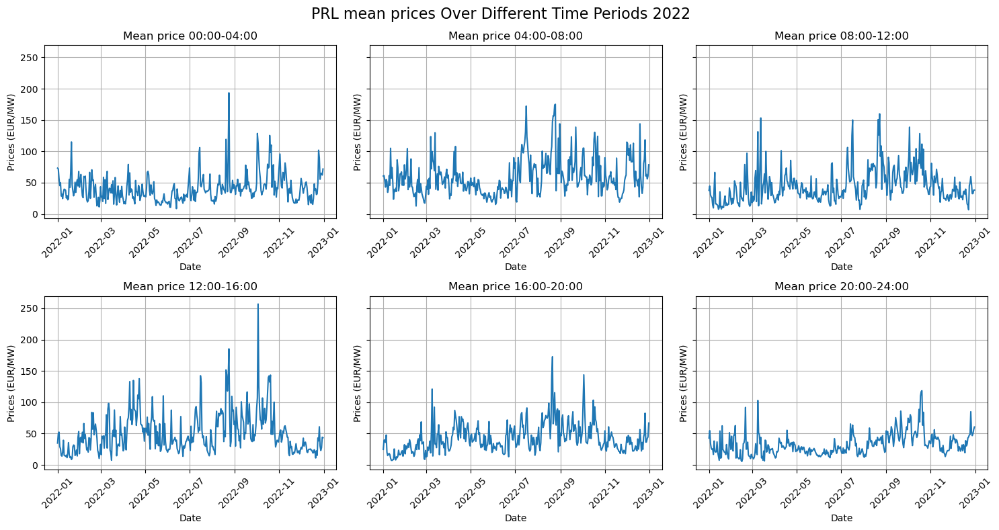

count    365.000000
mean      41.073516
std       21.878965
min        8.568333
25%       26.539394
50%       37.088462
75%       49.063158
max      193.444444
Name: Prix_prestation, dtype: float64

count    365.000000
mean      59.820098
std       29.413792
min       12.662500
25%       38.919000
50%       53.746429
75%       73.877059
max      175.103125
Name: Prix_prestation, dtype: float64

count    365.000000
mean      44.948562
std       26.676362
min        6.620000
25%       26.586471
50%       39.029412
75%       55.914412
max      159.901944
Name: Prix_prestation, dtype: float64

count    365.000000
mean      51.008417
std       32.417957
min        7.350000
25%       26.740625
50%       43.413924
75%       65.930455
max      256.785833
Name: Prix_prestation, dtype: float64

count    365.000000
mean      43.039033
std       23.009681
min        7.048387
25%       26.300000
50%       37.953333
75%       55.066250
max      172.709444
Name: Prix_prestation, dtype: float64

count

In [ ]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

for group in grouped_p22:
    print(f'{group["Prix_prestation"].describe()}\n')

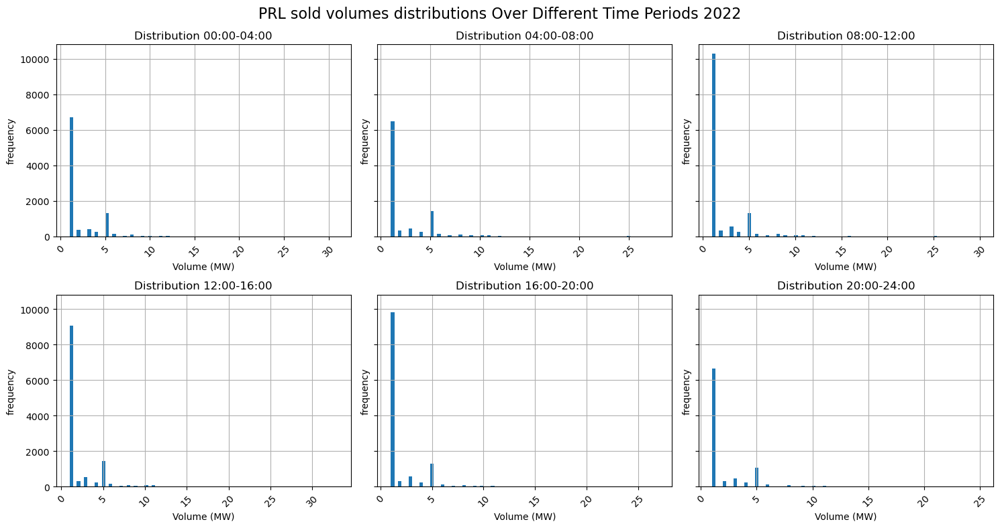

In [ ]:

list_PRL22 = [PRL22_0_4, PRL22_4_8, PRL22_8_12, PRL22_12_16, PRL22_16_20, PRL22_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control Auction 2022

In [ ]:
# Create DataFrame for Secondary control
res22_CH_s = res22_CH[res22_CH['Description'].str.contains('Secondary control')].copy()

res22_CH_s['Week'] = res22_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL22m=res22_CH_s[res22_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL22p=res22_CH_s[res22_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL22m=SRL22m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_SRL22p=SRL22p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_SRL22=[grouped_SRL22m, grouped_SRL22p]

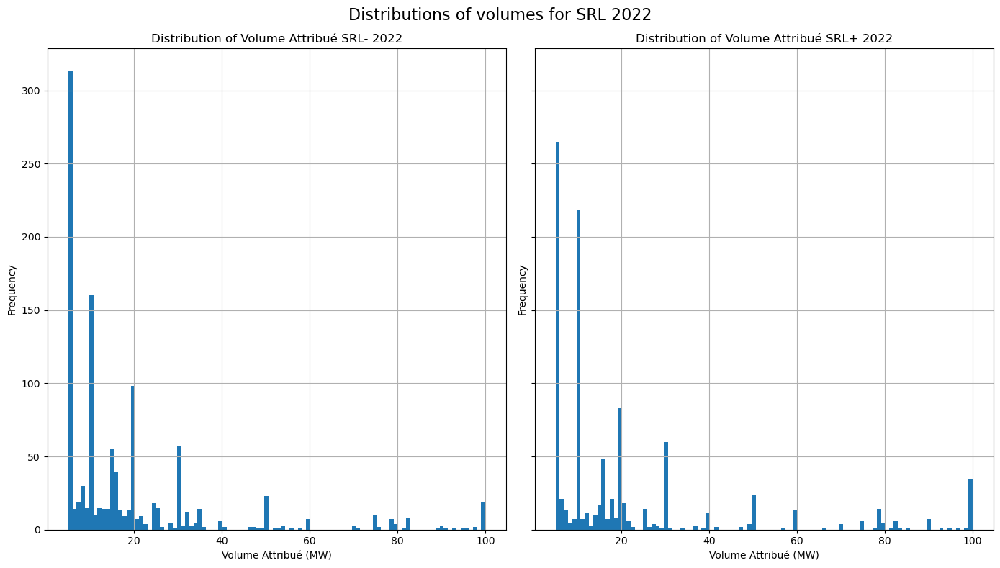

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL22m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2022')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL22p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2022')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of volumes for SRL 2022', fontsize=16)
plt.tight_layout()
plt.show()

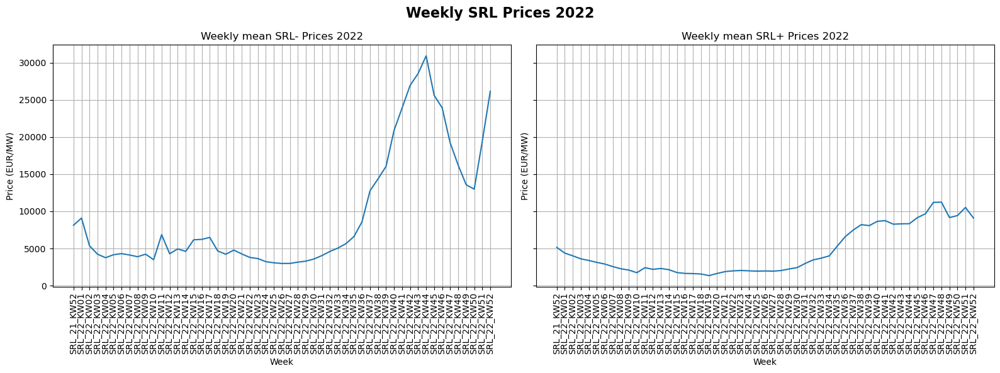

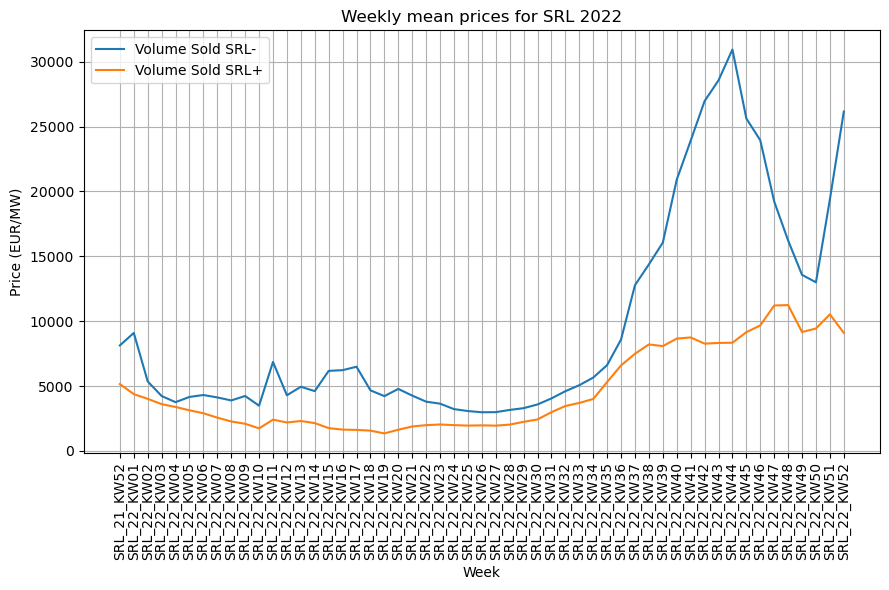

desription of SRL- prices:
 count       53.000000
mean      9587.273723
std       8169.101034
min       2977.370000
25%       4120.628571
50%       5060.792727
75%      13568.308519
max      30940.350000
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count       53.000000
mean      4638.285977
std       3179.682867
min       1346.877333
25%       2025.253333
50%       3127.720000
75%       8206.068571
max      11239.028095
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL22m.index, grouped_SRL22m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2022')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL22p.index, grouped_SRL22p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2022')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2022', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL22m.index, grouped_SRL22m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL22p.index, grouped_SRL22p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2022')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL22m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL22p["Prix_prestation"].describe()}')

max_volume=482, min volume= 380
max_cost=12353083.65, min cost= 543683.6


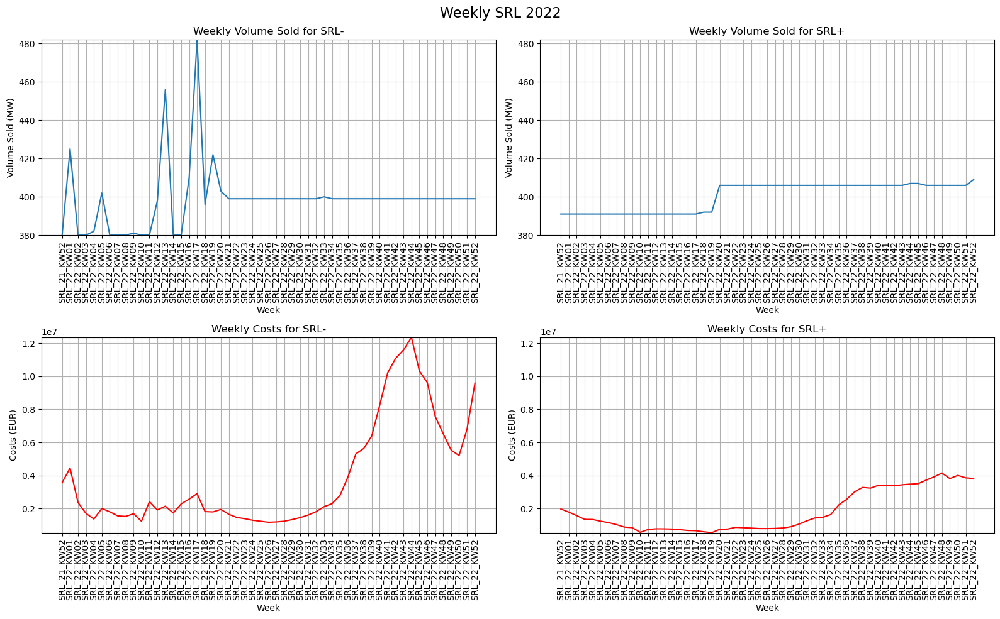

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL22])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL22])
min_cost = min([data['Coûts'].min() for data in grouped_SRL22])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (min_volume, max_volume )  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost, max_cost)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL22m.index, grouped_SRL22m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL22p.index, grouped_SRL22p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL22m.index, grouped_SRL22m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL22p.index, grouped_SRL22p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2022', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2022

In [ ]:
# Create DataFrame for Tertiary control
res22_CH_t = res22_CH[res22_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW22=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW22=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP'].copy()
TPD22_00_04=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD22_04_08=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD22_08_12=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD22_12_16=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD22_16_20=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD22_20_24=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU22_00_04=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU22_04_08=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU22_08_12=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU22_12_16=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU22_16_20=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU22_20_24=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW22['Week']=TPDW22['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW22['Week']=TPUW22['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW22=TPDW22.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW22=TPUW22.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD22_00_04['date'] = pd.to_datetime(TPD22_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_04_08['date'] = pd.to_datetime(TPD22_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_08_12['date'] = pd.to_datetime(TPD22_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_12_16['date'] = pd.to_datetime(TPD22_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_16_20['date'] = pd.to_datetime(TPD22_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_20_24['date'] = pd.to_datetime(TPD22_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU22_00_04['date'] = pd.to_datetime(TPU22_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_04_08['date'] = pd.to_datetime(TPU22_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_08_12['date'] = pd.to_datetime(TPU22_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_12_16['date'] = pd.to_datetime(TPU22_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_16_20['date'] = pd.to_datetime(TPU22_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_20_24['date'] = pd.to_datetime(TPU22_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD22_00_04=TPD22_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_04_08=TPD22_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_08_12=TPD22_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_12_16=TPD22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_16_20=TPD22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_20_24=TPD22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU22_00_04=TPU22_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_04_08=TPU22_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_08_12=TPU22_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_12_16=TPU22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_16_20=TPU22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_20_24=TPU22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD22 = [grouped_TPD22_00_04, grouped_TPD22_04_08, grouped_TPD22_08_12, grouped_TPD22_12_16, grouped_TPD22_16_20, grouped_TPD22_20_24]

grouped_TPU22 = [grouped_TPU22_00_04, grouped_TPU22_04_08, grouped_TPU22_08_12, grouped_TPU22_12_16, grouped_TPU22_16_20, grouped_TPU22_20_24]

grouped_TPW22=[grouped_TPDW22, grouped_TPUW22]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

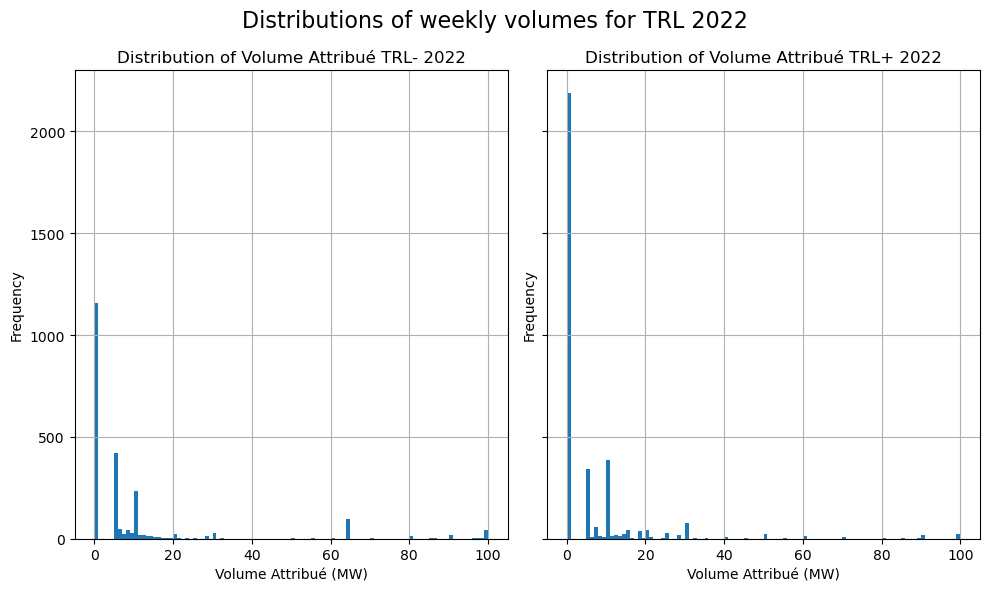

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW22['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2022')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(TPUW22['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2022')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of weekly volumes for TRL 2022', fontsize=16)
plt.tight_layout()
plt.show()


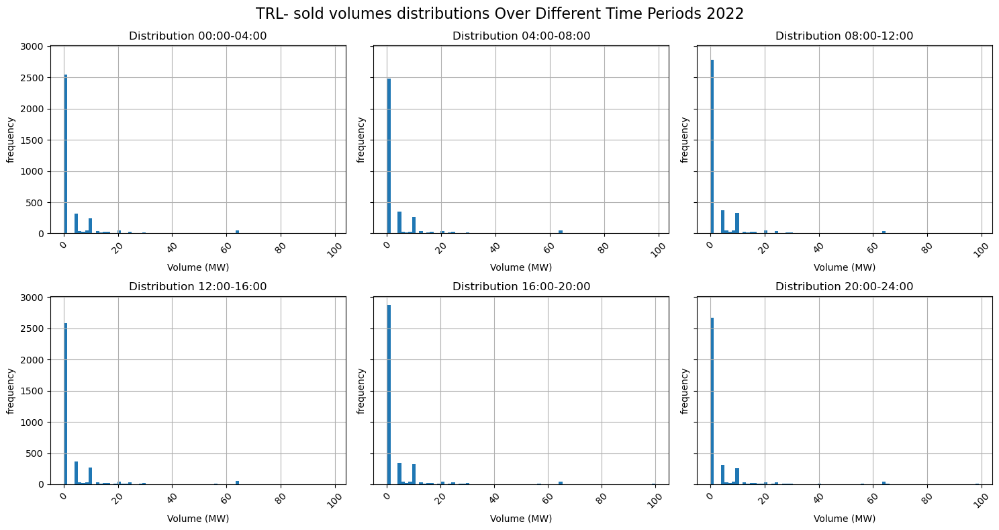

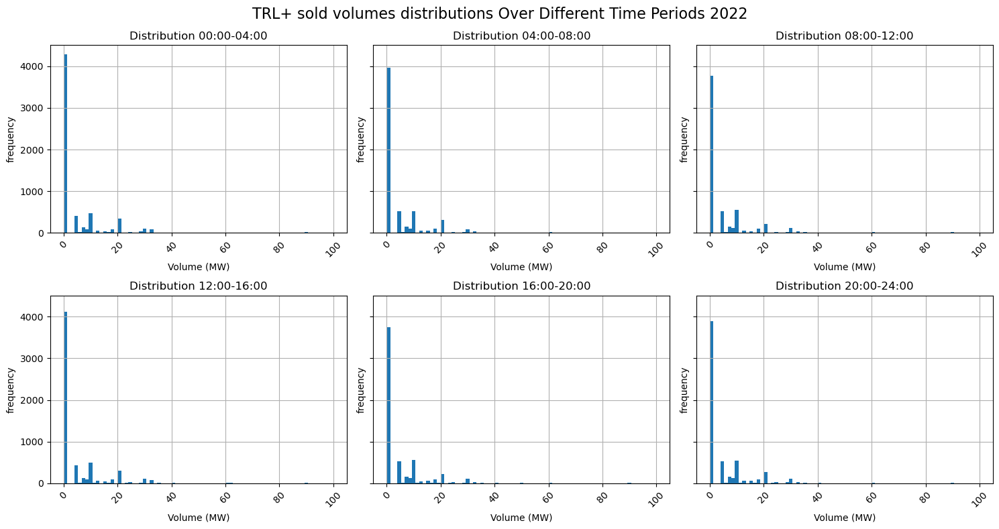

In [ ]:
list_TPD22 = [TPD22_00_04, TPD22_04_08, TPD22_08_12, TPD22_12_16, TPD22_16_20, TPD22_20_24]

list_TPU22 = [TPU22_00_04, TPU22_04_08, TPU22_08_12, TPU22_12_16, TPU22_16_20, TPU22_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=145
max_cost=195860.2


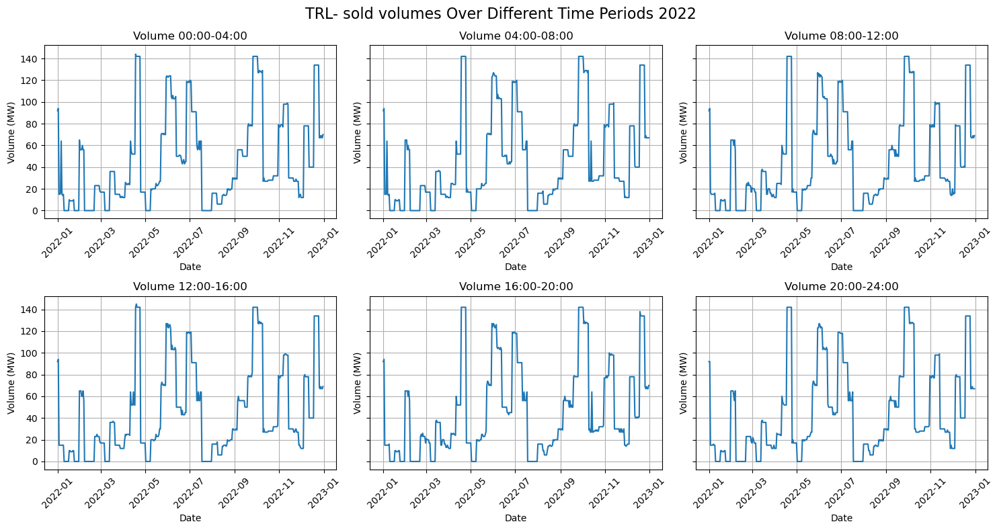

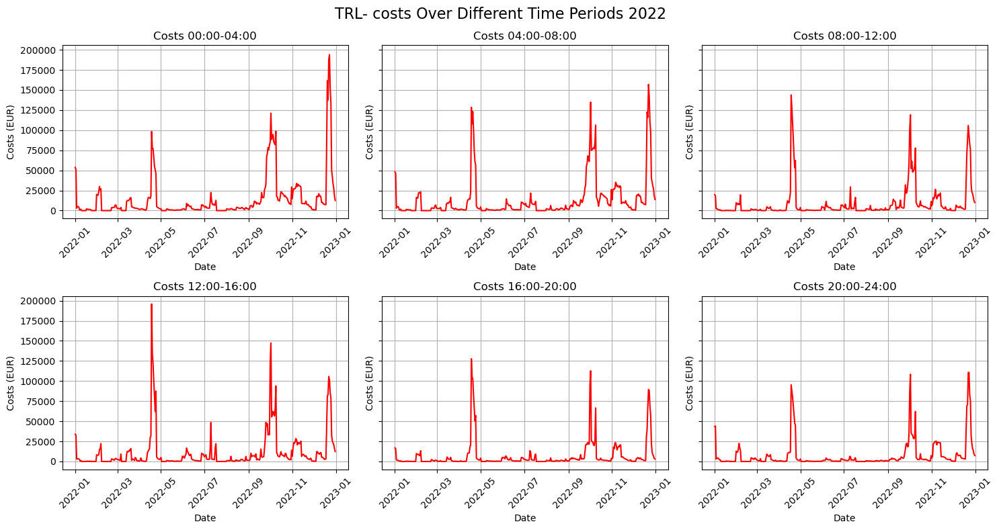

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


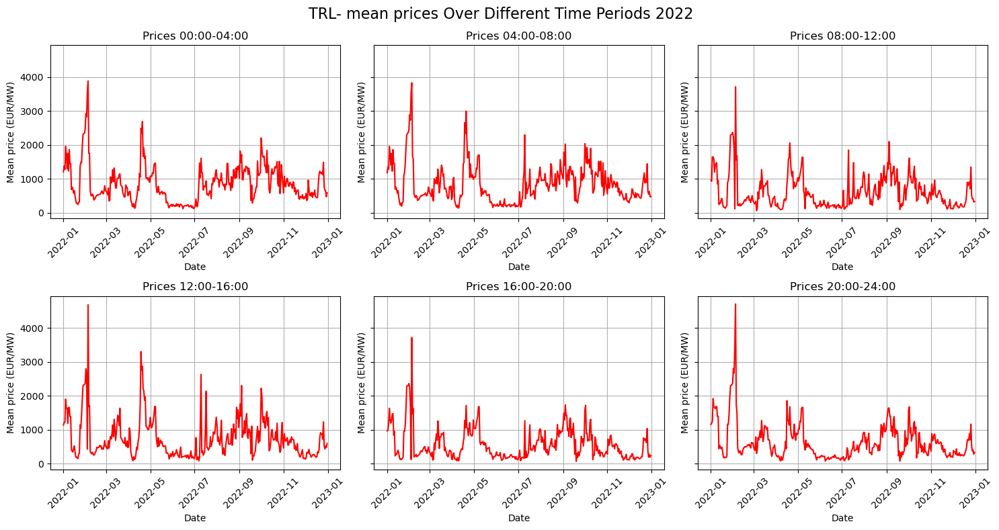

count     365.000000
mean      865.283886
std       551.304284
min       120.886250
25%       494.877778
50%       766.364286
75%      1151.325000
max      3887.520000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      851.453752
std       564.102733
min       140.902222
25%       466.007692
50%       732.083333
75%      1122.809167
max      3830.520000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      618.602397
std       493.556899
min        66.333333
25%       248.320000
50%       461.400000
75%       857.078182
max      3715.320000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      757.866954
std       595.640831
min        84.845000
25%       332.304000
50%       595.282667
75%      1025.828000
max      4686.000000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      574.381187
std       472.267636
min        70.036364
25%       232.750000
50%       399.160000
75%       797.885714
max      3718.200000
Name

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPD22:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=285
max_cost=111633.8


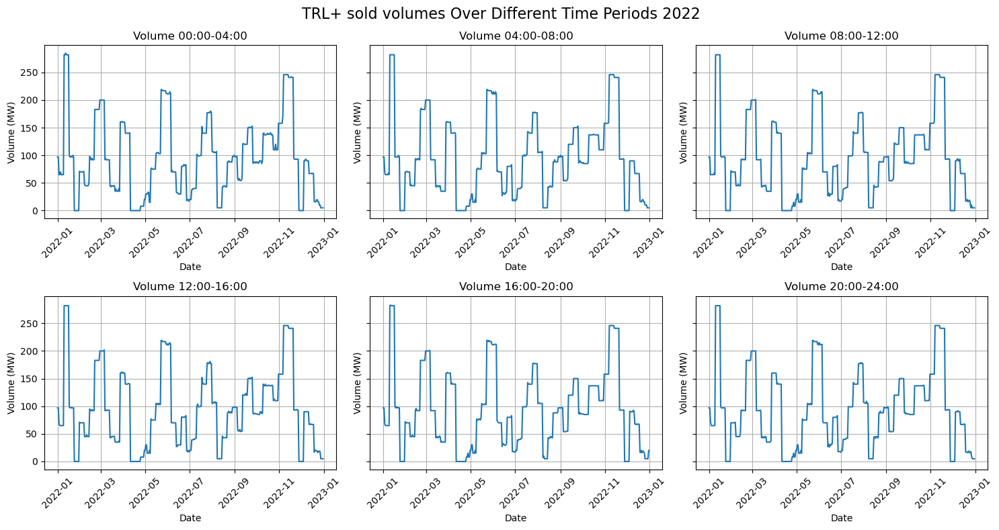

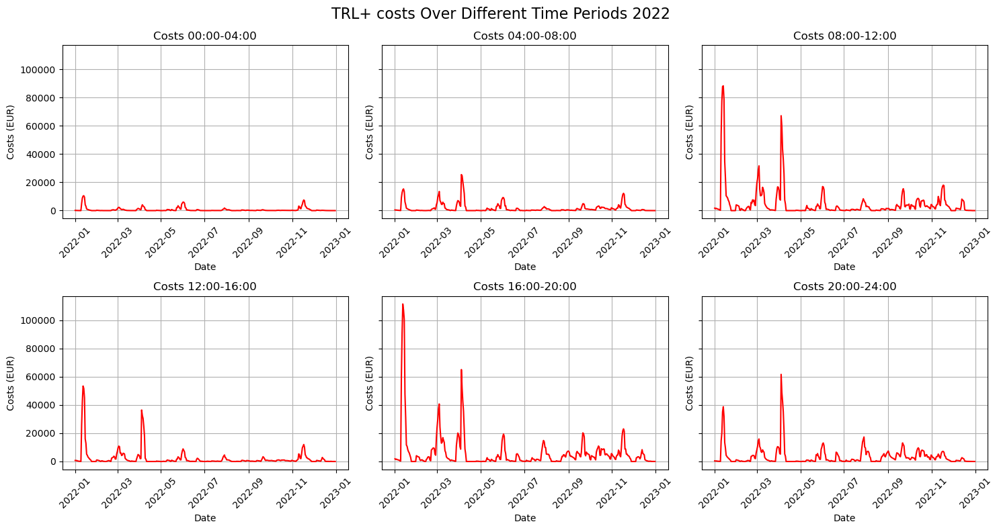

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


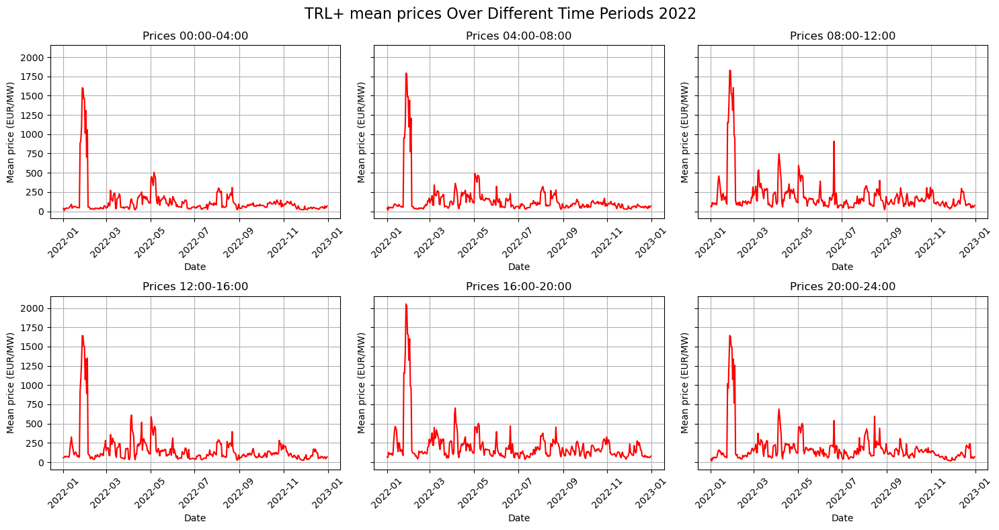

count     365.000000
mean      127.684367
std       208.285367
min         9.150476
25%        45.901739
50%        72.873684
75%       120.958000
max      1601.718182
Name: Prix_prestation, dtype: float64

count     365.000000
mean      145.890462
std       223.099359
min        15.858095
25%        57.677273
50%        88.465000
75%       147.540000
max      1792.330000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      201.125629
std       243.888078
min        19.896000
25%        90.663000
50%       133.417143
75%       219.887500
max      1827.500000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      164.559121
std       225.554724
min        25.813333
25%        66.917000
50%       101.112000
75%       175.081111
max      1641.600000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      211.426223
std       251.001055
min        37.573333
25%        97.822105
50%       145.341875
75%       238.131250
max      2051.888889
Name

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPU22:
    print(f'{group["Prix_prestation"].describe()}\n')

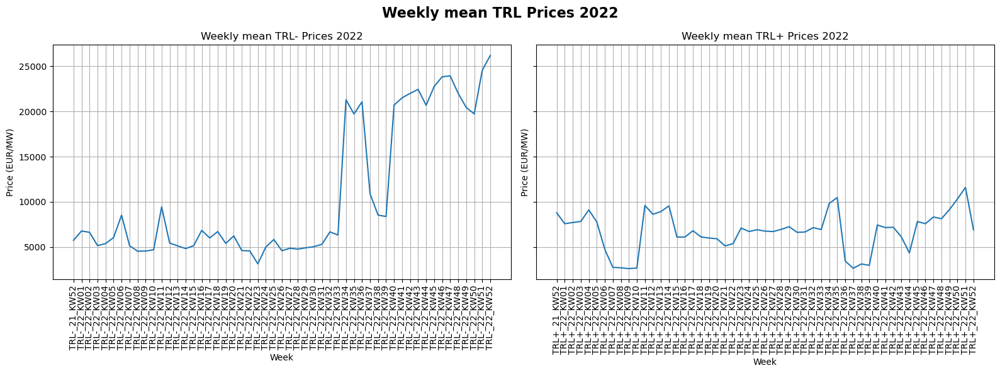

desription of TRL- prices:
 count       53.000000
mean     10764.780681
std       7671.604976
min       3129.855238
25%       5121.534222
50%       6320.545882
75%      20443.644375
max      26192.043913
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count       53.000000
mean      6765.985942
std       2190.373198
min       2605.983111
25%       5994.472800
50%       6929.208750
75%       7823.940870
max      11595.824583
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW22.index, grouped_TPDW22['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2022')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW22.index, grouped_TPUW22['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2022')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2022', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW22["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW22["Prix_prestation"].describe()}')

max_volume=545
max_cost=5874582.5


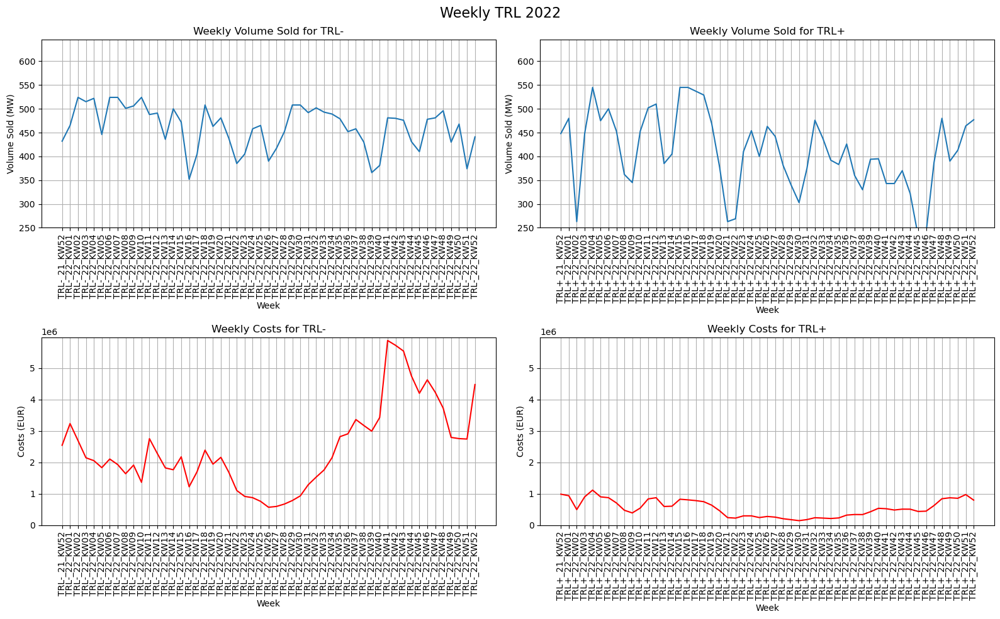

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW22.index, grouped_TPDW22['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW22.index, grouped_TPUW22['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW22.index, grouped_TPDW22['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW22.index, grouped_TPUW22['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2022', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2023

In [ ]:
res23=pd.read_csv('./data/2023-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res23

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\1258441169.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res23=pd.read_csv('./data/2023-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.00,EUR/MW,400.00,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja
1,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.40,EUR/MW,54.40,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja
2,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.20,EUR/MW,51.20,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja
3,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.10,EUR/MW,66.10,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja
4,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.00,EUR/MW,425.00,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577553,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577554,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577555,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577556,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN


### keeping only the swiss data

In [ ]:
res23_CH=res23[res23.Pays=='CH']

In [ ]:
# res23_CH[res23_CH.Coûts==0]

In [ ]:
res23_CH.Description.unique()

array(['Primary control Auction 00:00 bis 04:00',
       'Primary control Auction 04:00 bis 08:00',
       'Primary control Auction 08:00 bis 12:00',
       'Primary control Auction 12:00 bis 16:00',
       'Primary control Auction 16:00 bis 20:00',
       'Primary control Auction 20:00 bis 24:00',
       'Secondary control Auction SRL+', 'Secondary control Auction SRL-',
       'Tertiary Power DOWN', 'Tertiary Power UP',
       'Tertiary Power DOWN 00:00 bis 04:00',
       'Tertiary Power DOWN 04:00 bis 08:00',
       'Tertiary Power DOWN 08:00 bis 12:00',
       'Tertiary Power DOWN 12:00 bis 16:00',
       'Tertiary Power DOWN 16:00 bis 20:00',
       'Tertiary Power DOWN 20:00 bis 24:00',
       'Tertiary Power UP 00:00 bis 04:00',
       'Tertiary Power UP 04:00 bis 08:00',
       'Tertiary Power UP 08:00 bis 12:00',
       'Tertiary Power UP 12:00 bis 16:00',
       'Tertiary Power UP 16:00 bis 20:00',
       'Tertiary Power UP 20:00 bis 24:00'], dtype=object)

## Primary control Auction 2023

In [ ]:
# Create DataFrame for Primary control
res23_CH_p = res23_CH[res23_CH['Description'].str.contains('Primary control')].copy()

print(res23_CH_p['Description'].unique())

['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00']


In [ ]:
res23_CH_p


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.0,EUR/MW,400.0,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja
1,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.4,EUR/MW,54.4,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja
2,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.2,EUR/MW,51.2,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja
3,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.1,EUR/MW,66.1,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja
4,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.0,EUR/MW,425.0,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
525077,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,50.0,EUR/MW,150.0,EUR,15.00,EUR/MWh*,CH,12.50,EUR/MWh*,Ja
525078,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,42.0,EUR/MW,126.0,EUR,15.00,EUR/MWh*,CH,10.50,EUR/MWh*,Ja
525079,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,48.0,EUR/MW,144.0,EUR,15.00,EUR/MWh*,CH,12.00,EUR/MWh*,Ja
525080,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,52.0,EUR/MW,156.0,EUR,15.00,EUR/MWh*,CH,13.00,EUR/MWh*,Ja


In [ ]:
res23_CH_p['date'] = pd.to_datetime(res23_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
# Set the date column as the index
res23_CH_p.set_index('date', inplace=True)

res23_CH_p

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
date,,,,,,,,,,,,,,,,
2023-01-01,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.0,EUR/MW,400.0,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja
2023-01-01,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.4,EUR/MW,54.4,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja
2023-01-01,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.2,EUR/MW,51.2,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja
2023-01-01,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.1,EUR/MW,66.1,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja
2023-01-01,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.0,EUR/MW,425.0,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,50.0,EUR/MW,150.0,EUR,15.00,EUR/MWh*,CH,12.50,EUR/MWh*,Ja
2023-12-31,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,42.0,EUR/MW,126.0,EUR,15.00,EUR/MWh*,CH,10.50,EUR/MWh*,Ja
2023-12-31,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,48.0,EUR/MW,144.0,EUR,15.00,EUR/MWh*,CH,12.00,EUR/MWh*,Ja


In [ ]:
freq_2023_p = res23_CH_p['Volume_attribué'].value_counts()
freq_2023_p



Volume_attribué
1     29531
2      4869
5      3878
3      3843
4      2717
10     1576
6      1302
9       641
12      530
11      522
8       466
7       329
15      209
25      184
20       63
14       44
16       35
13       29
18       26
17       22
24       17
22       12
23        9
30        9
19        8
28        4
21        3
60        3
Name: count, dtype: int64

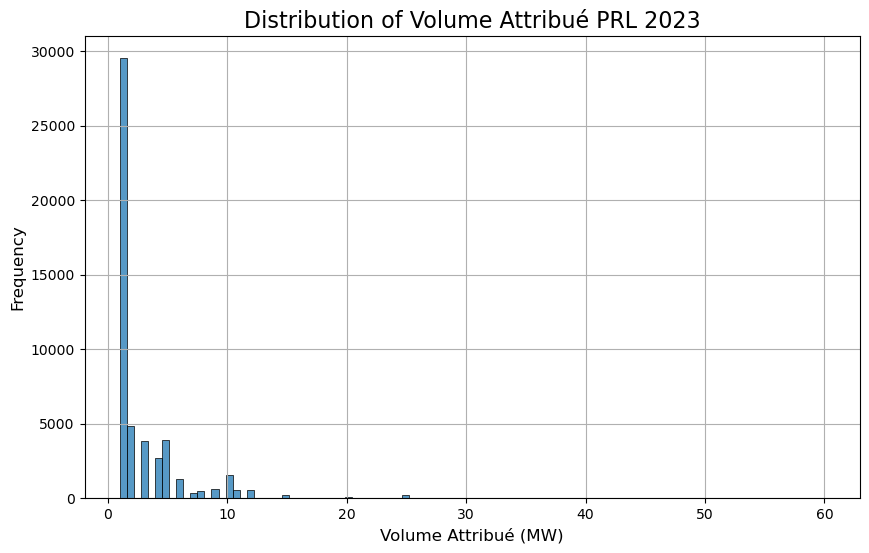

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(res23_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2023', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.show()

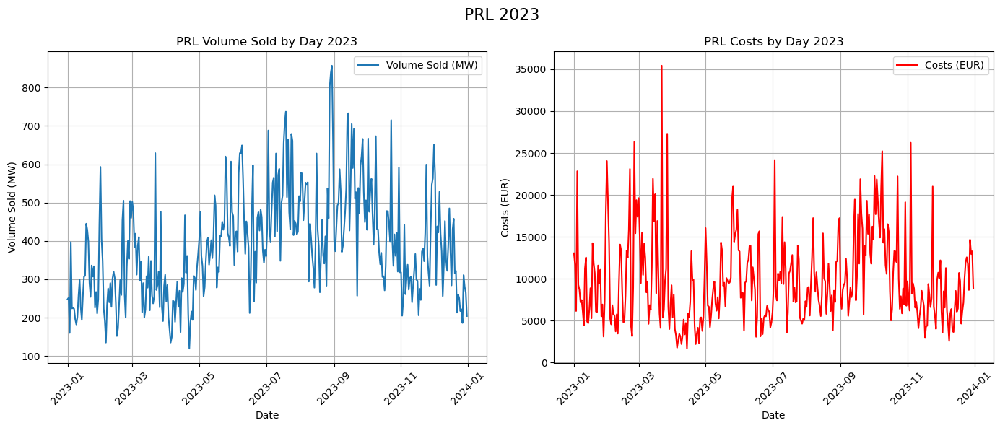

In [ ]:
# Grouping by 'date' and summing the volume sold and costs
grouped_p23 = res23_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p23.index, grouped_p23['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2023')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p23.index, grouped_p23['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2023')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2023', fontsize=16)
plt.tight_layout()
plt.show()

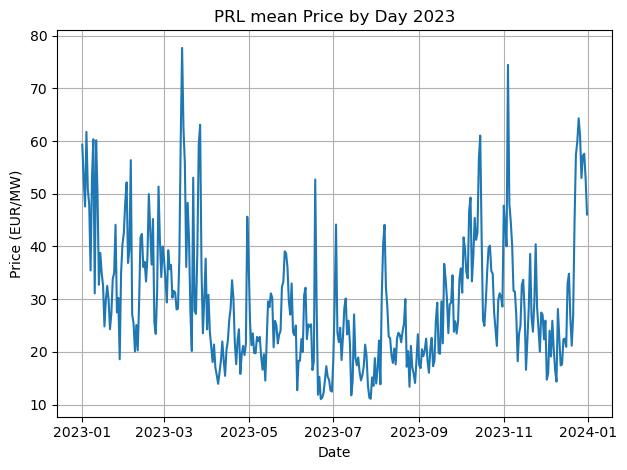

desription of PRL 2023 prices:
 count    365.000000
mean      29.440003
std       12.340130
min       11.039216
25%       20.502297
50%       26.642373
75%       35.557083
max       77.662761
Name: Prix_prestation, dtype: float64



In [ ]:
plt.plot(grouped_p23.index, grouped_p23['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2023')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print(f'desription of PRL 2023 prices:\n {grouped_p23["Prix_prestation"].describe()}\n')

In [ ]:
PRL23_0_4=res23_CH_p[res23_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL23_4_8=res23_CH_p[res23_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL23_8_12=res23_CH_p[res23_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL23_12_16=res23_CH_p[res23_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL23_16_20=res23_CH_p[res23_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL23_20_24=res23_CH_p[res23_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL23_0_4=PRL23_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_4_8=PRL23_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_8_12=PRL23_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_12_16=PRL23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_16_20=PRL23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_20_24=PRL23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Grouped data list and labels
grouped_p23 = [grouped_PRL23_0_4, grouped_PRL23_4_8, grouped_PRL23_8_12, grouped_PRL23_12_16, grouped_PRL23_16_20, grouped_PRL23_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


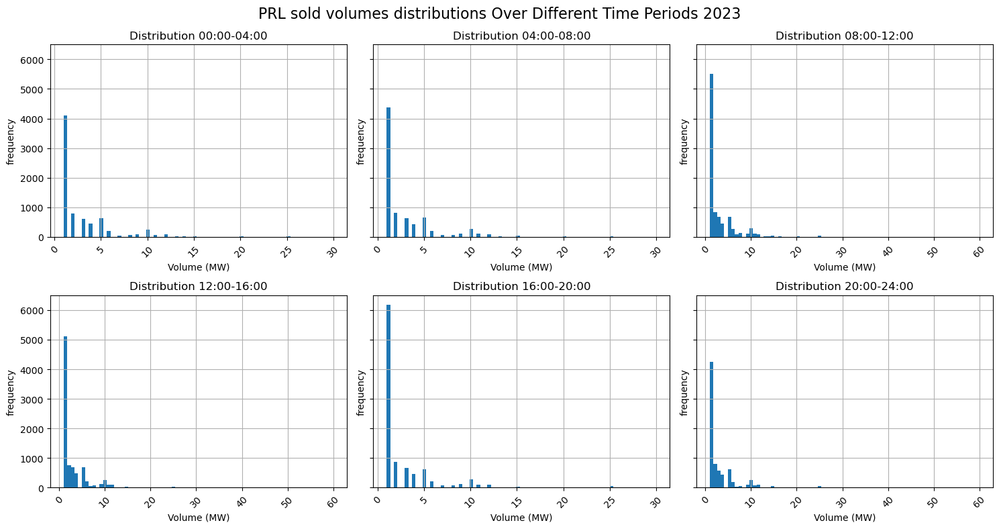

In [ ]:

list_PRL23 = [PRL23_0_4, PRL23_4_8, PRL23_8_12, PRL23_12_16, PRL23_16_20, PRL23_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=162, min volume= 19
max_cost=8926.36, min cost= 48.94


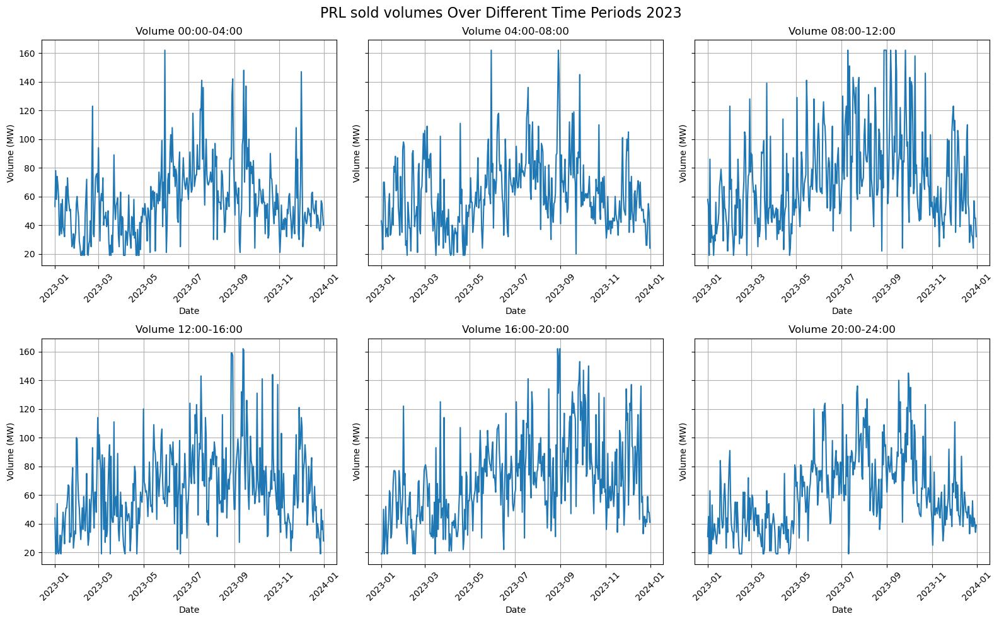

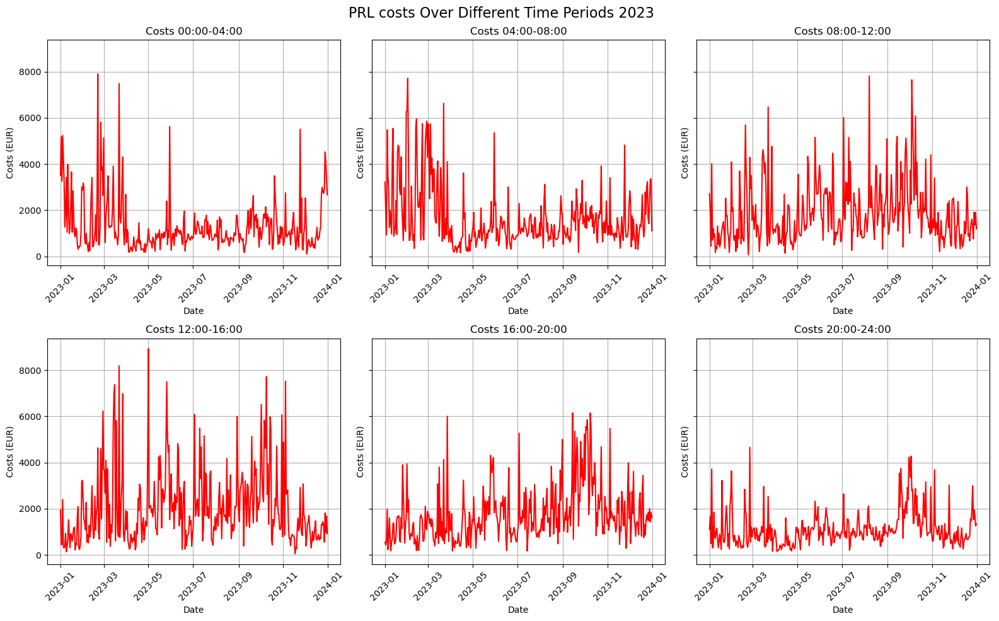

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p23])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p23])
min_cost = min([data['Coûts'].min() for data in grouped_p23])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


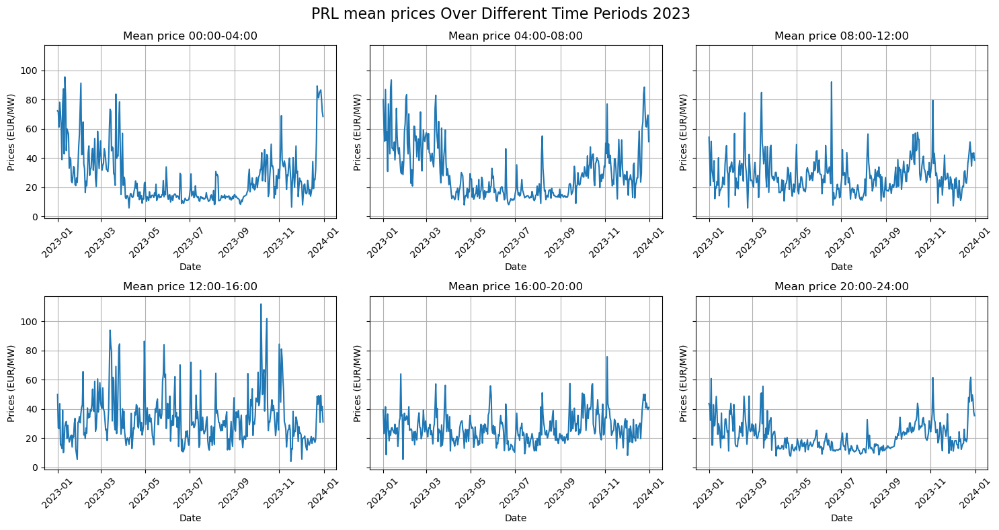

count    365.000000
mean      27.092312
std       18.738497
min        5.850000
25%       13.533333
50%       20.675000
75%       33.985849
max       95.515789
Name: Prix_prestation, dtype: float64
count    365.000000
mean      30.189493
std       18.040214
min        7.975000
25%       15.683810
50%       25.308421
75%       40.234118
max       93.466429
Name: Prix_prestation, dtype: float64
count    365.000000
mean      28.116474
std       11.843947
min        5.850000
25%       20.013667
50%       26.570588
75%       33.425357
max       92.121212
Name: Prix_prestation, dtype: float64
count    365.000000
mean      33.705799
std       16.974300
min        4.078333
25%       21.815000
50%       30.661111
75%       39.642857
max      111.832353
Name: Prix_prestation, dtype: float64
count    365.000000
mean      27.061688
std       10.010759
min        5.450000
25%       20.426471
50%       25.592000
75%       32.028000
max       75.783134
Name: Prix_prestation, dtype: float64
count    3

In [ ]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

for group in grouped_p23:
    print(group['Prix_prestation'].describe())

## Secondary control auction 2023

In [ ]:
# Create DataFrame for Secondary control
res23_CH_s = res23_CH[res23_CH['Description'].str.contains('Secondary control')].copy()

print(res23_CH_s['Description'].unique())
print(res23_CH_s.Appel_offres.unique())

['Secondary control Auction SRL+' 'Secondary control Auction SRL-']
['SRL_22_KW52' 'SRL_22_KW52_S1' 'SRL_22_KW52_S2' 'SRL_22_KW52_S3'
 'SRL_22_KW52_S4' 'SRL_23_KW01' 'SRL_23_KW01_S1' 'SRL_23_KW01_S2'
 'SRL_23_KW01_S3' 'SRL_23_KW01_S4' 'SRL_23_KW02' 'SRL_23_KW02_S1'
 'SRL_23_KW02_S2' 'SRL_23_KW02_S3' 'SRL_23_KW02_S4' 'SRL_23_KW03'
 'SRL_23_KW03_S1' 'SRL_23_KW03_S2' 'SRL_23_KW03_S3' 'SRL_23_KW03_S4'
 'SRL_23_KW04_S1' 'SRL_23_KW04_S2' 'SRL_23_KW04_S3' 'SRL_23_KW04_S4'
 'SRL_23_KW04_S5' 'SRL_23_KW05_S1' 'SRL_23_KW05_S2' 'SRL_23_KW05_S3'
 'SRL_23_KW05_S4' 'SRL_23_KW05_S5' 'SRL_23_KW06_S1' 'SRL_23_KW06_S2'
 'SRL_23_KW06_S3' 'SRL_23_KW06_S4' 'SRL_23_KW06_S5' 'SRL_23_KW07_S1'
 'SRL_23_KW07_S2' 'SRL_23_KW07_S3' 'SRL_23_KW07_S4' 'SRL_23_KW07_S5'
 'SRL_23_KW08_S1' 'SRL_23_KW08_S2' 'SRL_23_KW08_S3' 'SRL_23_KW08_S4'
 'SRL_23_KW08_S5' 'SRL_23_KW09_S1' 'SRL_23_KW09_S2' 'SRL_23_KW09_S3'
 'SRL_23_KW09_S4' 'SRL_23_KW09_S5' 'SRL_23_KW10_S1' 'SRL_23_KW10_S2'
 'SRL_23_KW10_S3' 'SRL_23_KW10_S4' 'SRL_23_KW10

In [ ]:
res23_CH_s['Week'] = res23_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

### grouping the data

In [ ]:
SRL23m=res23_CH_s[res23_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL23p=res23_CH_s[res23_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL23m=SRL23m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL23p=SRL23p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL23=[grouped_SRL23m, grouped_SRL23p]

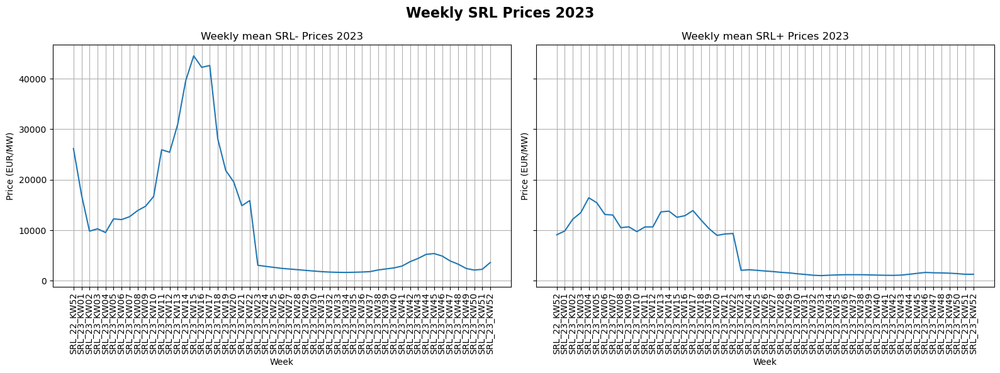

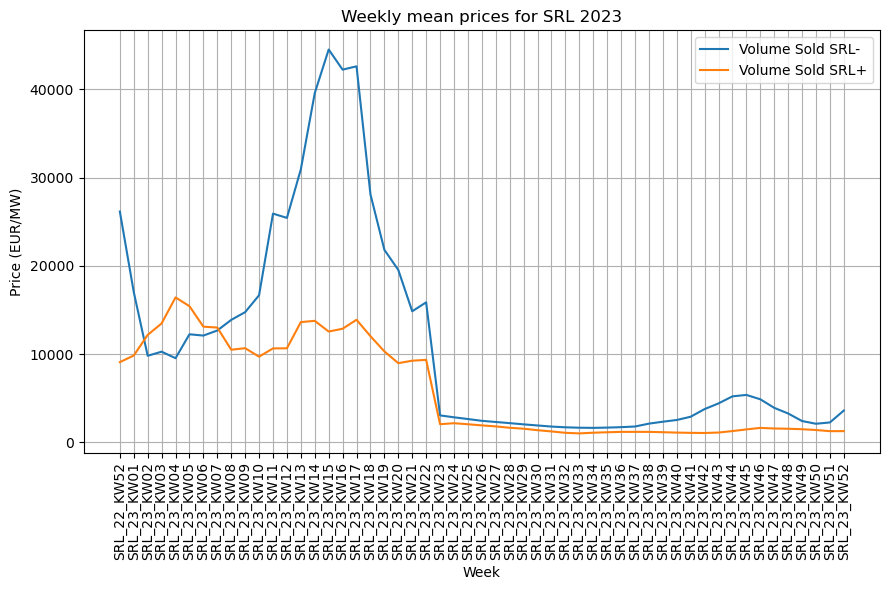

desription of SRL- prices:
 count       53.000000
mean     11118.847874
std      12144.851575
min       1645.713333
25%       2313.259259
50%       4417.619412
75%      15869.388372
max      44518.745227
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count       53.000000
mean      5920.096551
std       5384.289179
min       1018.852500
25%       1273.620000
50%       1927.644444
75%      10661.565714
max      16427.243846
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL23m.index, grouped_SRL23m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2023')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL23p.index, grouped_SRL23p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2023')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2023', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL23m.index, grouped_SRL23m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL23p.index, grouped_SRL23p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2023')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL23m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL23p["Prix_prestation"].describe()}')

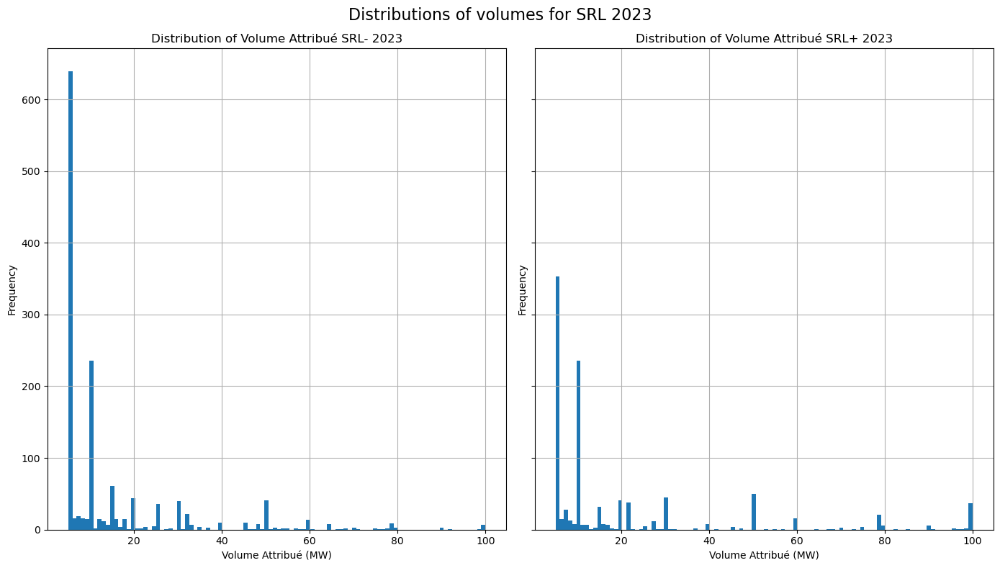

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL23m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2023')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL23p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2023')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of volumes for SRL 2023', fontsize=16)
plt.tight_layout()
plt.show()

### plotting results

max_volume=507, min volume= 399
max_cost=16399488.95, min cost= 436225.72


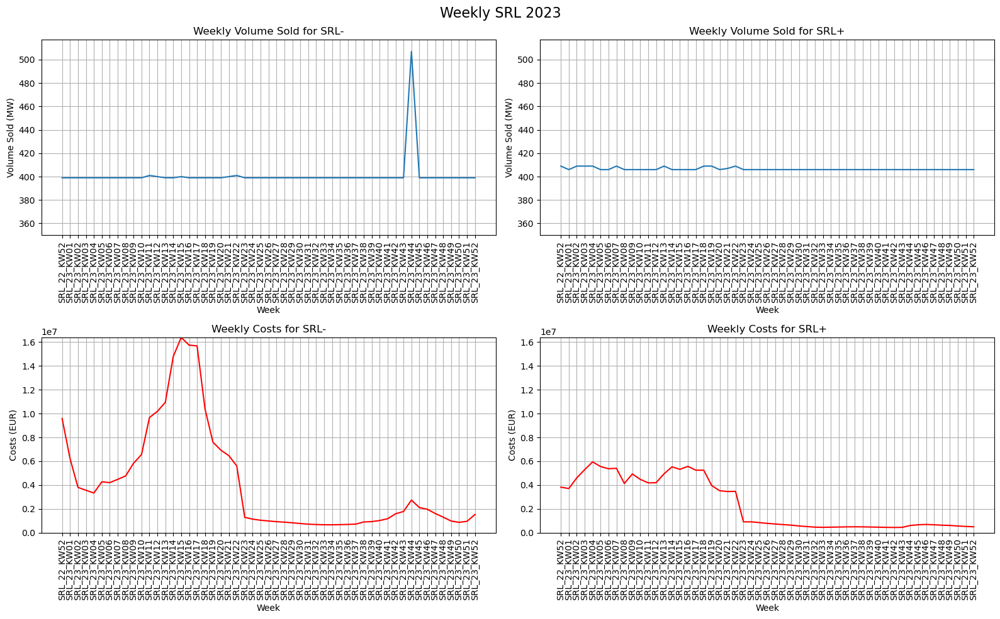

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL23])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL23])
min_cost = min([data['Coûts'].min() for data in grouped_SRL23])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL23m.index, grouped_SRL23m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL23p.index, grouped_SRL23p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL23m.index, grouped_SRL23m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL23p.index, grouped_SRL23p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2023', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2023

In [ ]:
# Create DataFrame for Tertiary control
res23_CH_t = res23_CH[res23_CH['Description'].str.contains('Tertiary Power')].copy()

print(res23_CH_t['Description'].unique())

['Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


In [ ]:
res23_CH_t

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
527787,TRL-_22_KW52,Tertiary Power DOWN,5,MW,5,MW,7971.00,CHF/MW,39855.00,CHF,47.45,CHF/MWh*,CH,47.45,CHF/MWh*,NaN
527788,TRL-_22_KW52,Tertiary Power DOWN,5,MW,0,MW,23456.00,CHF/MW,0.00,CHF,139.62,CHF/MWh*,CH,139.62,CHF/MWh*,NaN
527789,TRL-_22_KW52,Tertiary Power DOWN,8,MW,8,MW,3874.00,CHF/MW,30992.00,CHF,23.06,CHF/MWh*,CH,23.06,CHF/MWh*,NaN
527790,TRL-_22_KW52,Tertiary Power DOWN,65,MW,64,MW,7778.40,CHF/MW,497817.60,CHF,46.30,CHF/MWh*,CH,46.30,CHF/MWh*,NaN
527791,TRL-_22_KW52,Tertiary Power DOWN,28,MW,28,MW,3837.00,CHF/MW,107436.00,CHF,22.84,CHF/MWh*,CH,22.84,CHF/MWh*,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577553,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577554,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577555,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577556,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN


In [ ]:
TPDW23=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW23=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP'].copy()

TPD23_00_04=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD23_04_08=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD23_08_12=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD23_12_16=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD23_16_20=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD23_20_24=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU23_00_04=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU23_04_08=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU23_08_12=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU23_12_16=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU23_16_20=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU23_20_24=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()


TPDW23['Week']=TPDW23['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW23['Week']=TPUW23['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]


grouped_TPDW23=TPDW23.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPUW23=TPUW23.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})


TPD23_00_04['date'] = pd.to_datetime(TPD23_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_04_08['date'] = pd.to_datetime(TPD23_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_08_12['date'] = pd.to_datetime(TPD23_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_12_16['date'] = pd.to_datetime(TPD23_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_16_20['date'] = pd.to_datetime(TPD23_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_20_24['date'] = pd.to_datetime(TPD23_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU23_00_04['date'] = pd.to_datetime(TPU23_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_04_08['date'] = pd.to_datetime(TPU23_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_08_12['date'] = pd.to_datetime(TPU23_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_12_16['date'] = pd.to_datetime(TPU23_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_16_20['date'] = pd.to_datetime(TPU23_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_20_24['date'] = pd.to_datetime(TPU23_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')


grouped_TPD23_00_04=TPD23_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_04_08=TPD23_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_08_12=TPD23_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_12_16=TPD23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_16_20=TPD23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_20_24=TPD23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_TPU23_00_04=TPU23_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_04_08=TPU23_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_08_12=TPU23_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_12_16=TPU23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_16_20=TPU23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_20_24=TPU23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

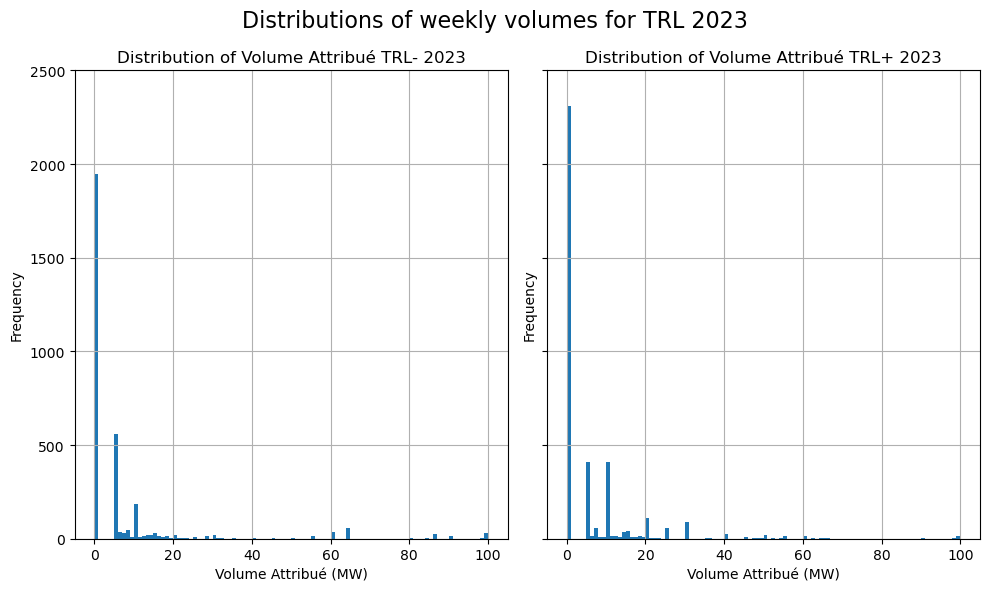

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW23['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2023')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW23['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2023')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of weekly volumes for TRL 2023', fontsize=16)
plt.tight_layout()
plt.show()


In [ ]:
# Grouped data list and labels
grouped_TPD23 = [grouped_TPD23_00_04, grouped_TPD23_04_08, grouped_TPD23_08_12, grouped_TPD23_12_16, grouped_TPD23_16_20, grouped_TPD23_20_24]

grouped_TPU23 = [grouped_TPU23_00_04, grouped_TPU23_04_08, grouped_TPU23_08_12, grouped_TPU23_12_16, grouped_TPU23_16_20, grouped_TPU23_20_24]

grouped_TPW23=[grouped_TPDW23, grouped_TPUW23]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

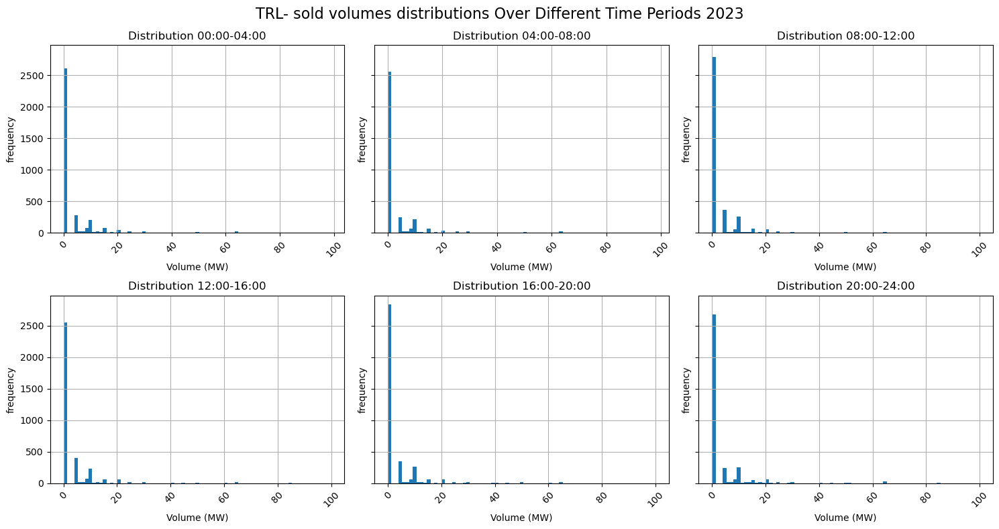

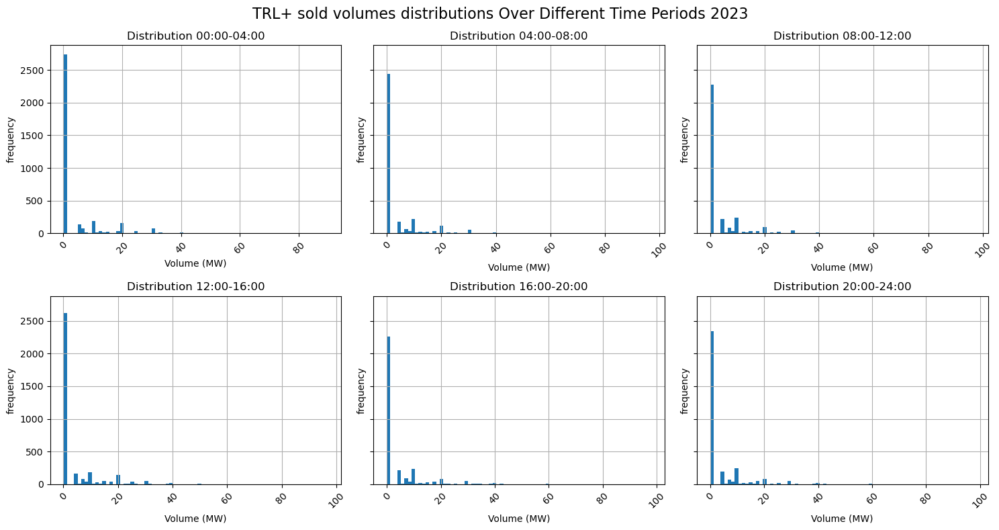

In [ ]:
list_TPD23 = [TPD23_00_04, TPD23_04_08, TPD23_08_12, TPD23_12_16, TPD23_16_20, TPD23_20_24]

list_TPU23 = [TPU23_00_04, TPU23_04_08, TPU23_08_12, TPU23_12_16, TPU23_16_20, TPU23_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=219
max_cost=47295.2


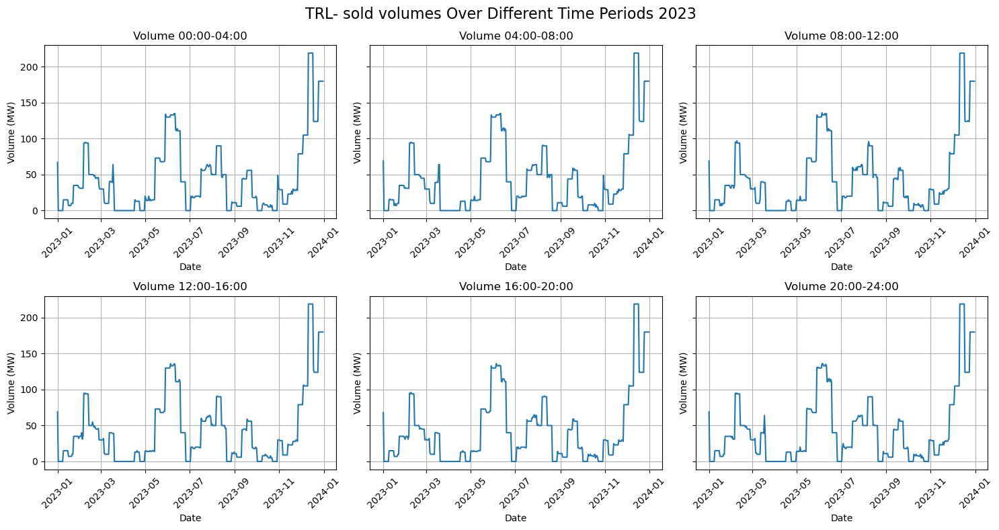

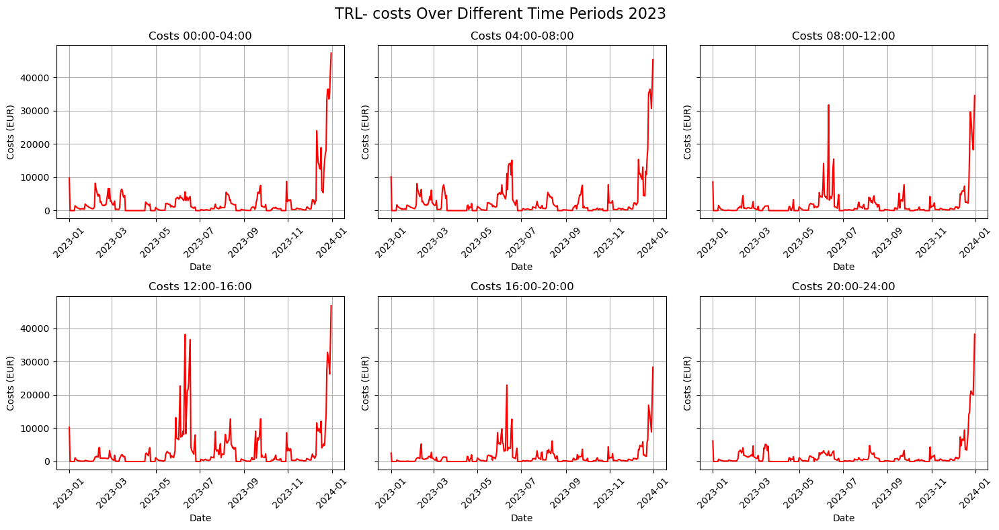

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


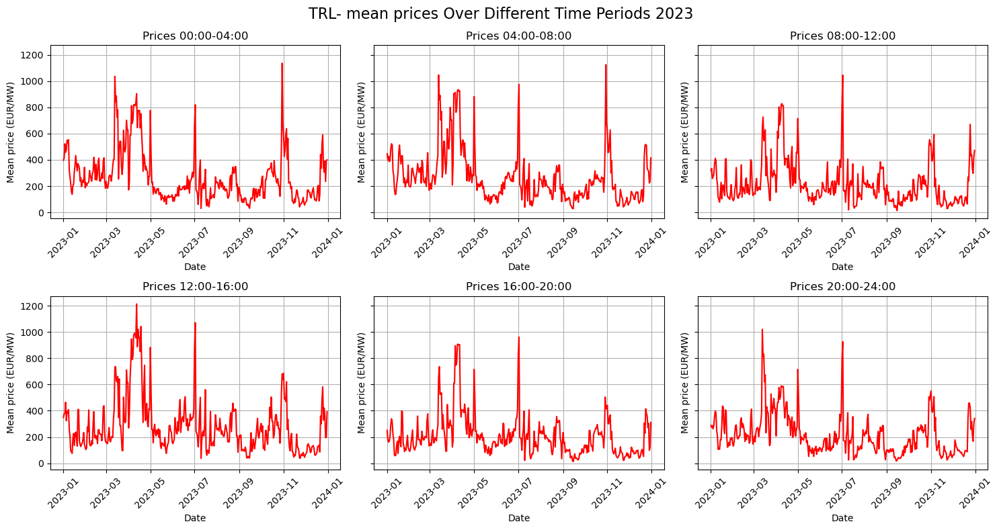

count     365.000000
mean      271.713491
std       192.789471
min        30.650000
25%       135.238750
50%       221.585333
75%       335.500000
max      1136.000000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      272.791366
std       196.902016
min        28.671429
25%       138.008571
50%       226.914545
75%       330.245000
max      1125.200000
Name: Prix_prestation, dtype: float64

count     365.000000
mean      221.334885
std       162.651719
min        13.796364
25%       114.454000
50%       177.850000
75%       274.333333
max      1045.833333
Name: Prix_prestation, dtype: float64

count     365.000000
mean      286.244675
std       210.144124
min        37.666667
25%       143.941250
50%       233.618182
75%       348.051111
max      1213.250000
Name: Prix_prestation, dtype: float64

count    365.000000
mean     208.427065
std      159.345387
min       13.642000
25%      100.700000
50%      177.498462
75%      251.444444
max      960.833333
Name: Prix_p

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPD23:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=118
max_cost=6743.95


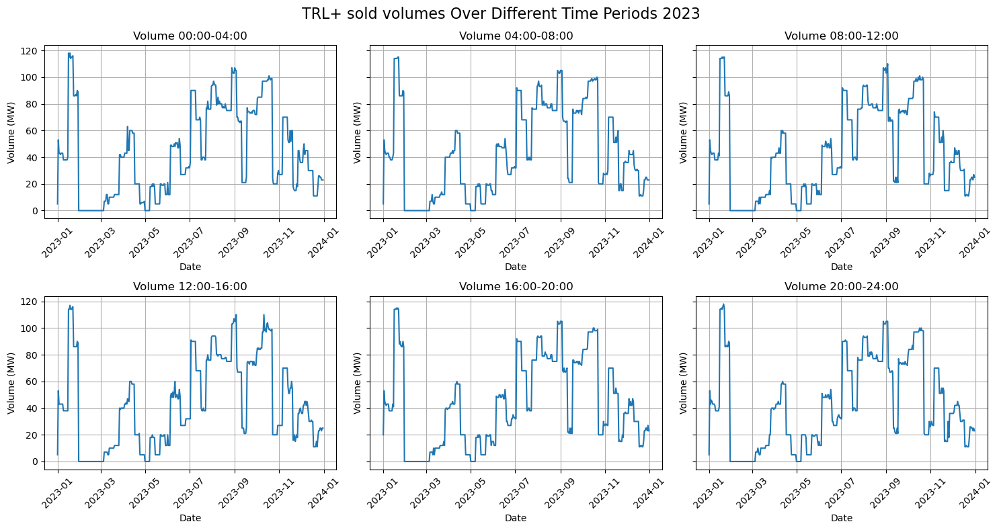

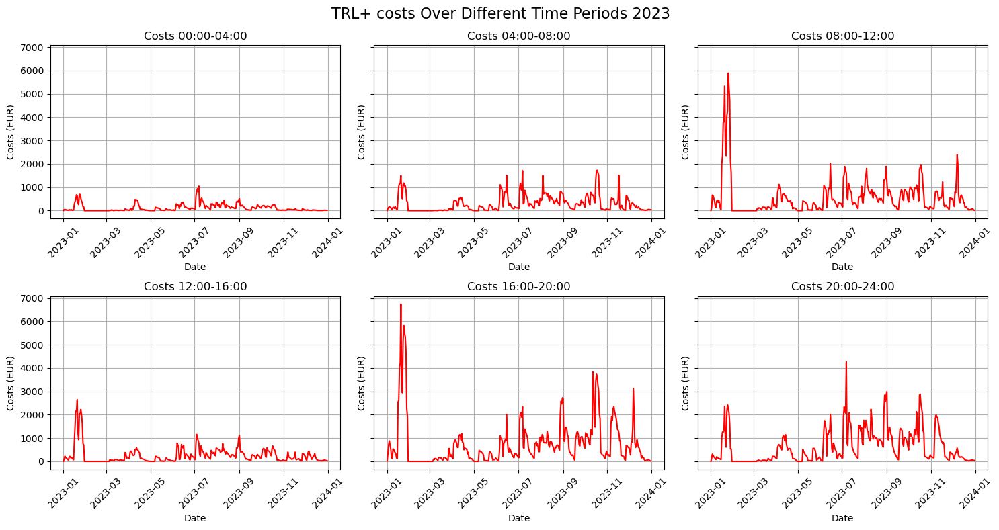

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


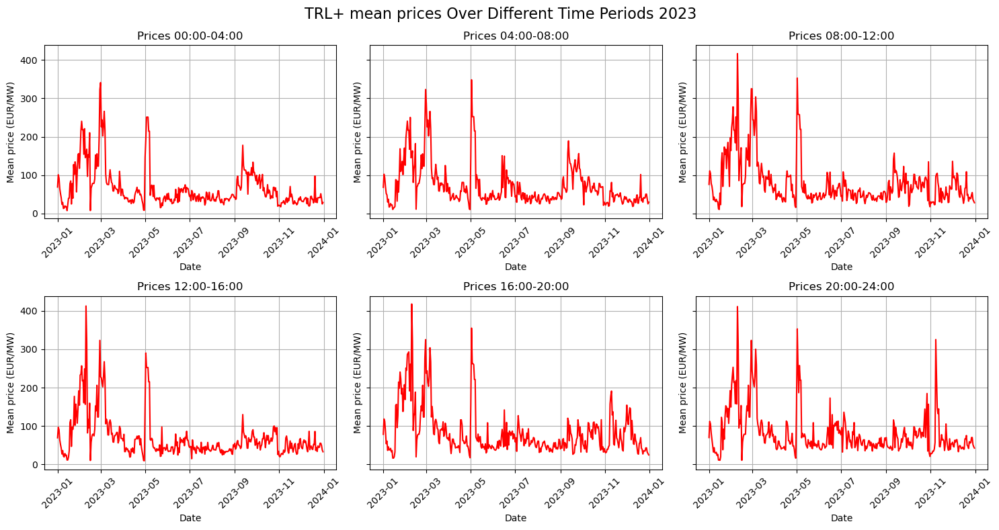

count    365.000000
mean      66.746037
std       53.225617
min        7.628750
25%       35.726000
50%       46.489231
75%       75.796667
max      341.000000
Name: Prix_prestation, dtype: float64

count    365.000000
mean      72.714596
std       55.097128
min       10.425455
25%       37.820000
50%       53.611818
75%       87.234000
max      348.236000
Name: Prix_prestation, dtype: float64

count    365.000000
mean      79.971350
std       60.726808
min       10.542857
25%       42.226667
50%       60.852308
75%       94.723333
max      416.400000
Name: Prix_prestation, dtype: float64

count    365.000000
mean      69.543255
std       56.834173
min        9.490909
25%       37.677273
50%       51.546667
75%       74.636923
max      412.533333
Name: Prix_prestation, dtype: float64

count    365.000000
mean      85.403032
std       63.342356
min       16.323077
25%       45.184444
50%       64.440000
75%       98.277143
max      417.733333
Name: Prix_prestation, dtype: float64

count

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPU23:
    print(f'{group["Prix_prestation"].describe()}\n')

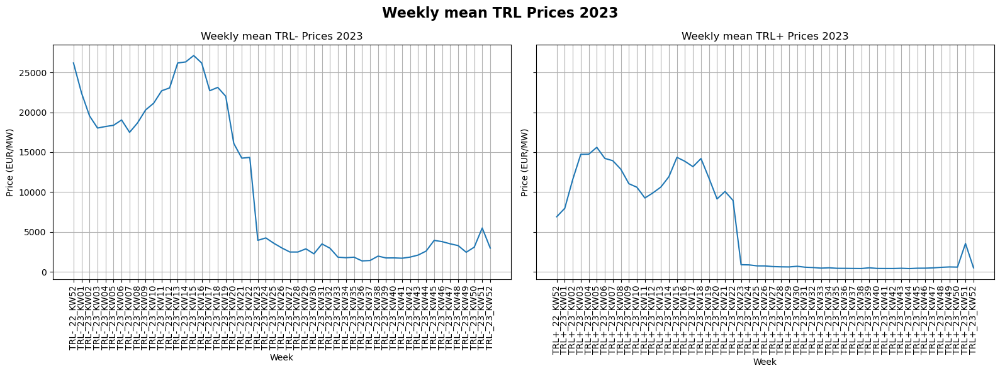

desription of TRL- prices:
 count       53.000000
mean     10664.284439
std       9525.928096
min       1359.320000
25%       2474.542857
50%       3934.873043
75%      19556.306105
max      27130.690843
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count       53.000000
mean      5481.845633
std       5823.458463
min        392.663333
25%        496.203810
50%        736.962264
75%      11047.347228
max      15611.832273
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW23.index, grouped_TPDW23['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2023')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW23.index, grouped_TPUW23['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2023')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2023', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW23["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW23["Prix_prestation"].describe()}')

max_volume=508
max_cost=4474750.6


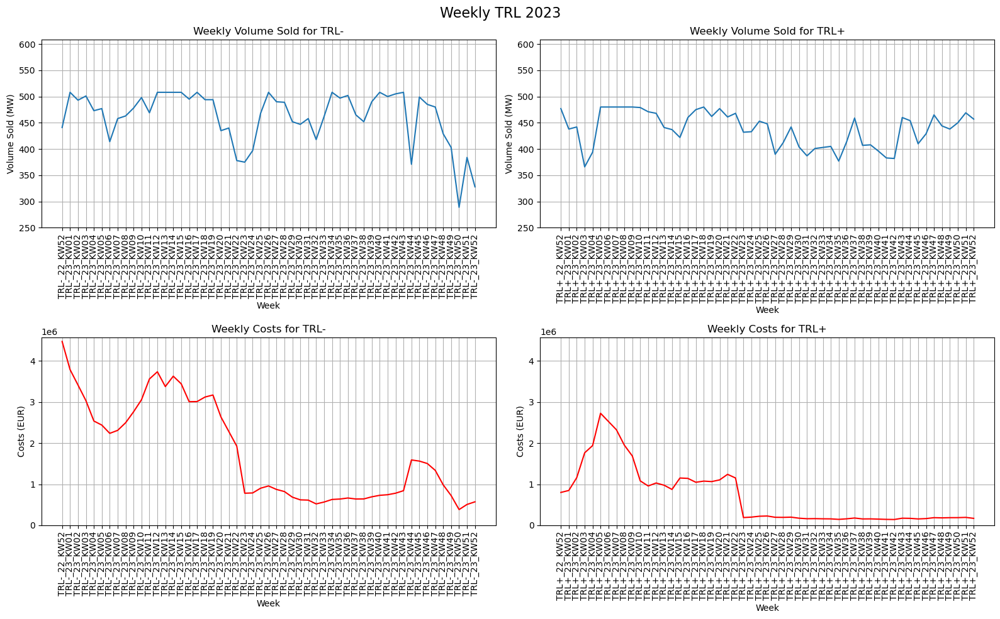

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW23.index, grouped_TPDW23['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW23.index, grouped_TPUW23['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW23.index, grouped_TPDW23['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW23.index, grouped_TPUW23['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2023', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2024

In [ ]:
res24=pd.read_csv('https://www.swissgrid.ch/content/dam/dataimport/prl-srl/2024-PRL-SRL-TRL-Ergebnis.csv',sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'] )
res24_CH=res24[res24.Pays=='CH']
print(res24_CH.Description.unique())
res24_CH

['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\299254801.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res24=pd.read_csv('https://www.swissgrid.ch/content/dam/dataimport/prl-srl/2024-PRL-SRL-TRL-Ergebnis.csv',sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'] )


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,10.00,EUR/MW,10.00,EUR,28.7,EUR/MWh*,CH,2.50,EUR/MWh*,Ja
1,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,96.00,EUR/MW,288.00,EUR,28.7,EUR/MWh*,CH,24.00,EUR/MWh*,Ja
2,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,3.96,EUR/MW,7.92,EUR,28.7,EUR/MWh*,CH,0.99,EUR/MWh*,Ja
3,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,105.00,EUR/MW,315.00,EUR,28.7,EUR/MWh*,CH,26.25,EUR/MWh*,Ja
4,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,102.00,EUR/MW,306.00,EUR,28.7,EUR/MWh*,CH,25.50,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
531023,TRL+_24_10_22,Tertiary Power UP 04:00 bis 08:00,30,MW,0,MW,2000.00,CHF/MW,0.00,CHF,500.0,CHF/MWh*,CH,500.00,CHF/MWh*,NaN
531024,TRL+_24_10_22,Tertiary Power UP 08:00 bis 12:00,30,MW,0,MW,2000.00,CHF/MW,0.00,CHF,500.0,CHF/MWh*,CH,500.00,CHF/MWh*,NaN
531025,TRL+_24_10_22,Tertiary Power UP 12:00 bis 16:00,30,MW,0,MW,2000.00,CHF/MW,0.00,CHF,500.0,CHF/MWh*,CH,500.00,CHF/MWh*,NaN
531026,TRL+_24_10_22,Tertiary Power UP 16:00 bis 20:00,30,MW,0,MW,2000.00,CHF/MW,0.00,CHF,500.0,CHF/MWh*,CH,500.00,CHF/MWh*,NaN


## primary control auction 2024

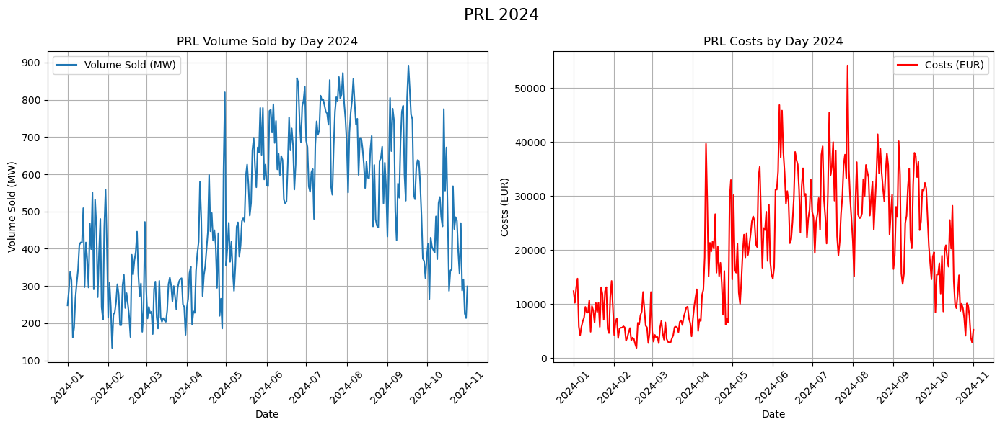

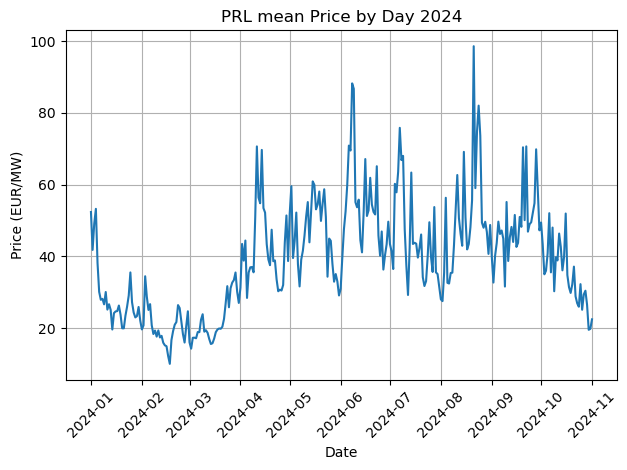

desription of PRL prices:
 count    306.000000
mean      39.378675
std       15.389537
min       10.063704
25%       26.953454
50%       38.844444
75%       49.667067
max       98.559898
Name: Prix_prestation, dtype: float64



In [ ]:
res24_CH_p=res24_CH[res24_CH['Description'].str.contains('Primary control')].copy()

res24_CH_p['date'] = pd.to_datetime(res24_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p24 = res24_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p24.index, grouped_p24['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2024')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p24.index, grouped_p24['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2024')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2024', fontsize=16)
plt.tight_layout()
plt.show()


plt.plot(grouped_p24.index, grouped_p24['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2024')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print(f'desription of PRL prices:\n {grouped_p24["Prix_prestation"].describe()}\n')



In [ ]:
PRL24_0_4=res24_CH_p[res24_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL24_4_8=res24_CH_p[res24_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL24_8_12=res24_CH_p[res24_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL24_12_16=res24_CH_p[res24_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL24_16_20=res24_CH_p[res24_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL24_20_24=res24_CH_p[res24_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL24_0_4=PRL24_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_4_8=PRL24_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_8_12=PRL24_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_12_16=PRL24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_16_20=PRL24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_20_24=PRL24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})



max_volume=167, min volume= 19
max_cost=23335.579999999998, min cost= 133.72


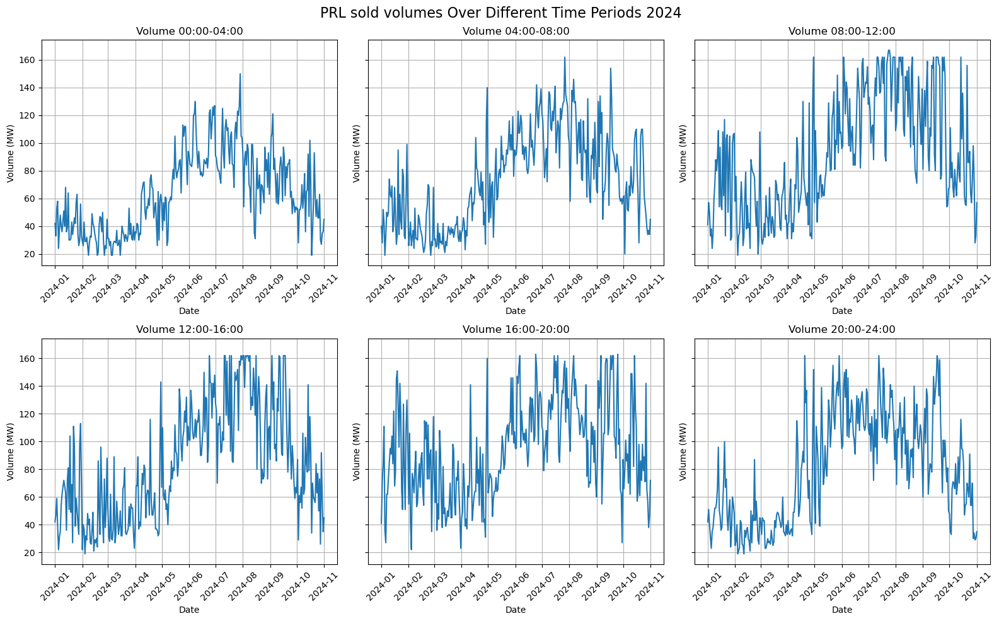

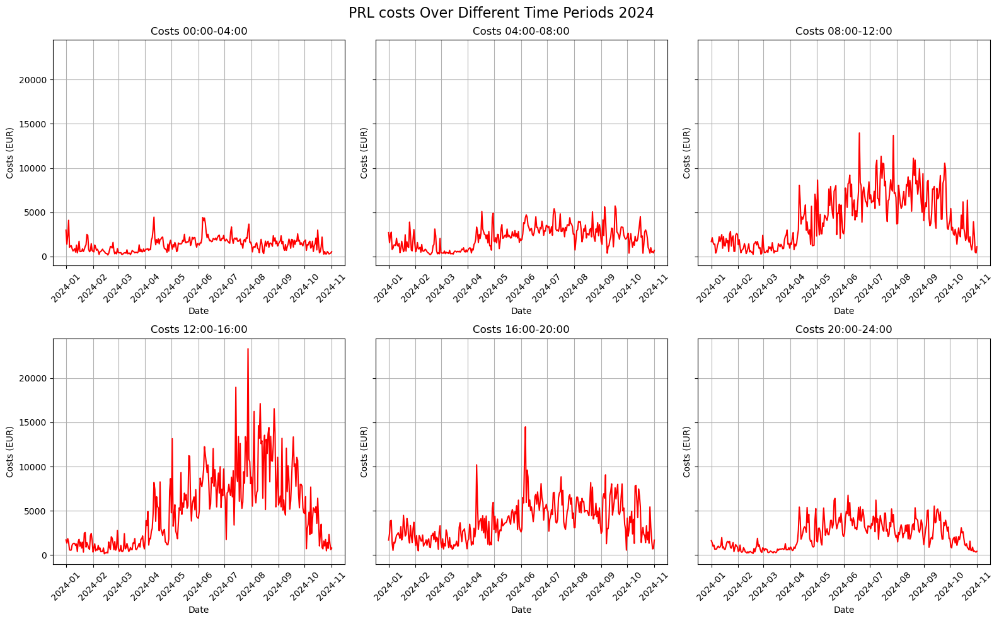

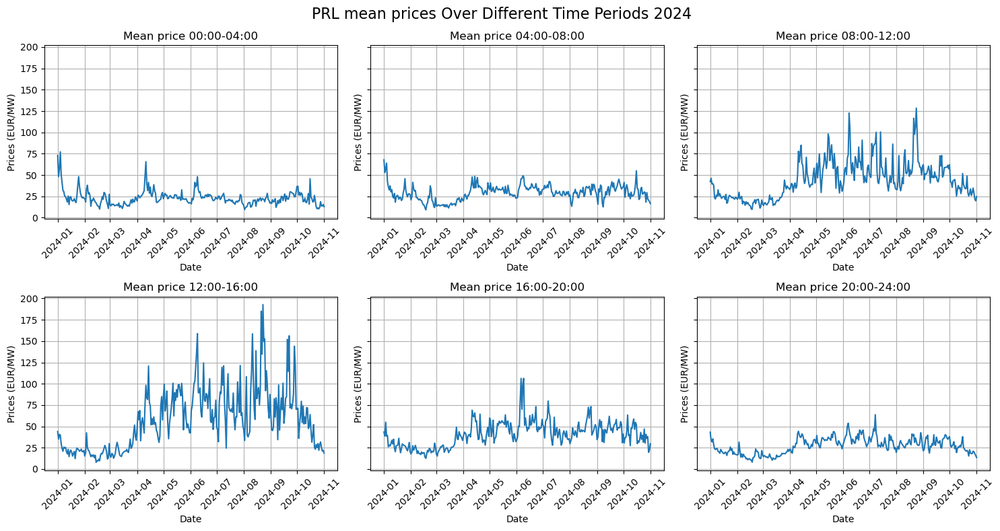

count    306.000000
mean      23.156273
std        8.812674
min        9.478571
25%       18.092227
50%       22.013333
75%       26.102828
max       77.177073
Name: Prix_prestation, dtype: float64
count    306.000000
mean      29.315907
std        9.038536
min        9.245000
25%       23.615387
50%       29.630000
75%       34.916231
max       67.758889
Name: Prix_prestation, dtype: float64
count    306.000000
mean      44.630339
std       21.822069
min        9.773333
25%       26.165664
50%       41.524014
75%       58.425683
max      128.484375
Name: Prix_prestation, dtype: float64
count    306.000000
mean      58.019375
std       35.306545
min        7.845000
25%       25.202381
50%       54.029688
75%       80.964726
max      192.818182
Name: Prix_prestation, dtype: float64
count    306.000000
mean      40.914622
std       14.965864
min       12.553333
25%       29.622837
50%       40.281126
75%       49.727956
max      106.266667
Name: Prix_prestation, dtype: float64
count    3

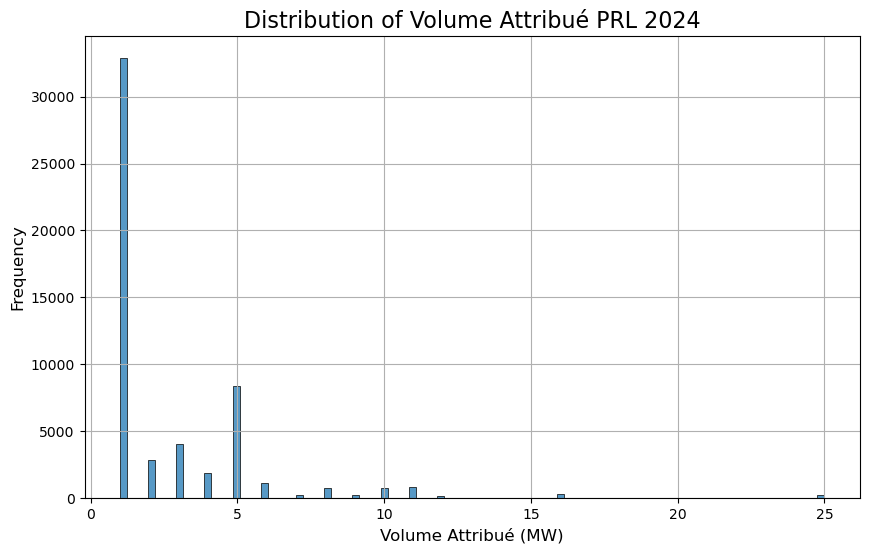

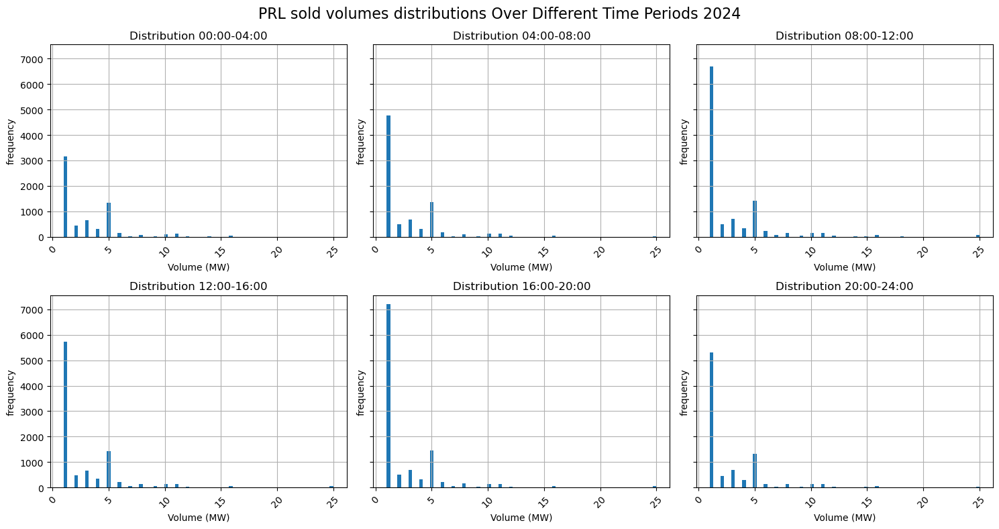

In [ ]:
# Grouped data list and labels
grouped_p24 = [grouped_PRL24_0_4, grouped_PRL24_4_8, grouped_PRL24_8_12, grouped_PRL24_12_16, grouped_PRL24_16_20, grouped_PRL24_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p24])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p24])
min_cost = min([data['Coûts'].min() for data in grouped_p24])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()




fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

for group in grouped_p24:
    print(group['Prix_prestation'].describe())
    
    
    
    
plt.figure(figsize=(10, 6))
sns.histplot(res24_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2024', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.show()




list_PRL24 = [PRL24_0_4, PRL24_4_8, PRL24_8_12, PRL24_12_16, PRL24_16_20, PRL24_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()




## Secondary control auction 2024

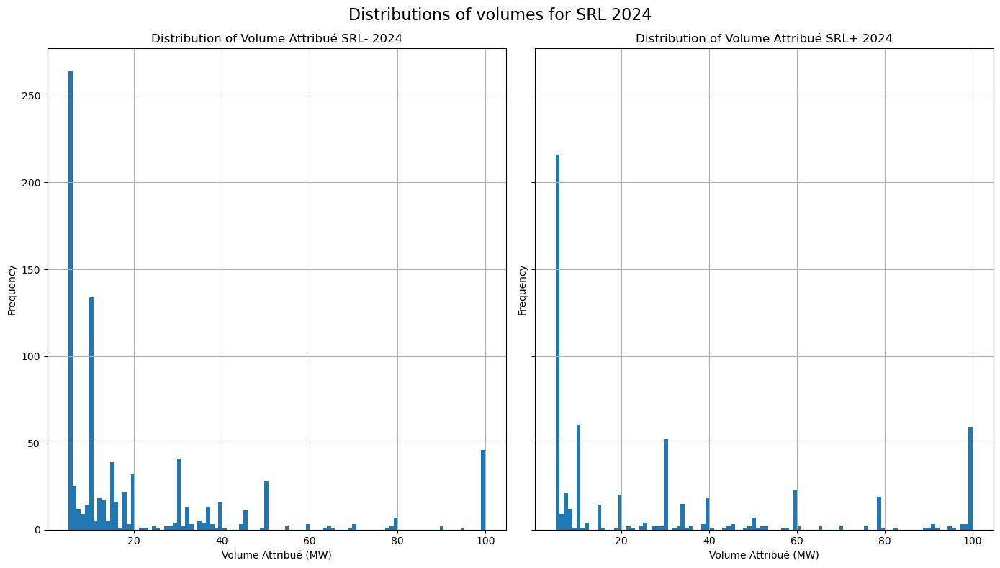

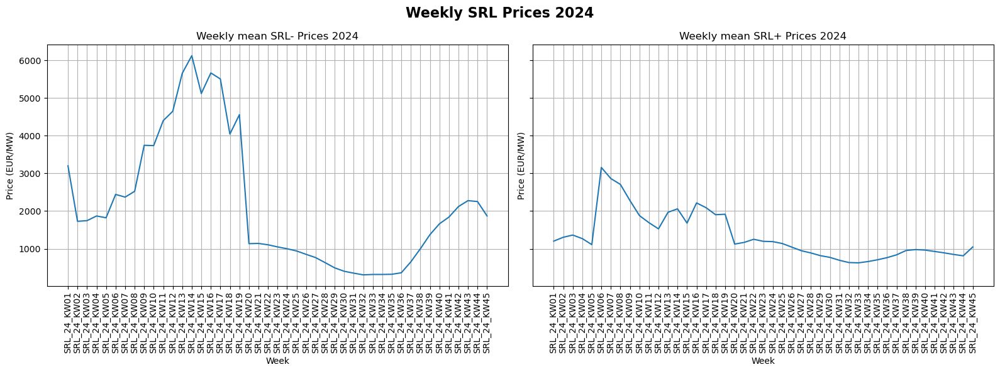

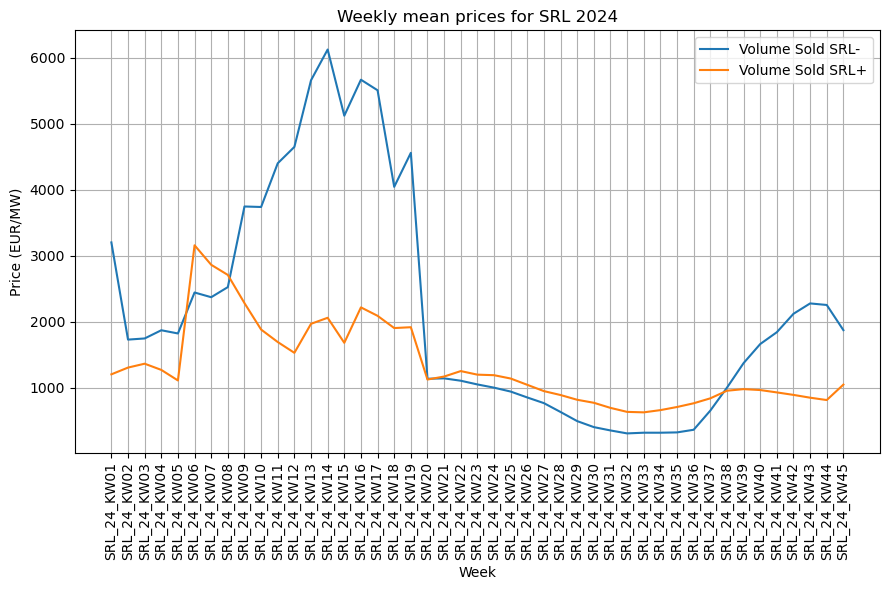

desription of SRL- prices:
 count      45.000000
mean     2166.257957
std      1729.062022
min       307.684444
25%       852.070556
50%      1746.367778
75%      3201.610909
max      6124.475200
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      45.000000
mean     1335.477109
std       628.809045
min       626.698000
25%       888.977500
50%      1139.225000
75%      1692.165263
max      3158.179000
Name: Prix_prestation, dtype: float64
max_volume=408, min volume= 399
max_cost=2239401.08, min cost= 129124.28


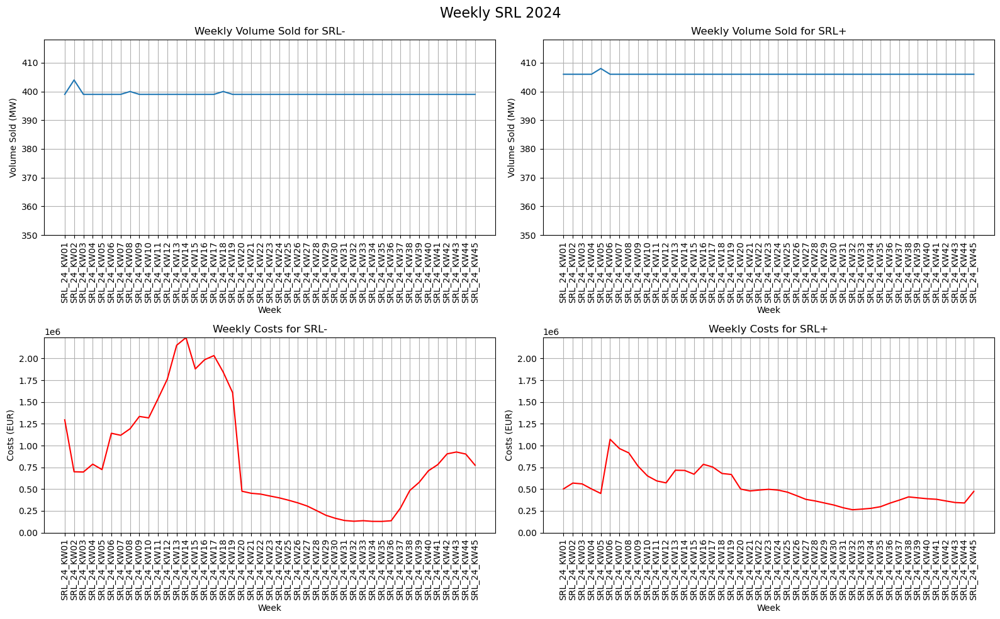

In [ ]:
# Create DataFrame for Secondary control
res24_CH_s = res24_CH[res24_CH['Description'].str.contains('Secondary control')].copy()

res24_CH_s['Week'] = res24_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL24m=res24_CH_s[res24_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL24p=res24_CH_s[res24_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL24m=SRL24m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL24p=SRL24p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL24=[grouped_SRL24m, grouped_SRL24p]



fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL24m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2024')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL24p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2024')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2024', fontsize=16)
plt.tight_layout()
plt.show()


fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL24m.index, grouped_SRL24m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2024')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL24p.index, grouped_SRL24p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2024')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2024', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL24m.index, grouped_SRL24m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL24p.index, grouped_SRL24p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2024')
plt.xlabel('Week')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL24m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL24p["Prix_prestation"].describe()}')



# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL24])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL24])
min_cost = min([data['Coûts'].min() for data in grouped_SRL24])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL24m.index, grouped_SRL24m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL24p.index, grouped_SRL24p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL24m.index, grouped_SRL24m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL24p.index, grouped_SRL24p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2024', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2024

In [ ]:
# Create DataFrame for Tertiary control
res24_CH_t = res24_CH[res24_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW24=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW24=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP'].copy()
TPD24_00_04=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD24_04_08=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD24_08_12=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD24_12_16=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD24_16_20=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD24_20_24=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU24_00_04=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU24_04_08=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU24_08_12=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU24_12_16=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU24_16_20=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU24_20_24=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW24['Week']=TPDW24['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW24['Week']=TPUW24['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW24=TPDW24.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW24=TPUW24.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD24_00_04['date'] = pd.to_datetime(TPD24_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_04_08['date'] = pd.to_datetime(TPD24_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_08_12['date'] = pd.to_datetime(TPD24_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_12_16['date'] = pd.to_datetime(TPD24_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_16_20['date'] = pd.to_datetime(TPD24_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_20_24['date'] = pd.to_datetime(TPD24_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU24_00_04['date'] = pd.to_datetime(TPU24_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_04_08['date'] = pd.to_datetime(TPU24_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_08_12['date'] = pd.to_datetime(TPU24_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_12_16['date'] = pd.to_datetime(TPU24_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_16_20['date'] = pd.to_datetime(TPU24_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_20_24['date'] = pd.to_datetime(TPU24_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD24_00_04=TPD24_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_04_08=TPD24_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_08_12=TPD24_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_12_16=TPD24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_16_20=TPD24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_20_24=TPD24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU24_00_04=TPU24_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_04_08=TPU24_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_08_12=TPU24_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_12_16=TPU24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_16_20=TPU24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_20_24=TPU24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD24 = [grouped_TPD24_00_04, grouped_TPD24_04_08, grouped_TPD24_08_12, grouped_TPD24_12_16, grouped_TPD24_16_20, grouped_TPD24_20_24]

grouped_TPU24 = [grouped_TPU24_00_04, grouped_TPU24_04_08, grouped_TPU24_08_12, grouped_TPU24_12_16, grouped_TPU24_16_20, grouped_TPU24_20_24]

grouped_TPW24=[grouped_TPDW24, grouped_TPUW24]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

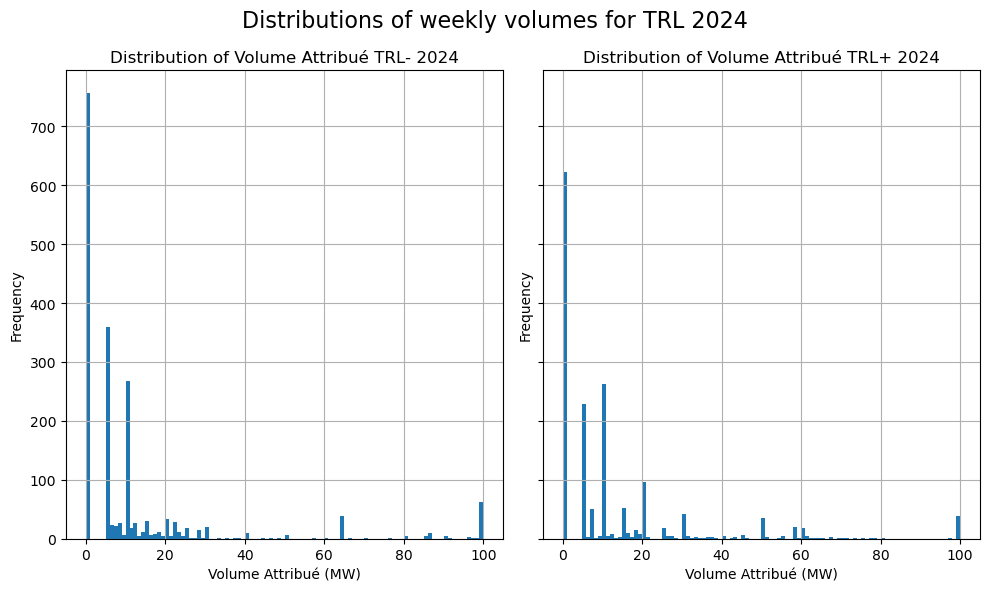

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW24['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2024')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW24['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2024')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2024', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
TPD24_08_12

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,date
521695,TRL-_24_01_01,Tertiary Power DOWN 08:00 bis 12:00,5,MW,0,MW,290.0,CHF/MW,0.0,CHF,72.5,CHF/MWh*,CH,72.5,CHF/MWh*,NaN,2024-01-01
521696,TRL-_24_01_01,Tertiary Power DOWN 08:00 bis 12:00,100,MW,0,MW,1220.0,CHF/MW,0.0,CHF,305.0,CHF/MWh*,CH,305.0,CHF/MWh*,NaN,2024-01-01
521697,TRL-_24_01_01,Tertiary Power DOWN 08:00 bis 12:00,5,MW,0,MW,550.0,CHF/MW,0.0,CHF,137.5,CHF/MWh*,CH,137.5,CHF/MWh*,NaN,2024-01-01
521698,TRL-_24_01_01,Tertiary Power DOWN 08:00 bis 12:00,60,MW,0,MW,2088.0,CHF/MW,0.0,CHF,522.0,CHF/MWh*,CH,522.0,CHF/MWh*,NaN,2024-01-01
521699,TRL-_24_01_01,Tertiary Power DOWN 08:00 bis 12:00,7,MW,0,MW,190.0,CHF/MW,0.0,CHF,47.5,CHF/MWh*,CH,47.5,CHF/MWh*,NaN,2024-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
525899,TRL-_24_10_19,Tertiary Power DOWN 08:00 bis 12:00,30,MW,0,MW,2000.0,CHF/MW,0.0,CHF,500.0,CHF/MWh*,CH,500.0,CHF/MWh*,NaN,2024-10-19
525910,TRL-_24_10_20,Tertiary Power DOWN 08:00 bis 12:00,25,MW,0,MW,2000.0,CHF/MW,0.0,CHF,500.0,CHF/MWh*,CH,500.0,CHF/MWh*,NaN,2024-10-20
525911,TRL-_24_10_20,Tertiary Power DOWN 08:00 bis 12:00,30,MW,0,MW,2000.0,CHF/MW,0.0,CHF,500.0,CHF/MWh*,CH,500.0,CHF/MWh*,NaN,2024-10-20
525920,TRL-_24_10_21,Tertiary Power DOWN 08:00 bis 12:00,30,MW,0,MW,2000.0,CHF/MW,0.0,CHF,500.0,CHF/MWh*,CH,500.0,CHF/MWh*,NaN,2024-10-21


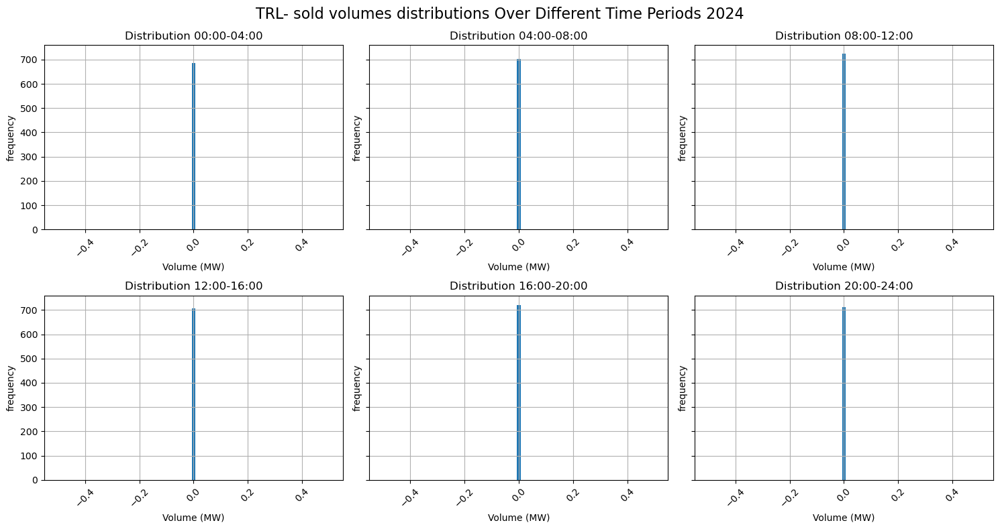

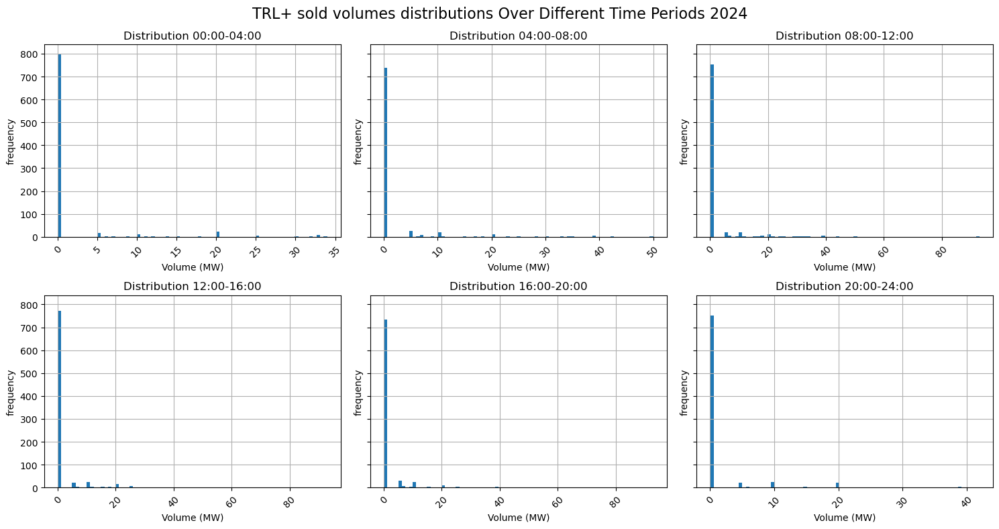

In [ ]:
list_TPD24 = [TPD24_00_04, TPD24_04_08, TPD24_08_12, TPD24_12_16, TPD24_16_20, TPD24_20_24]

list_TPU24 = [TPU24_00_04, TPU24_04_08, TPU24_08_12, TPU24_12_16, TPU24_16_20, TPU24_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=0
max_cost=0.0


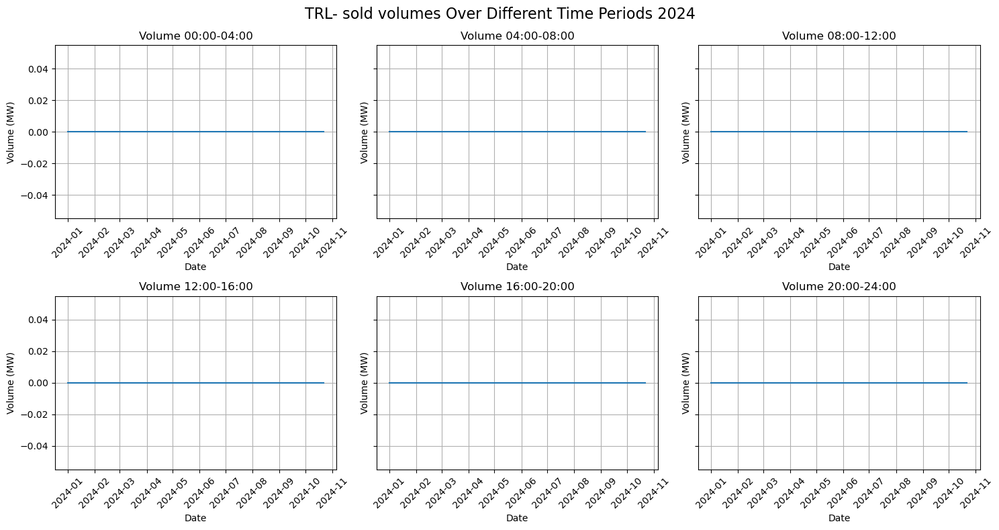

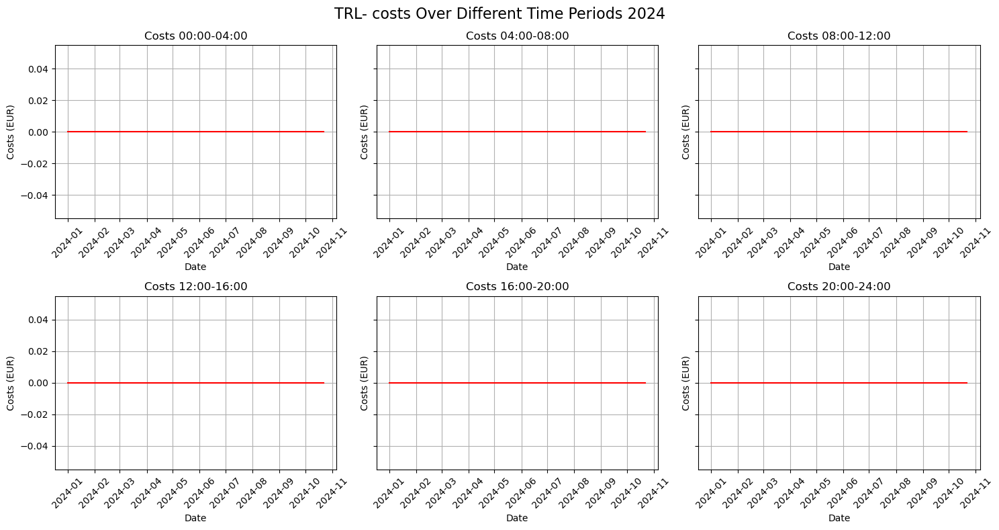

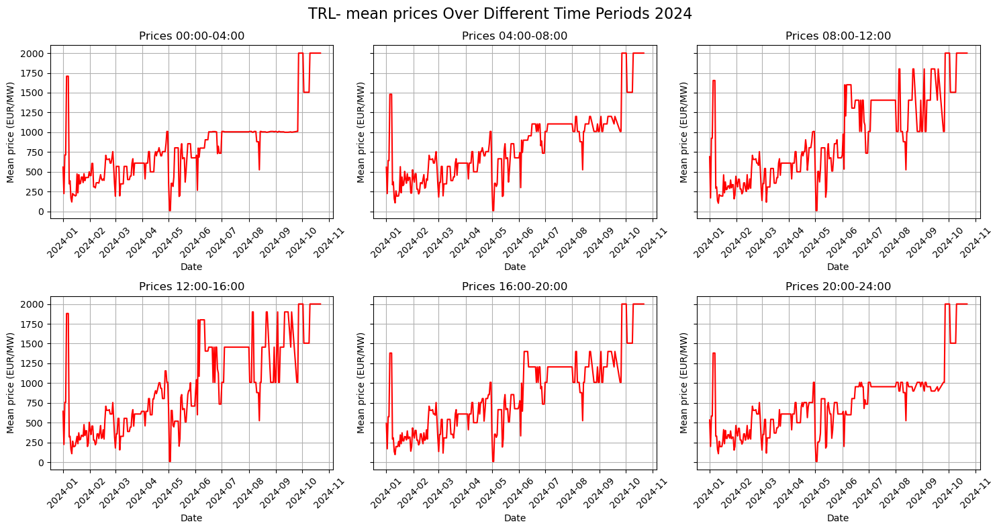

count     281.000000
mean      813.071650
std       419.764687
min        10.000000
25%       525.000000
50%       755.000000
75%      1005.000000
max      2000.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean      830.165956
std       436.851700
min        10.000000
25%       505.250000
50%       755.000000
75%      1105.000000
max      2000.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean      934.522938
std       529.884576
min        10.000000
25%       510.000000
50%       805.000000
75%      1405.000000
max      2000.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean      971.135527
std       546.406415
min        10.000000
25%       519.880000
50%       880.000000
75%      1455.000000
max      2000.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean      856.693742
std       474.567119
min        10.000000
25%       500.000000
50%       768.666667
75%      1205.000000
max      2000.000000
Name

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPD24:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=100
max_cost=10778.98


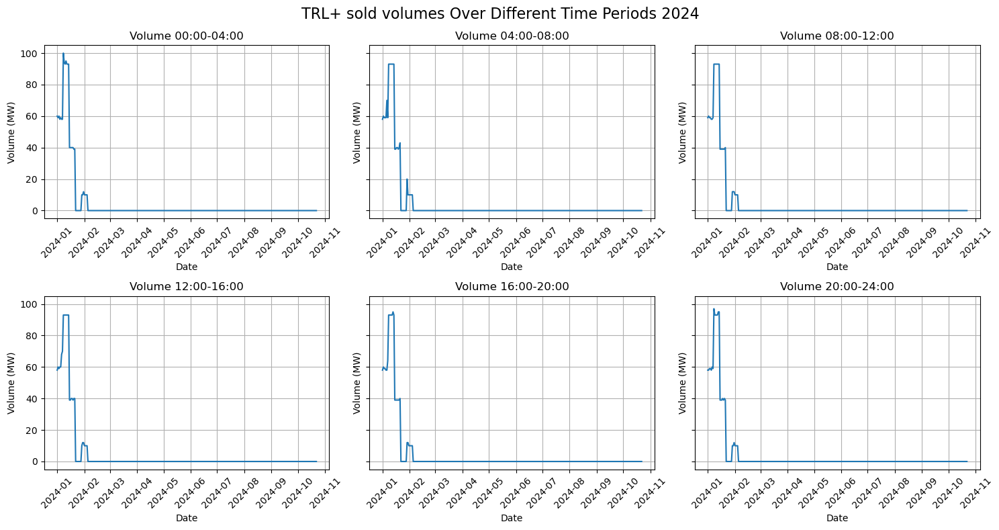

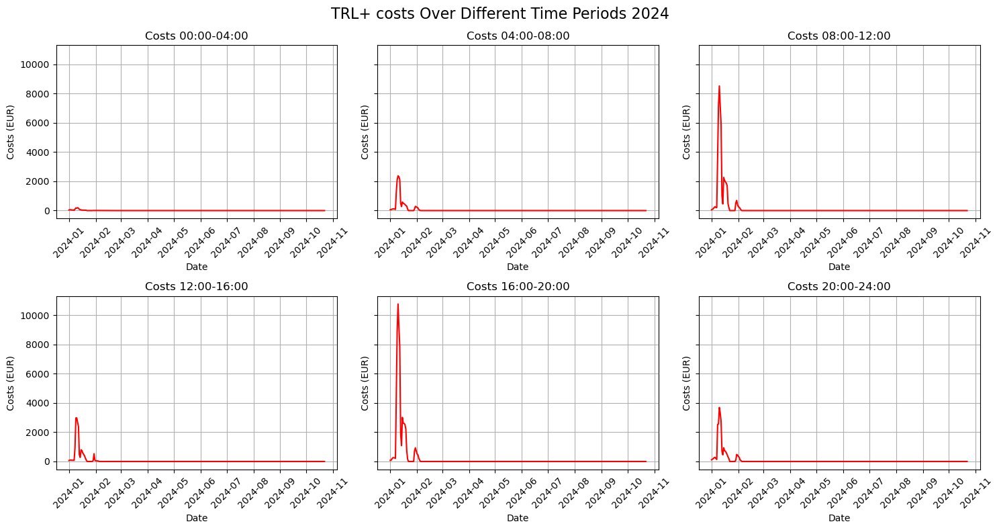

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

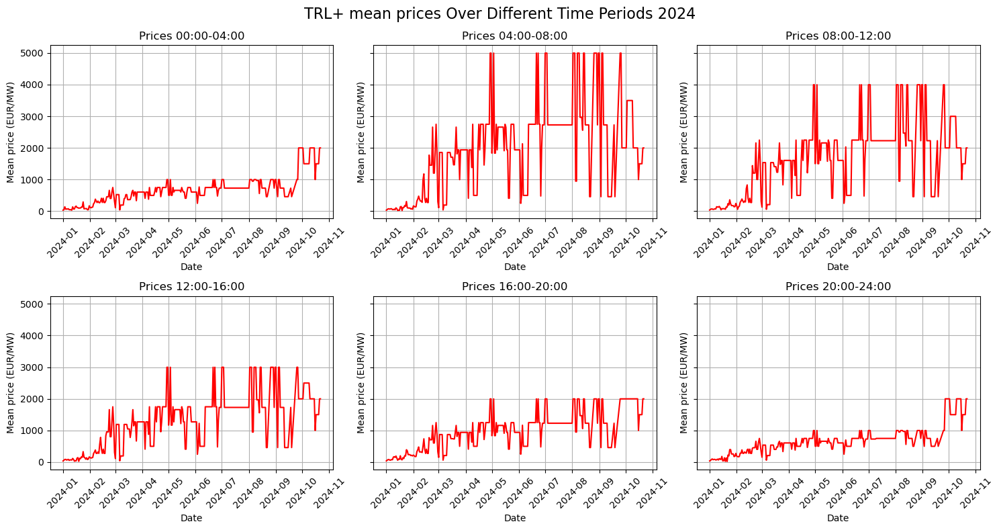

count     281.000000
mean      661.102972
std       416.607981
min        34.834706
25%       412.900000
50%       653.333333
75%       750.000000
max      2000.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean     1998.760717
std      1399.150228
min        21.948000
25%       500.000000
50%      1938.333333
75%      2727.500000
max      4995.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean     1669.363121
std      1110.655499
min        37.945455
25%       500.000000
50%      1605.333333
75%      2228.000000
max      3996.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean     1328.536606
std       841.764898
min        26.038182
25%       500.000000
50%      1272.333333
75%      1748.500000
max      2997.000000
Name: Prix_prestation, dtype: float64

count     281.000000
mean     1007.409904
std       579.633793
min        38.781818
25%       500.000000
50%       986.000000
75%      1249.000000
max      2000.000000
Name

In [ ]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

for group in grouped_TPU24:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=508
max_cost=1140292.0999999999


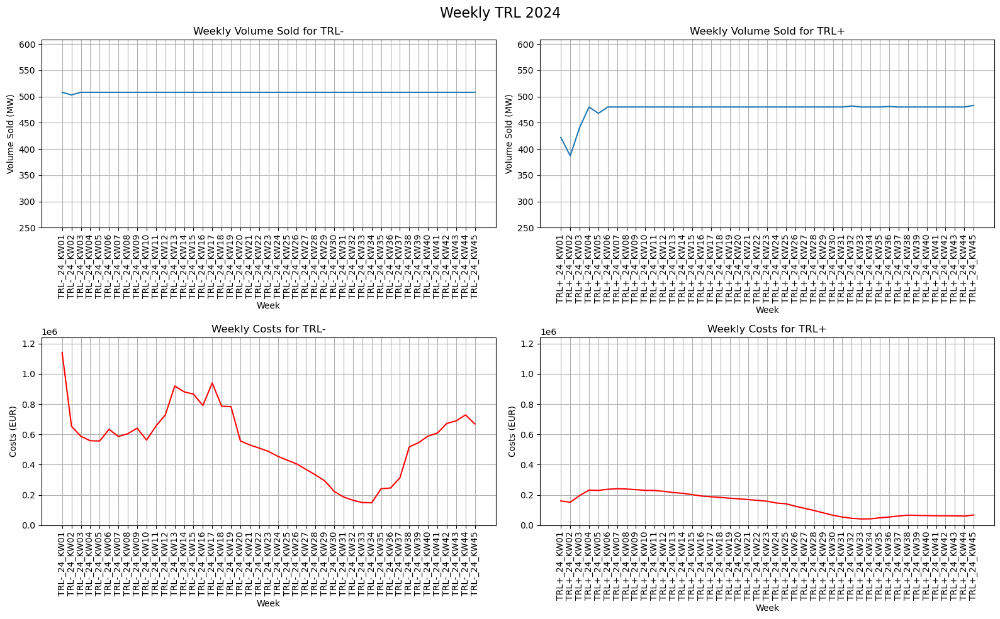

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW24.index, grouped_TPDW24['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW24.index, grouped_TPUW24['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW24.index, grouped_TPDW24['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW24.index, grouped_TPUW24['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2024', fontsize=16)
plt.tight_layout()
plt.show()

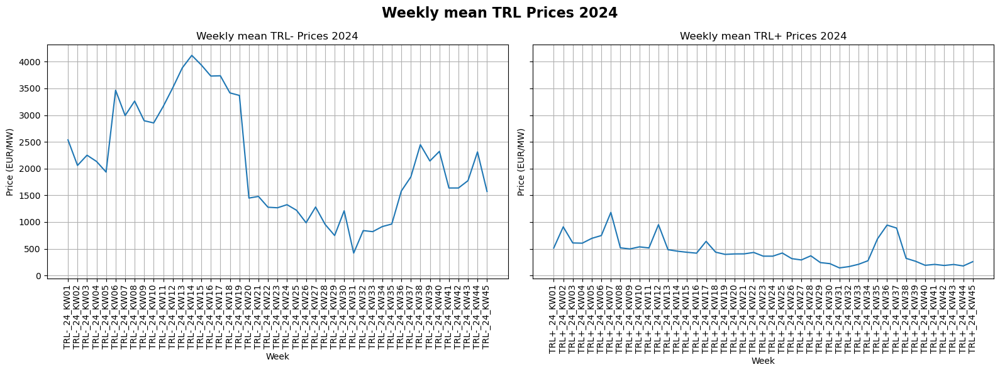

desription of TRL- prices:
 count      45.000000
mean     2126.028346
std      1037.511929
min       419.264000
25%      1277.045405
50%      1935.118519
75%      2992.185091
max      4117.844490
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      45.000000
mean      455.197165
std       242.666805
min       142.326585
25%       265.992821
50%       417.744815
75%       535.862400
max      1180.217222
Name: Prix_prestation, dtype: float64


In [ ]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW24.index, grouped_TPDW24['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2024')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (EUR/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW24.index, grouped_TPUW24['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2024')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (EUR/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2024', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW24["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW24["Prix_prestation"].describe()}')

# Grouped analysis

In [ ]:
SRL20m['Year'] = 2020
SRL21m['Year'] = 2021
SRL22m['Year'] = 2022
SRL23m['Year'] = 2023
SRL24m['Year'] = 2024

# Combine all datasets into a single DataFrame
combined_data = pd.concat([SRL20m, SRL21m, SRL22m, SRL23m, SRL24m])

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=combined_data)
plt.title('Prix_prestation Distribution by Year')
plt.xlabel('Year')
plt.ylabel('Prix_prestation (EUR/MW)')
plt.grid(axis='y')
plt.show()